In [26]:
import mediapipe as mp
import cv2
import os
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math
import seaborn as sns
from scipy.misc import derivative
from scipy.signal import find_peaks
from statistics import stdev,mean
from scipy.interpolate import interp1d
import itertools as itr
import statistics
import pprint, pickle
from scipy.stats import binom
from scipy import signal

In [52]:
cam='front'
vid_no=input("Please enter video number of the person:")
direction=input("Enter direction (front/back)")

In [53]:
name_list=['chathura','hasitha','yohan','ravindu','geemanthi','jayasanka','derek','nirmana','dasith','bimsara']
len(name_list)


31

In [55]:
def get_peaks(df,y,p):
    peak, _ = find_peaks(y,prominence=p)
    plt.figure(figsize=(20,5))
    #plt.xlim(0, 100)
    #plt.ylim(0, 60)
    plt.plot(df.t,y)
    plt.plot(df.t[peak], y[peak], "X",markerfacecolor='red',markersize=8)
    plt.show()
    return peak

def get_valleys(df,y,p):
    valley, _ = find_peaks(-y,prominence=p)
    plt.figure(figsize=(20,5))
    plt.plot(df.t,y)
    plt.plot(df.t[valley], y[valley],"X",markerfacecolor='red',markersize=8)
    plt.show()
    return valley

def remove_distinct_peaks(array,df,Time_to_index_ratio,y,p,m):
    modified_mean= mean(array)
    Distance=Time_to_index_ratio*modified_mean*m
    
    peaks, _ = find_peaks(y,prominence=p,distance=Distance)
    plt.figure(figsize=(20,5))
    #plt.xlim(0, 100)
    plt.plot(df.t,y)
    plt.plot(df.t[peaks], y[peaks],"X",markerfacecolor='red',markersize=8)
    plt.show()
    return peaks

def remove_distinct_valleys(array,df,Time_to_index_ratio,y,p,m):
    modified_mean= mean(array)
    Distance=Time_to_index_ratio*modified_mean*m
    
    valleys, _ = find_peaks(-y,prominence=p,distance=Distance)
    plt.figure(figsize=(20,5))
    plt.plot(df.t,y)
    plt.plot(df.t[valleys], y[valleys],"X",markerfacecolor='red',markersize=8)
    plt.show()
    return valleys

def time_diff(peaks, df):
    array=[]
    for i in range(len(peaks)-1):
        td=df.t[peaks[i+1]]-df.t[peaks[i]]
        array.append(td)
    return array

def pelvic_obliquity(x23,x24,y23,y24):
    output=math.atan((abs(y23-y24))/(abs(x23-x24)))
    return output

def shoulder_length(x11,x12,x23,x24,y11,y12,y23,y24):
    x_sl1,x_sl2 = (key_array[i][11][0],key_array[i][12][0])
    y_sl1,y_sl2 = (key_array[i][11][1],key_array[i][12][1])
    #z_sl1,z_sl2 = (key_array[i][11][2],key_array[i][12][2])
    sl=math.sqrt(((x_sl1-x_sl2)**2)+((y_sl1-y_sl2)**2))
    shoulder_length=sl
    body_length = math.sqrt((((x11+x12)/2)-((x23+x24)/2))**2+(((y11+y12)/2)-((y23+y24)/2))**2)
    output = shoulder_length/body_length
    #output = shoulder_len
    return output

def step_width(x11,x12,x23,x24,y11,y12,y23,y24,x29,x30):
    step_width=abs(x30 - x29)
    body_length = math.sqrt((((x11+x12)/2)-((x23+x24)/2))**2+(((y11+y12)/2)-((y23+y24)/2))**2)
    output = step_width/body_length
    #output = step_wid
    return output

def foot_lifting(y28,y27,x11,x12,x23,x24,y11,y12,y23,y24):
    body_length = math.sqrt((((x11+x12)/2)-((x23+x24)/2))**2+(((y11+y12)/2)-((y23+y24)/2))**2)
    output=(y28 - y27)/body_length
    return output

def hip_ankle_right(y28,x11,x12,x23,x24,y11,y12,y23,y24):
    body_length = math.sqrt((((x11+x12)/2)-((x23+x24)/2))**2+(((y11+y12)/2)-((y23+y24)/2))**2)
    output = abs(y24-y28)/body_length
    return output

def hip_ankle_left(y27,x11,x12,x23,x24,y11,y12,y23,y24):
    body_length = math.sqrt((((x11+x12)/2)-((x23+x24)/2))**2+(((y11+y12)/2)-((y23+y24)/2))**2)
    output = abs(y23-y27)/body_length
    return output

def upl(x11,x12,x23,x24,y11,y12,y23,y24):
    body_length = math.sqrt((((x11+x12)/2)-((x23+x24)/2))**2+(((y11+y12)/2)-((y23+y24)/2))**2)
    return body_length

def step_length(x11,x12,x23,x24,y11,y12,y23,y24,z27,z28):
    step_length=abs(z28 - z27)
    body_length = math.sqrt((((x11+x12)/2)-((x23+x24)/2))**2+(((y11+y12)/2)-((y23+y24)/2))**2)
    output = step_length/body_length
    #output = step_len
    return output

def para_peaks_value(para,rd,st,start_index,end_index):
    arr = np.array(rd)
    selected_numbers = arr[np.where((arr >= start_index) & (arr <= end_index))]
    print(selected_numbers)
    para_val=[]
    for j in selected_numbers:
        para_val.append(para[j])
    
    if len(para_val) == 0:
        max_value = df_para[st][start_index:end_index+1:].max()
        #print('max_value',max_value)
        return max_value
    else:
        average = np.mean(para_val)
        return average
        
        
def para_valleys_value(para,rd,st,start_index,end_index):
    arr = np.array(rd)
    selected_numbers = arr[np.where((arr >= start_index) & (arr <= end_index))]
    para_val=[]
    for j in selected_numbers:
        para_val.append(para[j])
    
    if len(para_val) == 0:
        min_value = df_para[st][start_index:end_index+1:].min()
        return min_value
    else:
        average = np.mean(para_val)
        return average


### Visibility 

In [56]:
def hip_angle_right_visi(v26,v24):
    visi=v26*v24
    return visi

def hip_angle_left_visi(x25,x23):
    output=x25*x23
    return output

def hip_ankle_right_visi(y28,y24):
    output = abs(y24*y28)
    return output

def hip_ankle_left_visi(y27,y23):
    output = abs(y23*y27)
    return output

def thigh_angle_visi(x24,x26,x25,x23):
    visi=x24*x26*x25*x23
    return visi

def knee_angle_xyz_visi(x24,x26,x28):
    output_xyz= x24*x26*x28
    return output_xyz

def knee_angle_xy_visi(x24,x26,x28):
    output_xy= x24*x26*x28
    return output_xy

def Shoulder_angle_visi(x14,x12):
    output=x14*x12
    return output

def foot_lifting_visi(y28,y27):
    output=(y28*y27)
    return output

def thigh_ratio_visi(x24,x26,x23,x25):
    ratio = x24*x26*x23*x25
    return ratio

def pelvic_obliquity_visi(x23,x24):
    output=x23*x24
    return output

def step_width_visi(z29,z30):
    step_width=abs(z30 - z29)
    output = abs(z30*z29)
    return output

def step_length_visi(x27,x28):
    step_length=abs(x28 - x27)
    output = abs(x28*x27)
    return output

def shoulder_length_visi(x11,x12):
    output = x11*x12
    #output = shoulder_len
    return output

       t  count        sl        po        sw       flr       fll      hakr  \
0   0.04    1.0  0.341219  1.505071  0.107314 -0.141939  0.141939  1.372665   
1   0.08    2.0  0.340964  2.309383  0.092109 -0.151616  0.151616  1.383459   
2   0.12    3.0  0.341060  2.523736  0.072545 -0.159097  0.159097  1.380741   
3   0.16    4.0  0.344207  2.516230  0.050088 -0.144051  0.144051  1.406246   
4   0.20    5.0  0.343528  2.401472  0.035793 -0.134260  0.134260  1.420233   
..   ...    ...       ...       ...       ...       ...       ...       ...   
93  3.76   94.0  0.333724  5.893000  0.111084 -0.026131  0.026131  1.587444   
94  3.80   95.0  0.355028  3.919190  0.119641  0.009989 -0.009989  1.583800   
95  3.84   96.0  0.362731  3.212787  0.134218  0.053688 -0.053688  1.584971   
96  3.88   97.0  0.362523  2.300939  0.139088  0.108772 -0.108772  1.582021   
97  3.92   98.0  0.362898  2.023679  0.129579  0.150322 -0.150322  1.569978   

        hakl       stl     right      left   sl_vis

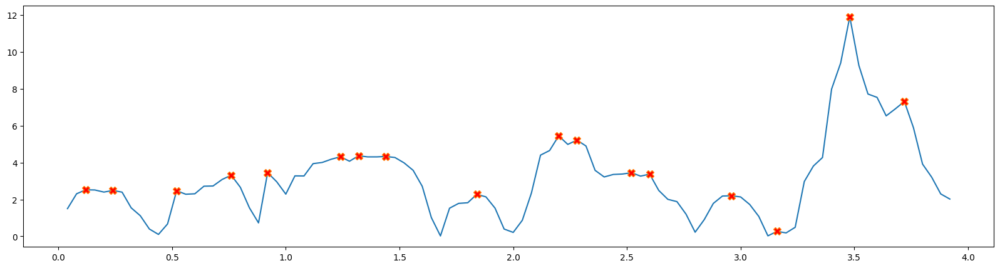

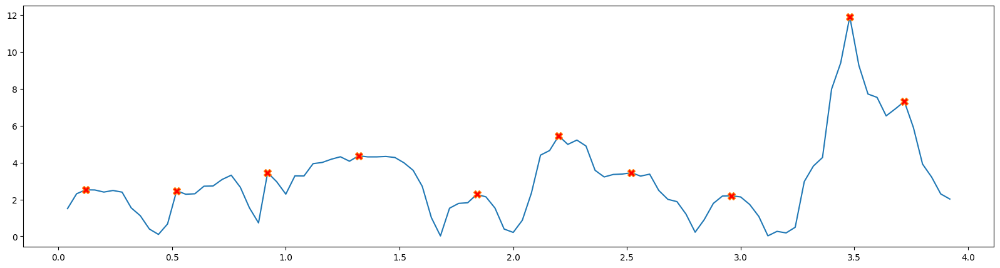

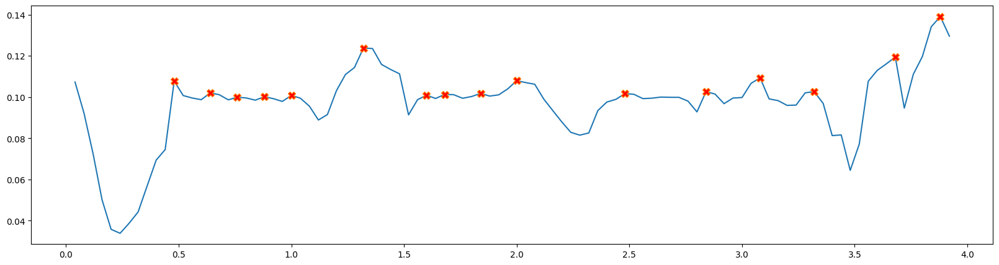

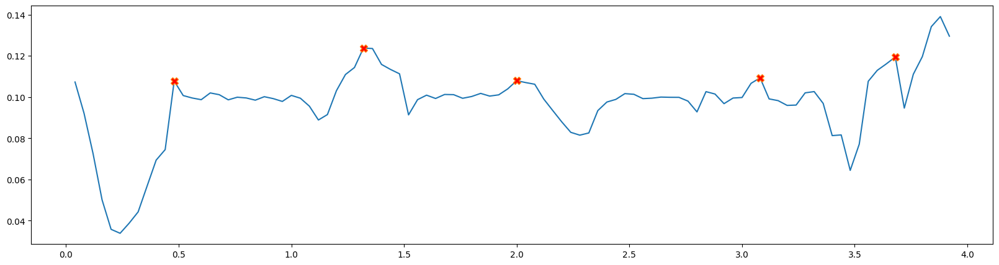

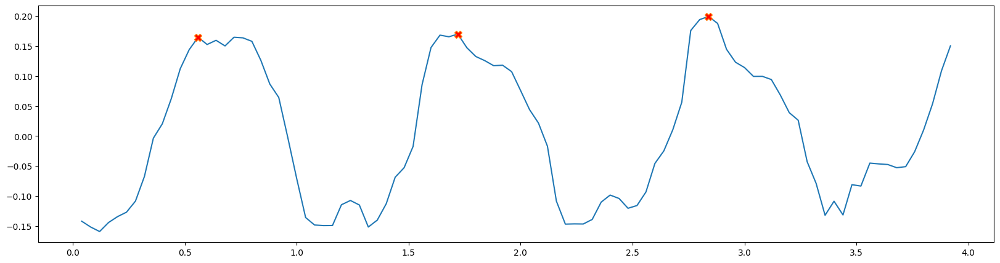

DETECTING GAIT___Foot lifting right


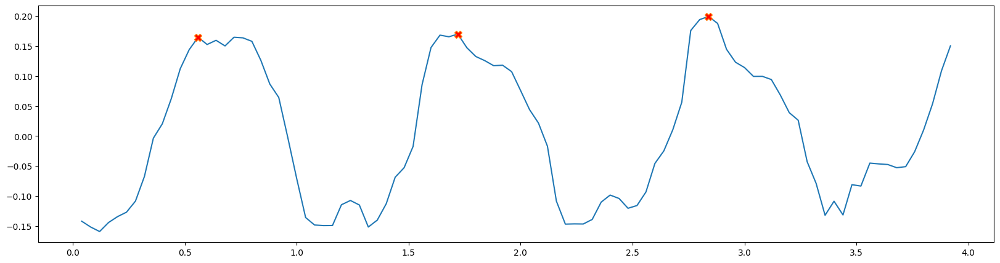

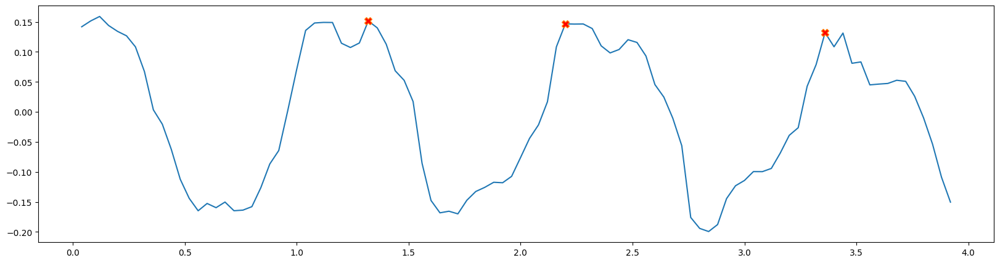

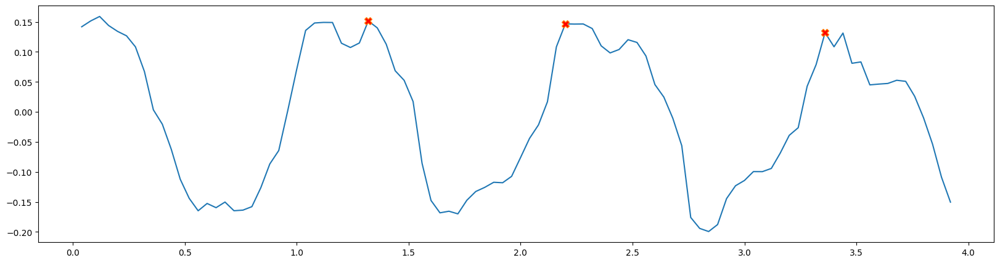

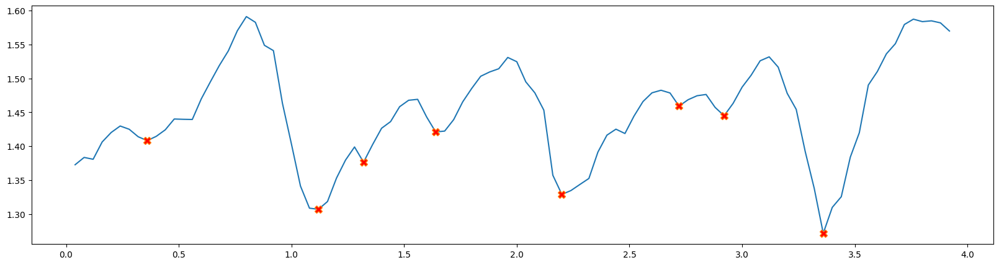

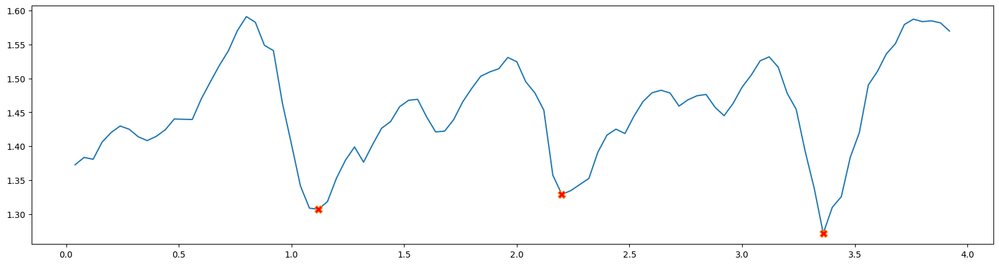

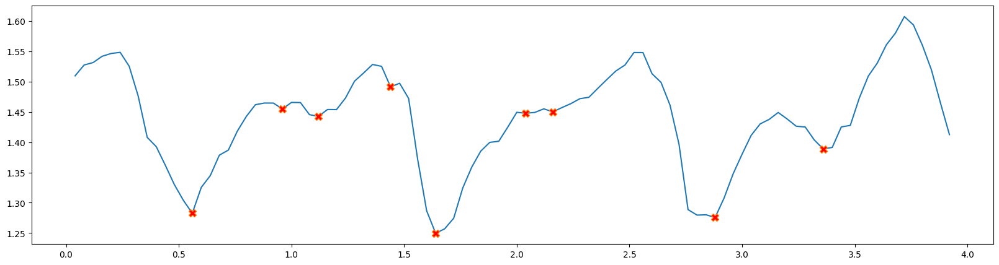

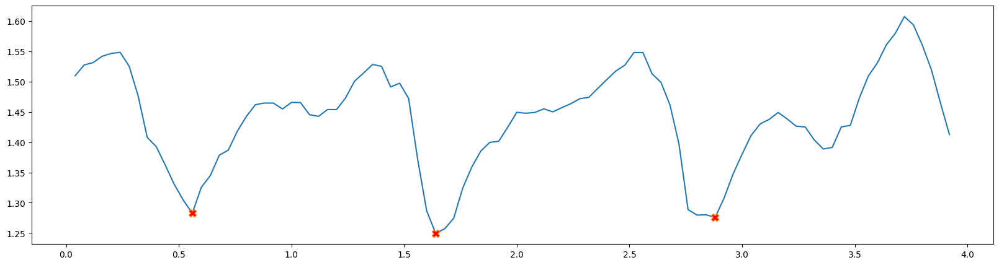

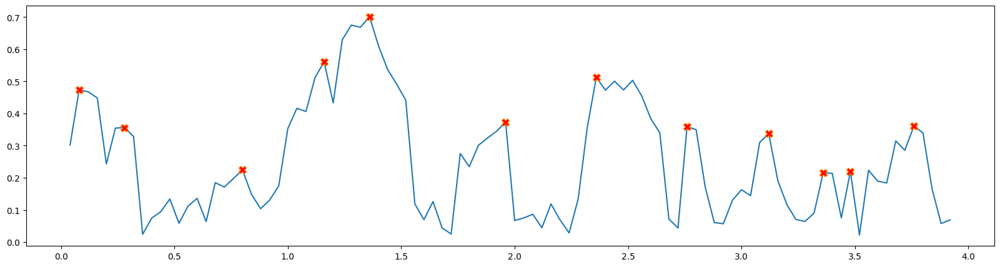

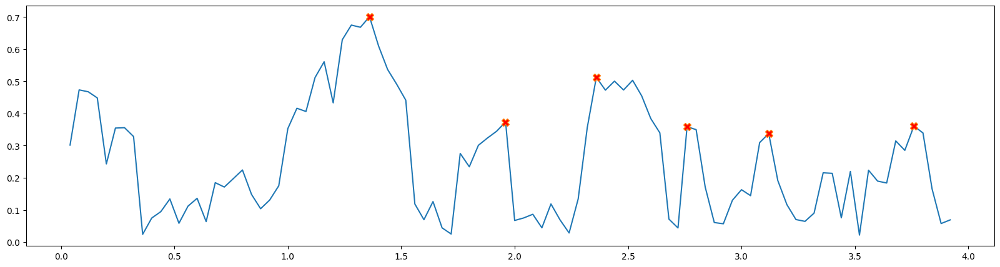

[32]
[22 32]
[32]
[33]
[32]
[22 32]
[32]
[33]
[54]
[45 54 62]
[49]
[48 58 68]
[54]
[45 54 62]
[49]
[48 58 68]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count  time       stl      hakr      hakl       flr       fll        po  \
0    0.0  0.56  0.701044  1.306941  1.266134  0.167261  0.151587  3.913422   
1    1.0  1.72  0.415093  1.328915  1.274460  0.184557  0.146755  3.726431   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll   visi_po  \
0  0.123831  0.981083   0.986964   0.990023  0.973402  0.981091  0.999256   
1  0.107965  0.987175   0.993235   0.993619  0.985619  0.988416  0.999420   

    visi_sw  
0  0.975952  
1  0.982196  
front back amani back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.362515  3.464784  0.060231 -0.282913  0.282913   
1    0.066667    2.0  0.358624  3.874742  0.047907 -0.205474  0.205474   
2    

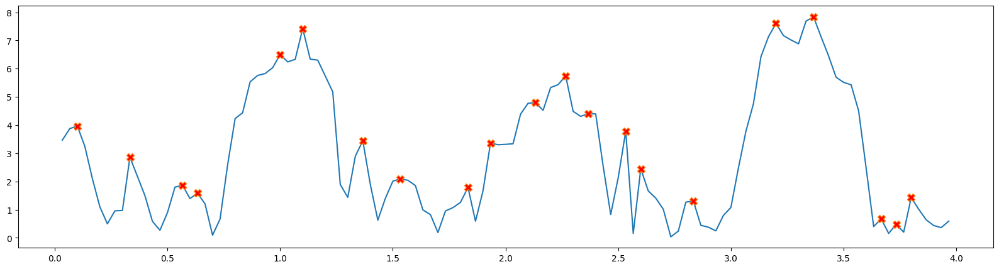

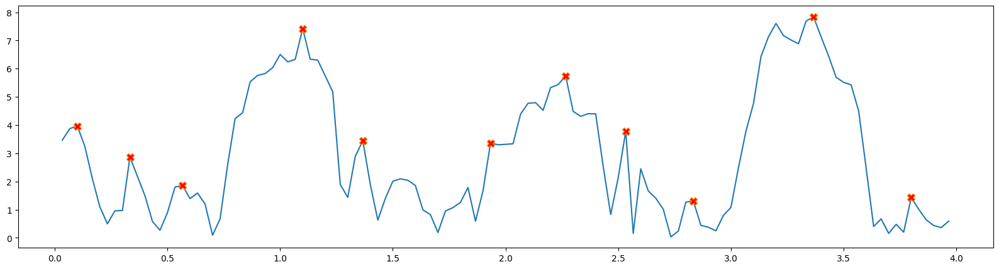

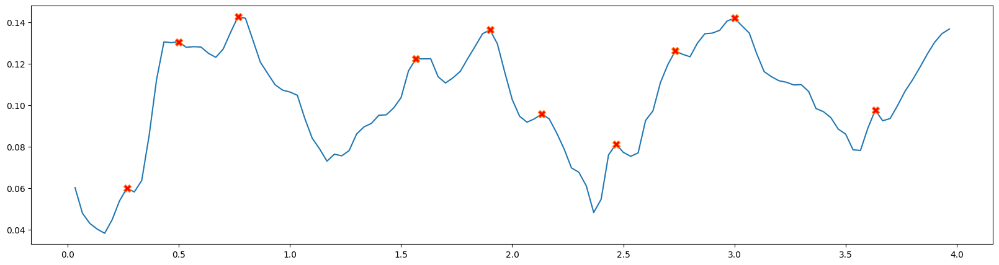

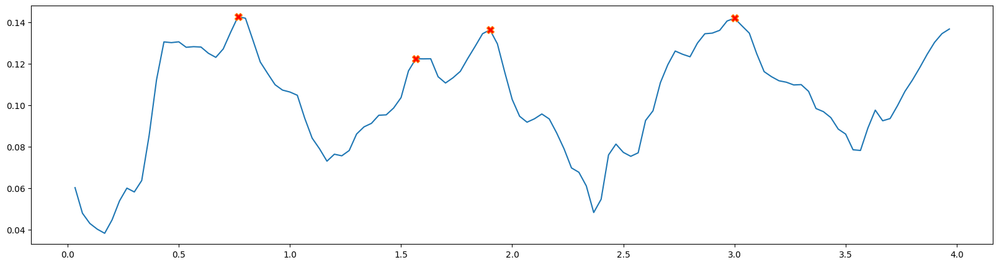

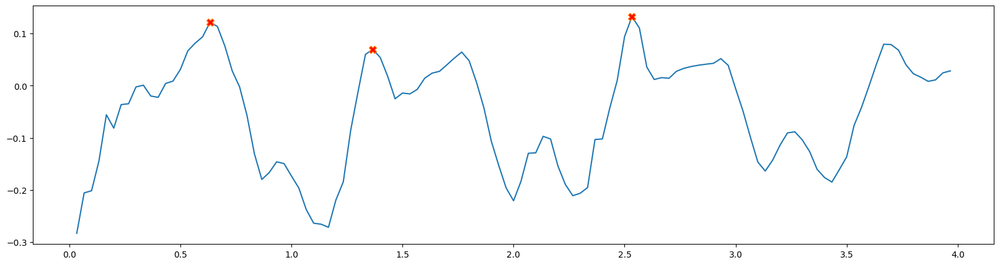

DETECTING GAIT___Foot lifting right


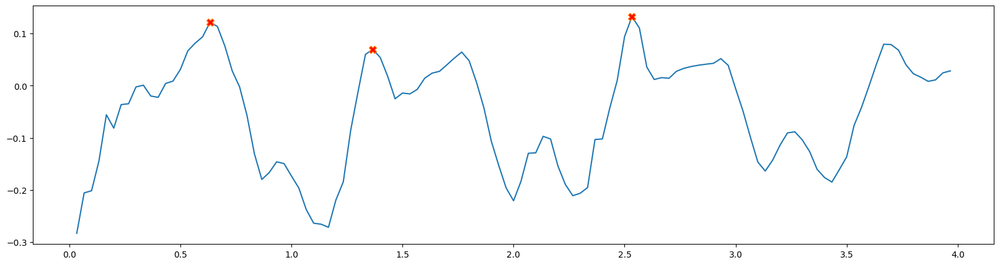

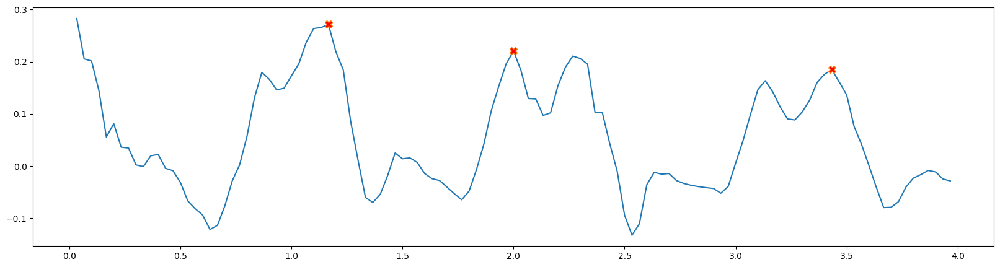

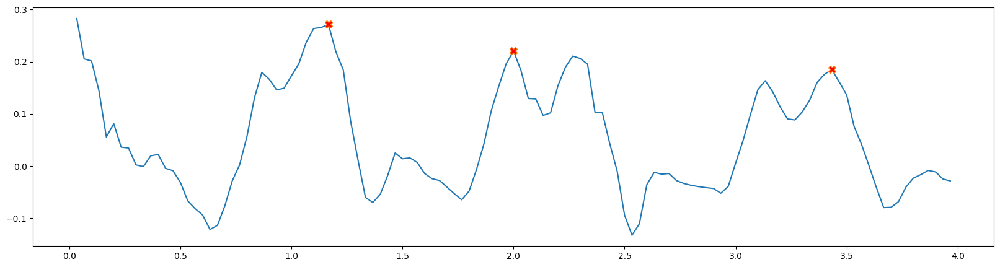

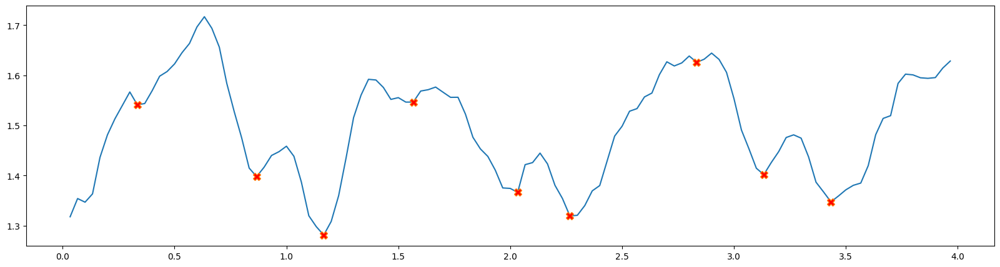

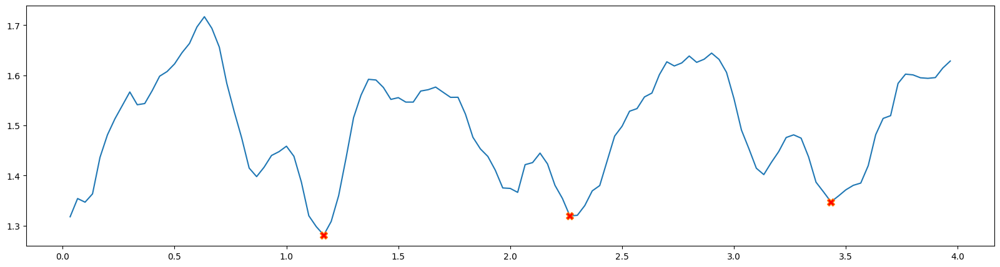

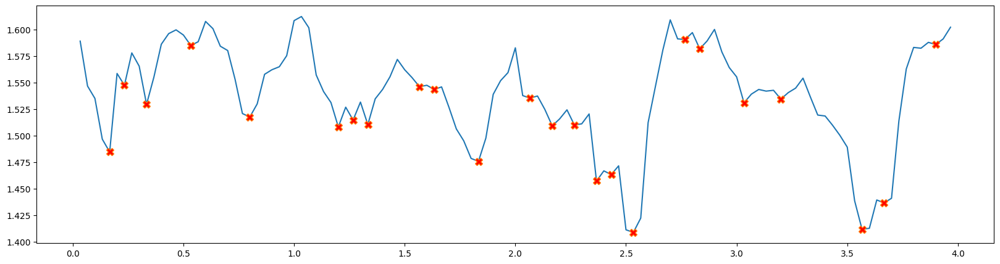

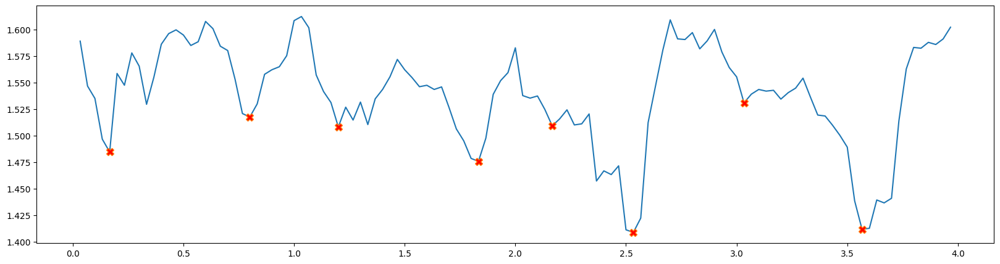

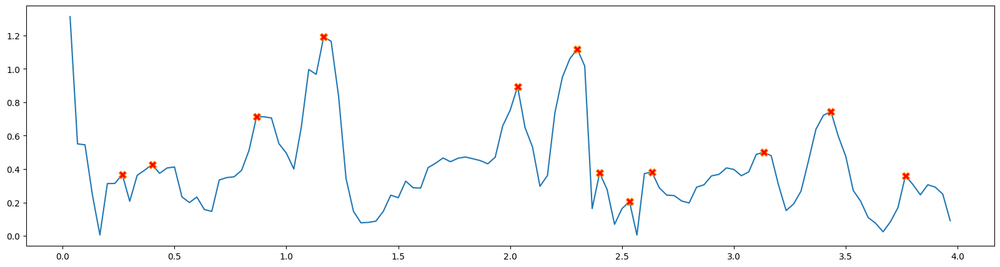

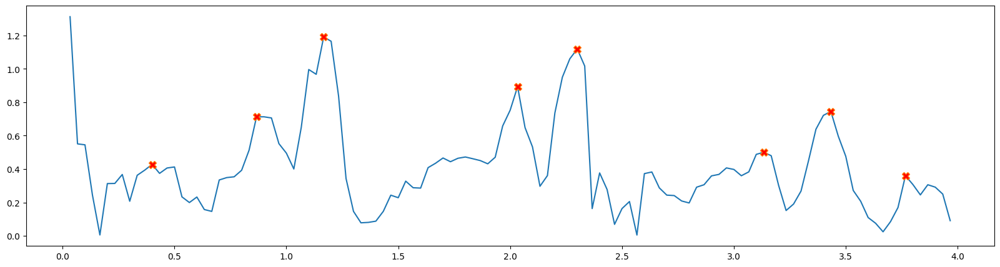

[34]
[32 40]
[22]
[25 34]
[34]
[32 40]
[22]
[25 34]
[59]
[40 57 67 75]
[46 56]
[60 68]
[59]
[40 57 67 75]
[46 56]
[60 68]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.633333  0.951992  1.281223  1.512911  0.095659  0.271407   
1    1.0  1.366667  1.006238  1.319384  1.464683  0.101121  0.220578   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  5.432810  0.142687  0.980263   0.983705   0.994419  0.978064  0.979364   
1  4.084238  0.129325  0.984149   0.985499   0.994092  0.979938  0.987489   

    visi_po   visi_sw  
0  0.999397  0.981814  
1  0.999212  0.986851  
front back chathura back 3
        t  count        sl        po        sw       flr       fll      hakr  \
0    0.04    1.0  0.367600  3.609490  0.113681  0.284926 -0.284926  1.749939   
1    0.08    2.0  0.370359  3.651091  0.

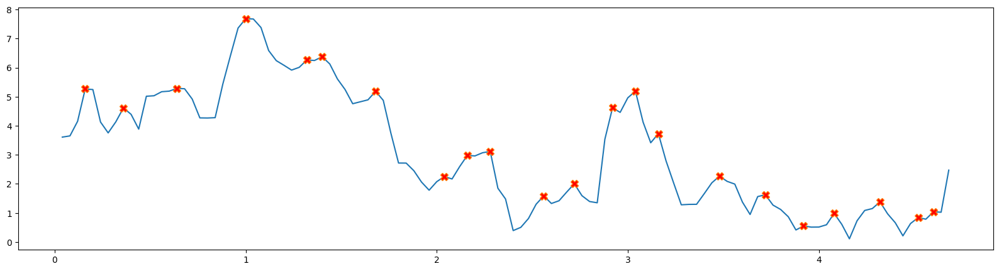

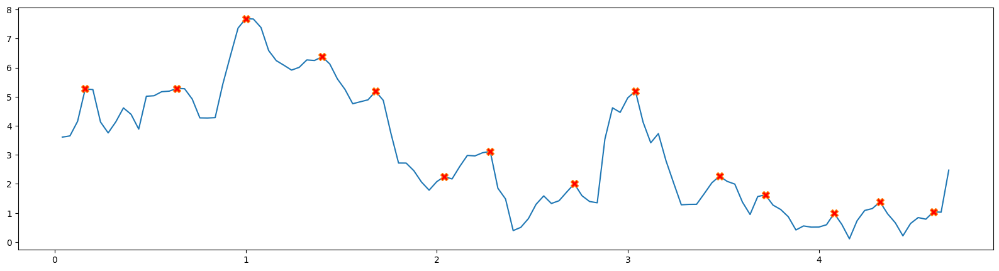

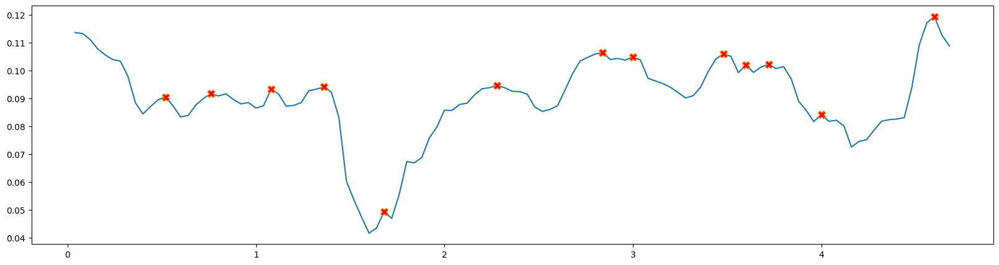

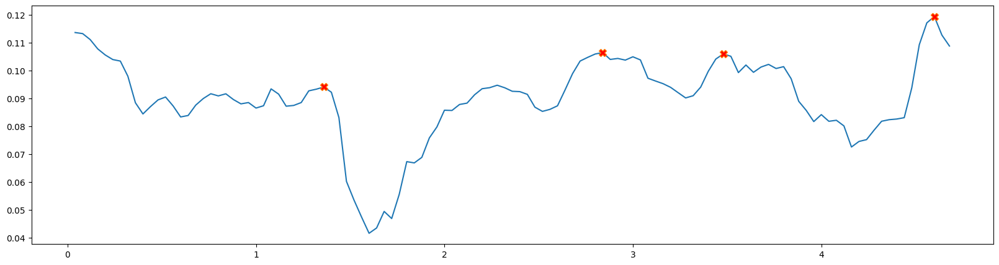

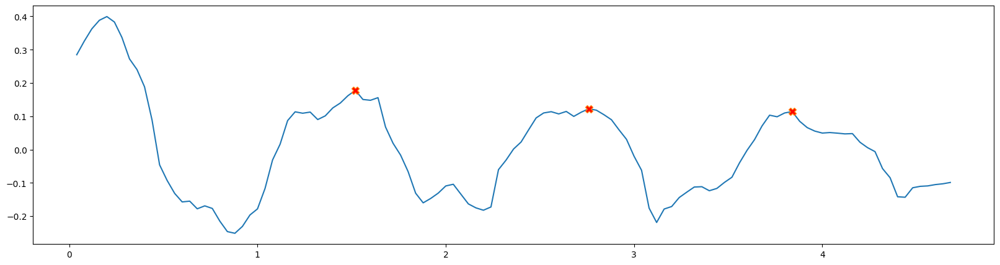

DETECTING GAIT___Foot lifting right


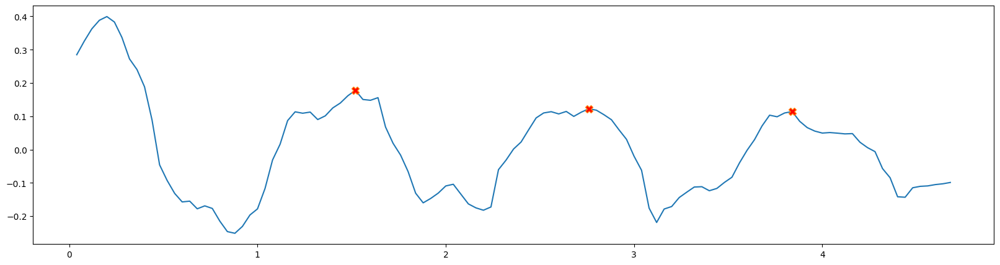

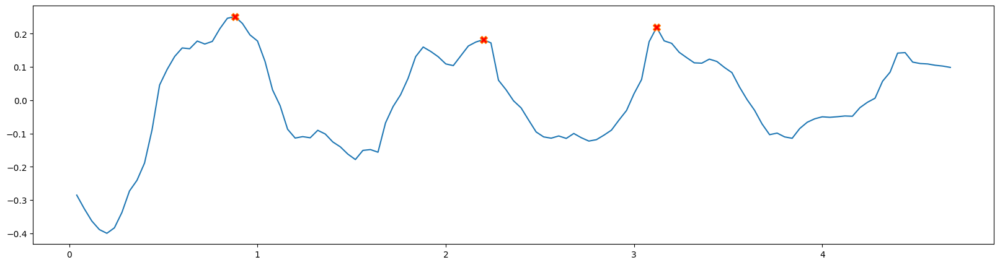

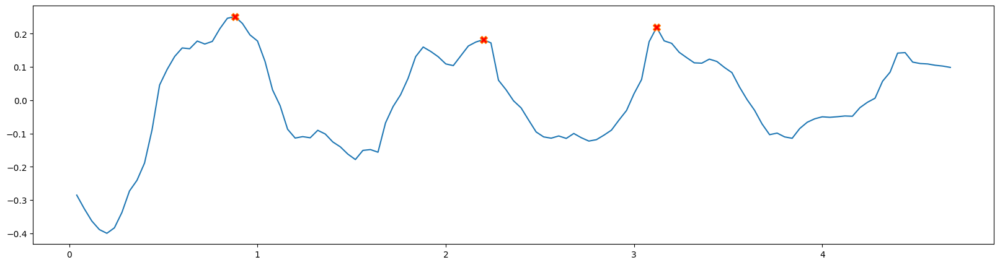

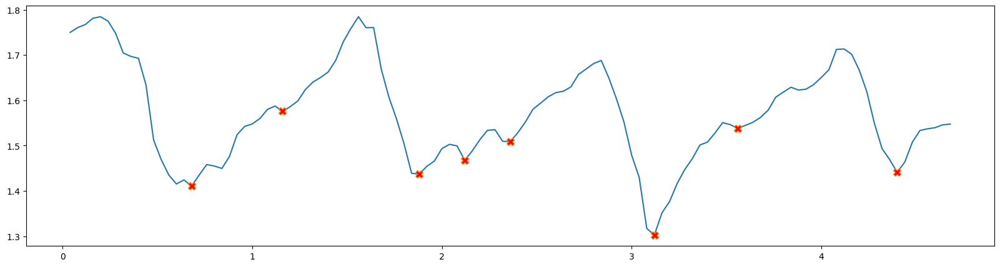

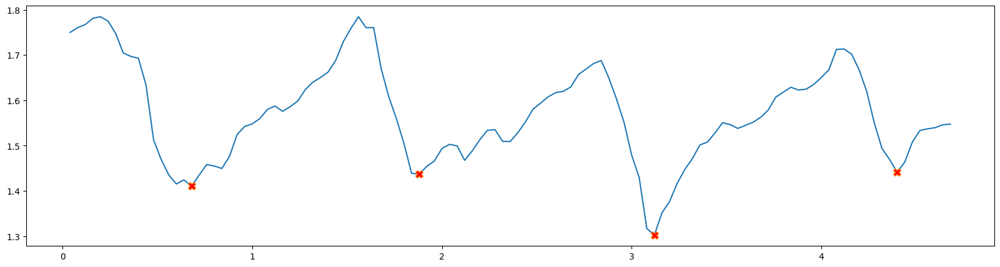

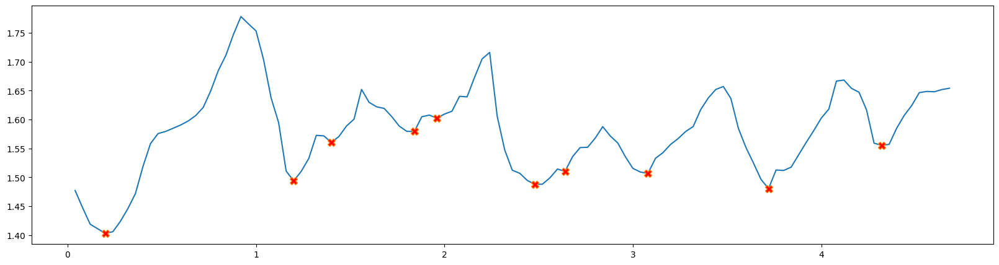

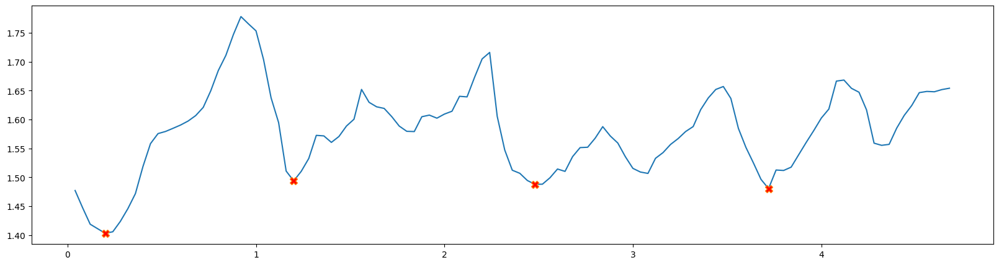

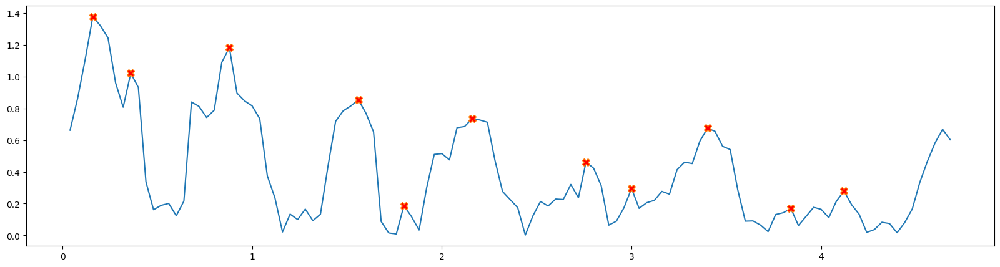

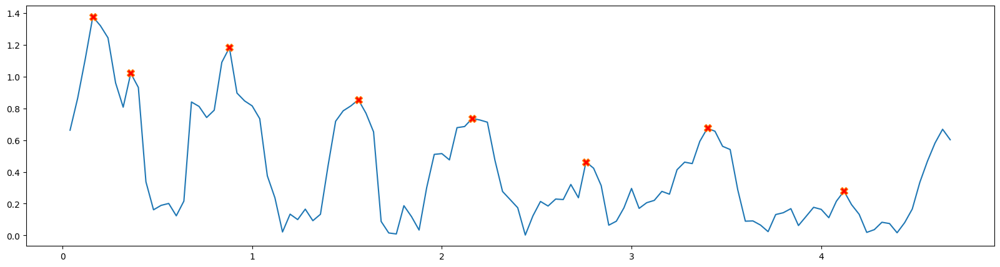

[54]
[41 50 56 67]
[]
[38 53 68]
[54]
[41 50 56 67]
[]
[38 53 68]
[77]
[75 86 92]
[70 86]
[68 84]
[77]
[75 86 92]
[70 86]
[68 84]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count  time       stl      hakr      hakl       flr       fll        po  \
0    0.0  1.52  0.683843  1.436669  1.487853  0.150324  0.181909  3.139739   
1    1.0  2.76  0.568414  1.302489  1.480387  0.118428  0.218667  3.027141   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll   visi_po  \
0  0.104763  0.976128   0.988850   0.990244  0.977143  0.975196  0.999238   
1  0.106251  0.980075   0.992602   0.984351  0.973181  0.986452  0.999135   

    visi_sw  
0  0.973492  
1  0.972434  
front back geemanthi back 3
        t  count        sl        po        sw       flr       fll      hakr  \
0    0.04    1.0  0.355254  1.734954  0.098001 -0.120148  0.120148  1.446364   
1    0.08    2.0  0.353922  0.330430  0.105

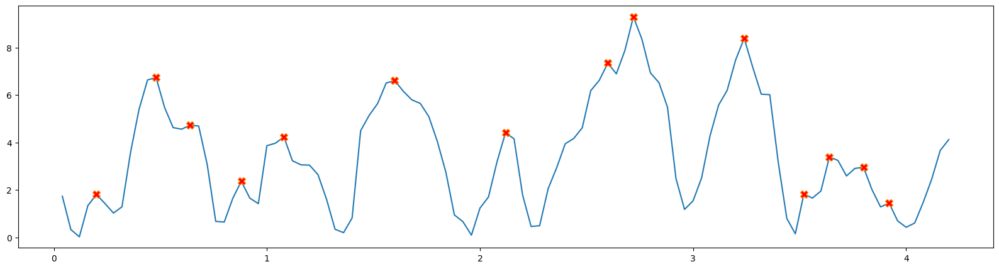

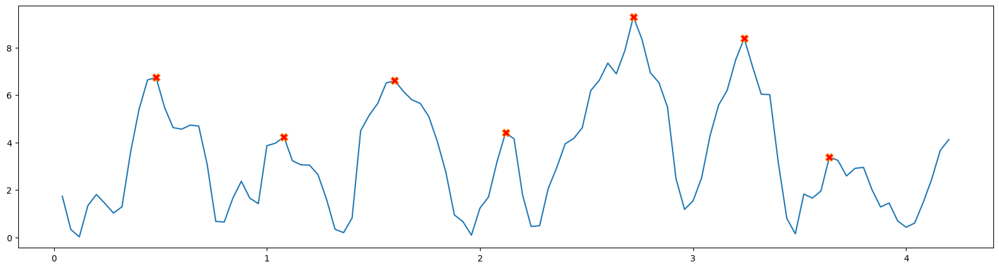

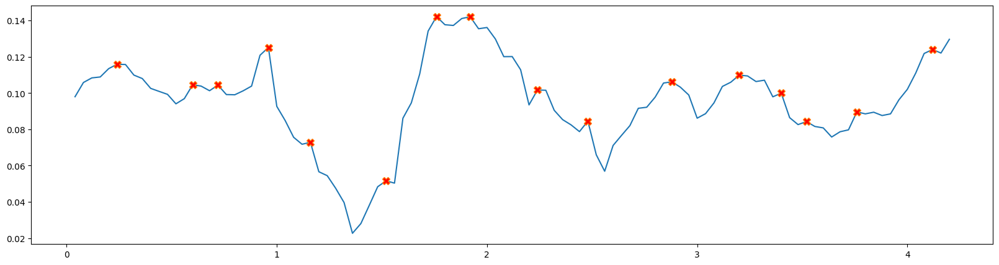

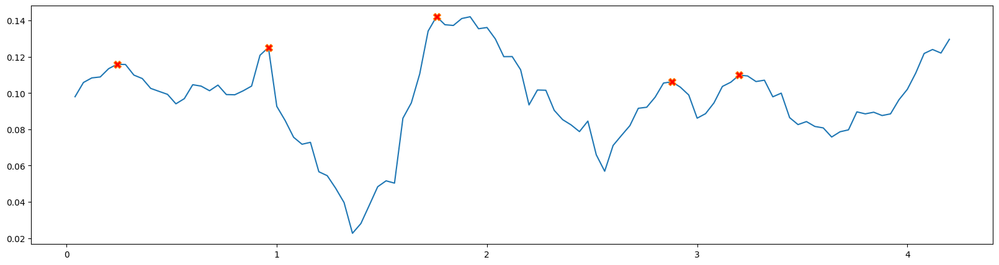

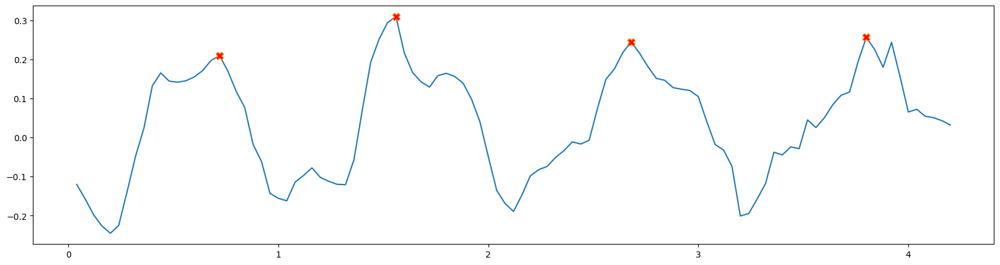

DETECTING GAIT___Foot lifting right


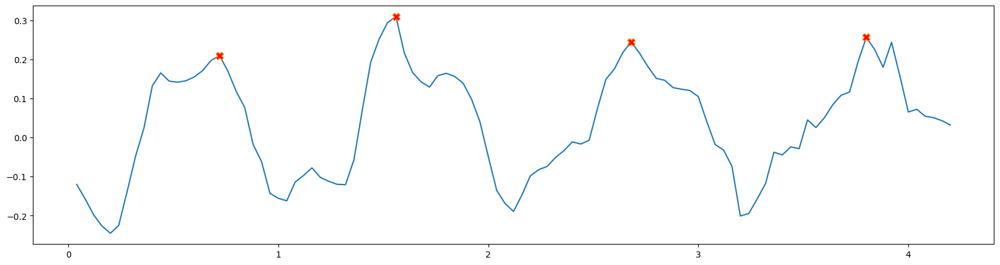

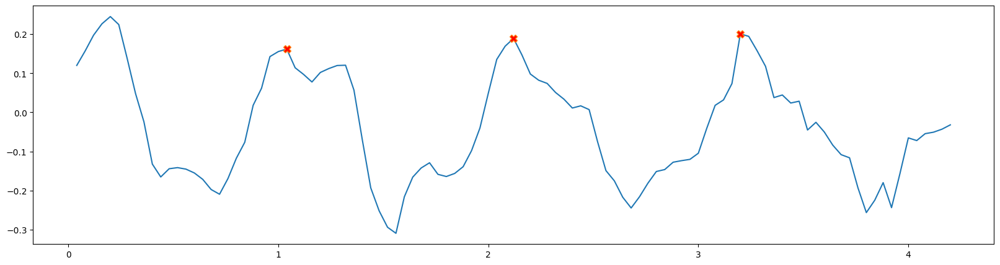

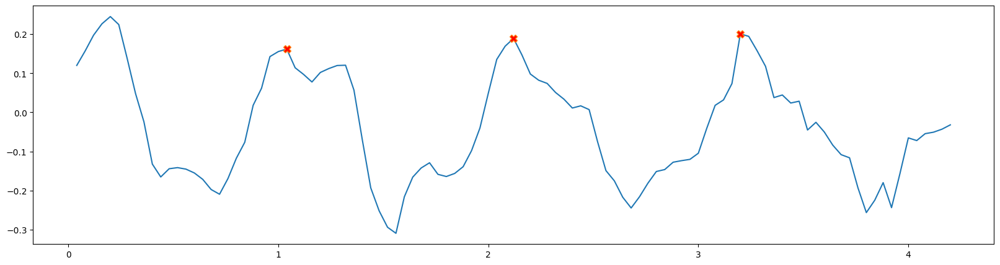

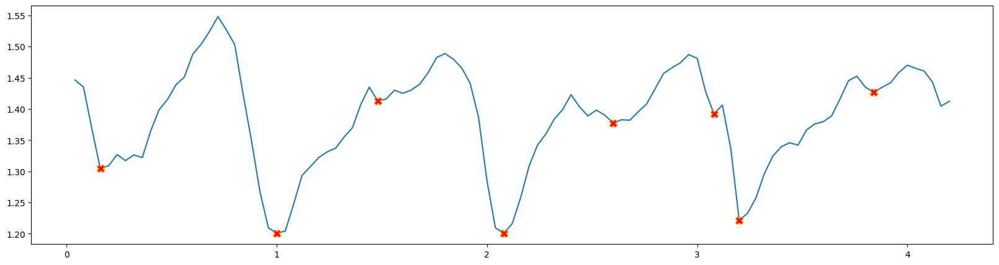

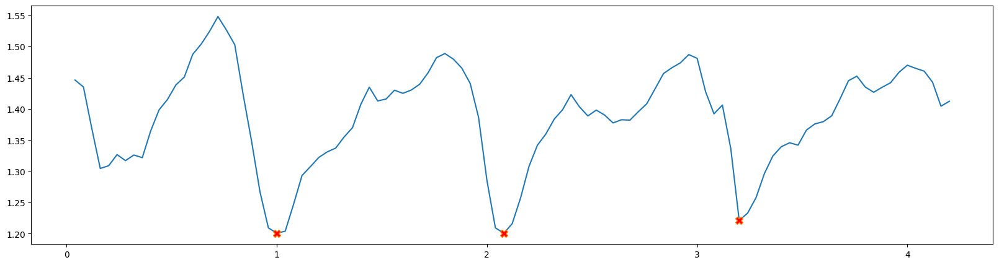

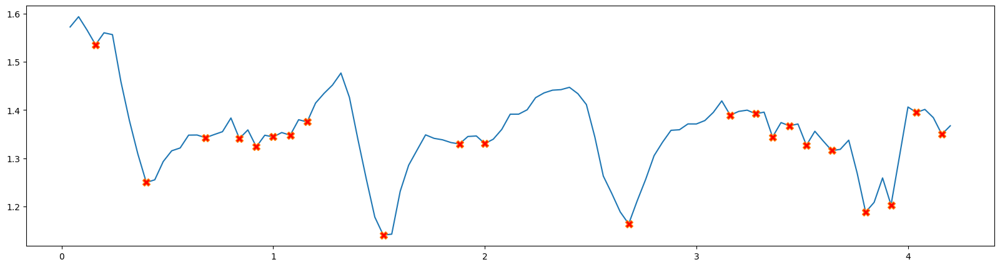

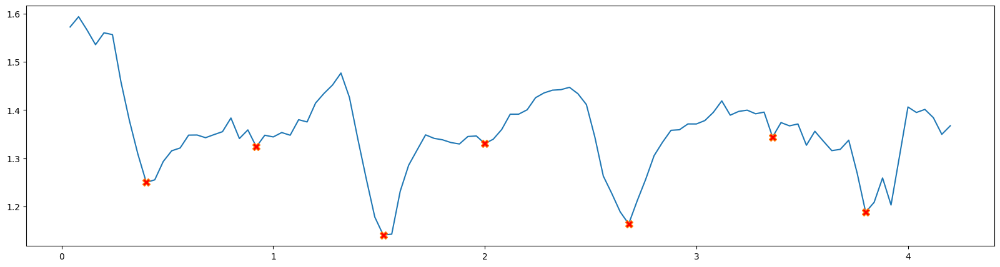

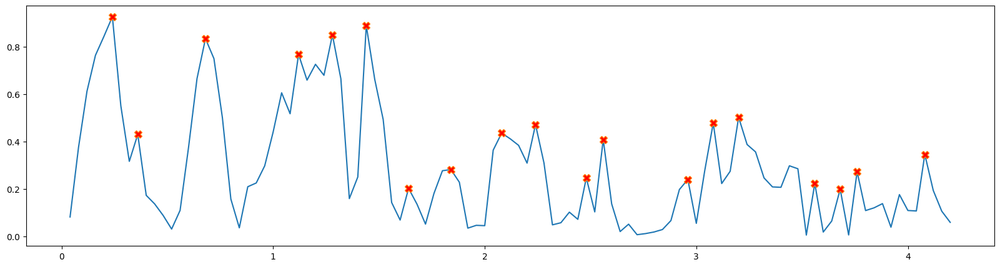

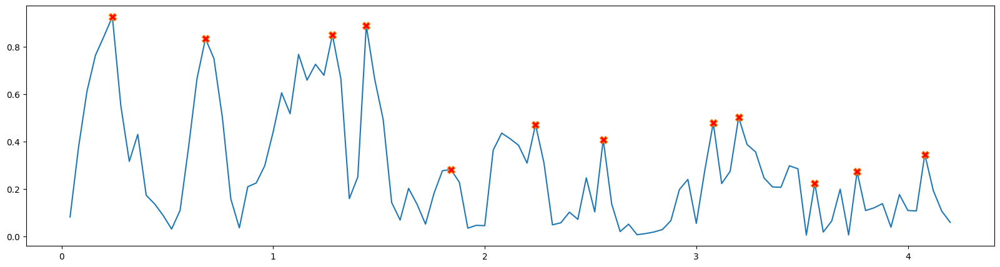

[25]
[26]
[23]
[31 35]
[25]
[26]
[23]
[31 35]
[52]
[39 52]
[43]
[45 55 63]
[52]
[39 52]
[43]
[45 55 63]
[79]
[67 80 90]
[71 79]
[76 79 88 93]
[79]
[67 80 90]
[71 79]
[76 79 88 93]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
0 2
1 2
2 2
3 2
4 2
5 2
6 2
7 2
8 2
9 2
10 2
11 2
12 2
13 2
14 2
   count  time       stl      hakr      hakl       flr       fll        po  \
0    0.0  0.72  0.870742  1.200784  1.232238  0.259544  0.162027  4.231695   
1    1.0  1.56  0.387814  1.200655  1.247095  0.277161  0.189282  5.508629   
2    2.0  2.68  0.369456  1.221341  1.232076  0.250675  0.200896  7.022966   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll   visi_po  \
0  0.125200  0.927959   0.965800   0.971165  0.931136  0.942219  0.999146   
1  0.142208  0.971975   0.984679   0.988017  0.961851  0.974621  0.999148   
2  0.108082  0.983097   0.991044   0.991527  0.982518  0.984819  0.999113   

   

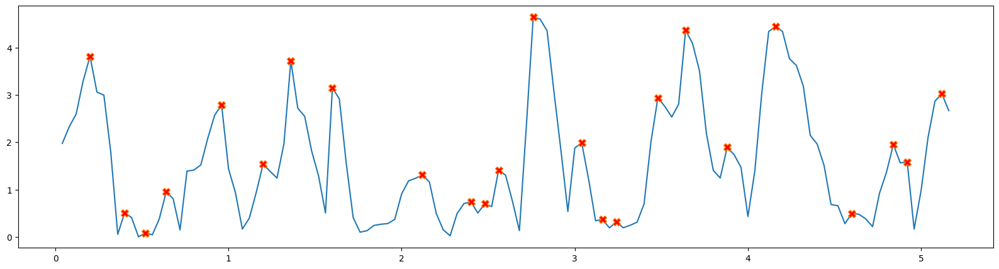

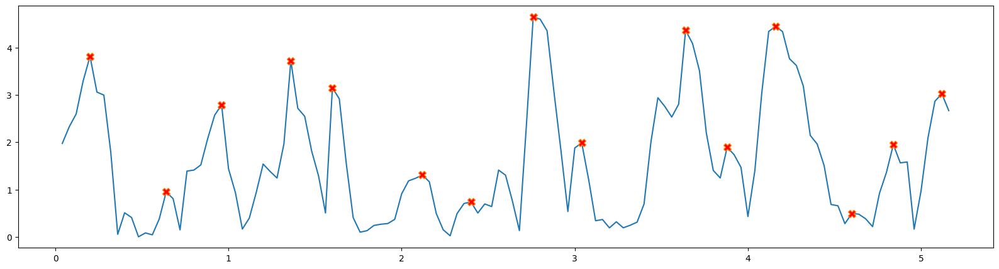

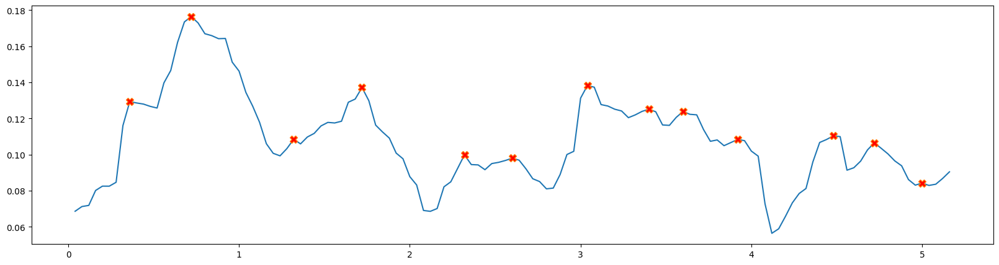

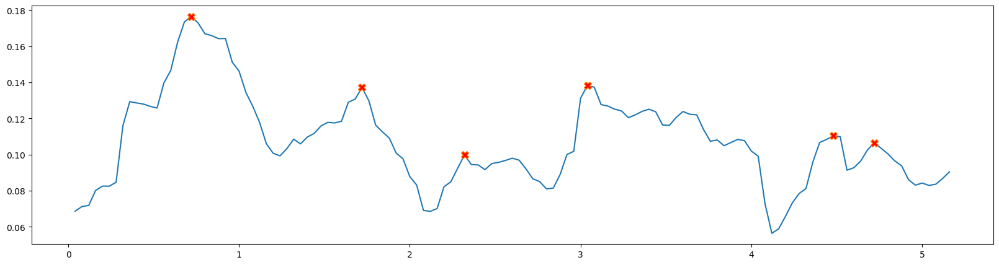

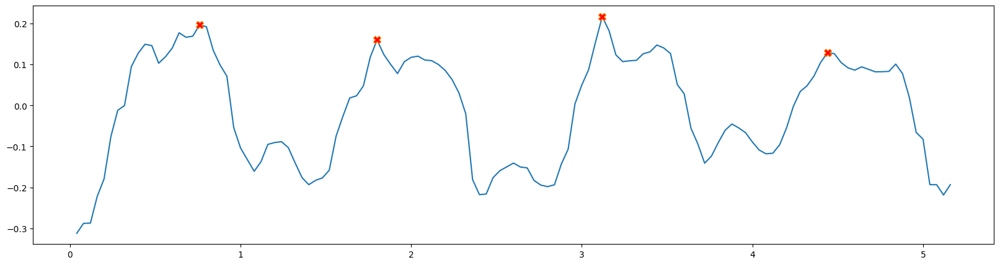

DETECTING GAIT___Foot lifting right


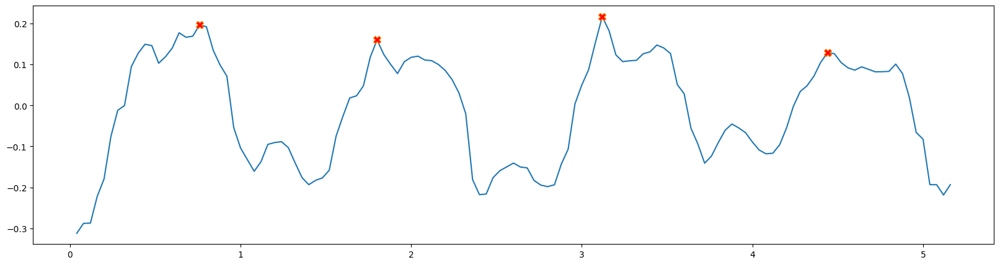

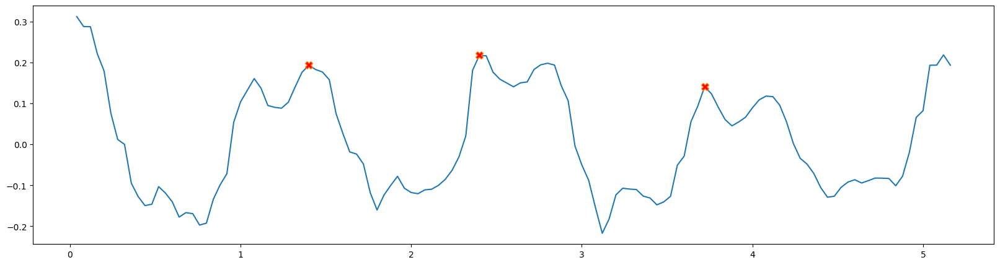

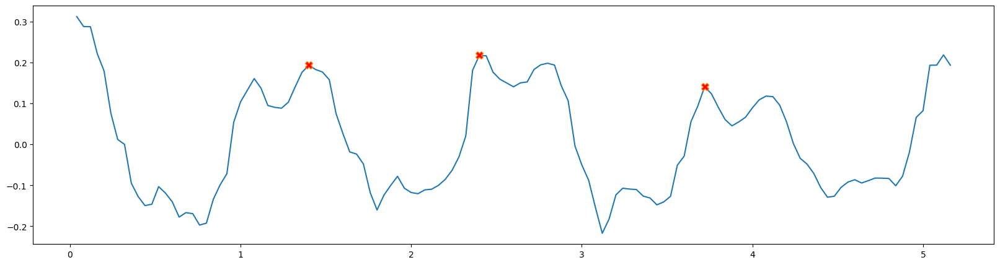

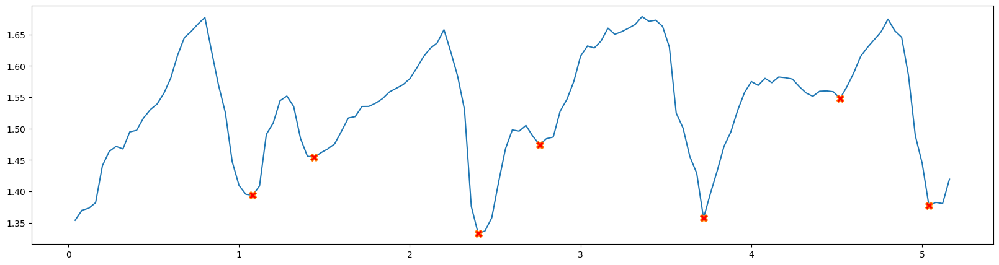

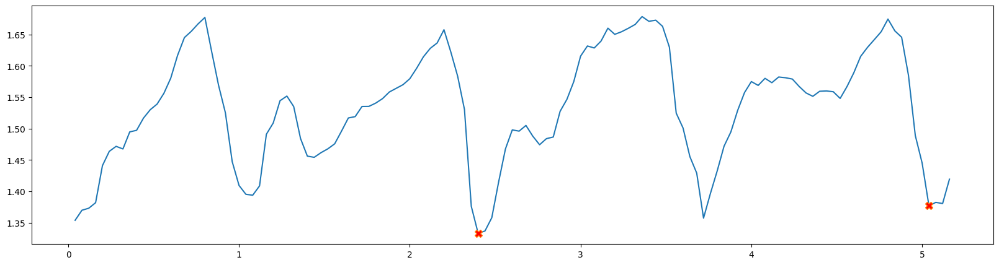

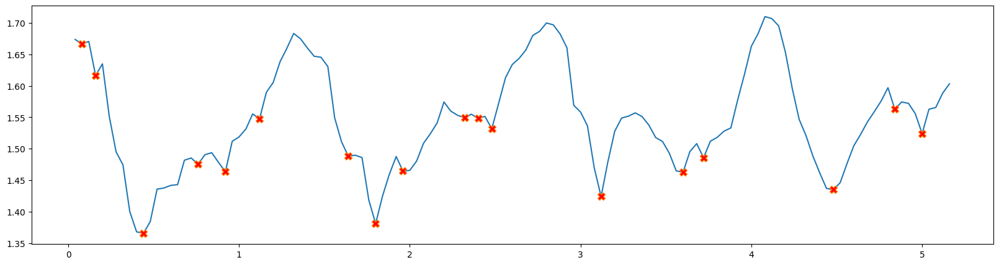

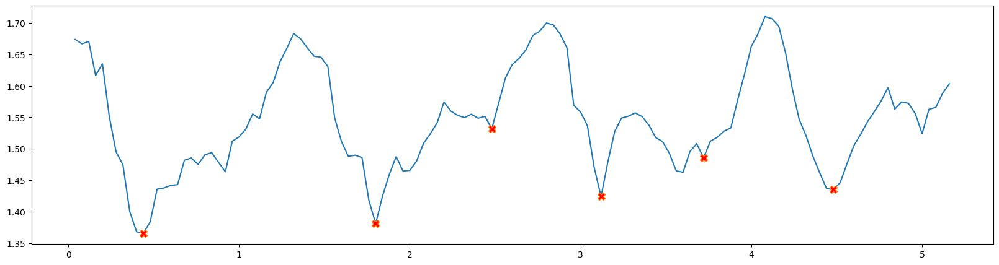

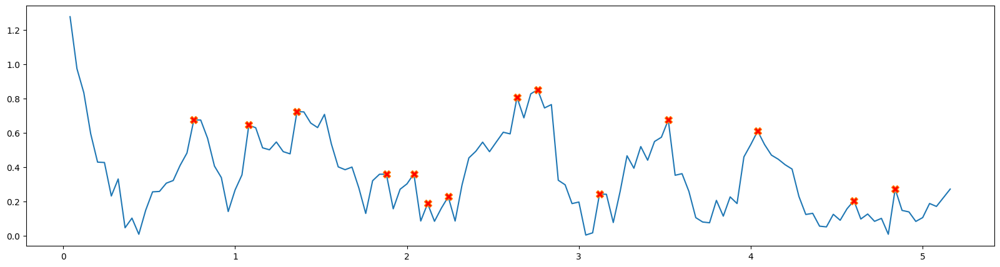

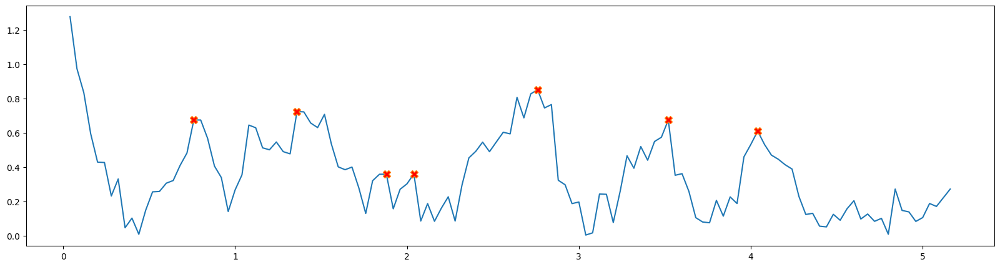

[34]
[23 33 39]
[42]
[18 33]
[34]
[23 33 39]
[42]
[18 33]
[59]
[52 59 68 75]
[57 75]
[46 50 68]
[59]
[52 59 68 75]
[57 75]
[46 50 68]
[92]
[ 90  96 103]
[]
[ 87 100]
[92]
[ 90  96 103]
[]
[ 87 100]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
0 2
1 2
2 2
3 2
4 2
5 2
6 2
7 2
8 2
9 2
10 2
11 2
12 2
13 2
14 2
   count  time       stl      hakr      hakl       flr       fll        po  \
0    0.0  0.76  0.700367  1.393920  1.381043  0.178588  0.193359  3.219683   
1    1.0  1.80  0.524958  1.333261  1.445599  0.188595  0.217717  2.169522   
2    2.0  3.12  0.643340  1.357444  1.454753  0.172999  0.140966  3.567063   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll   visi_po  \
0  0.137162  0.951121   0.962711   0.988670  0.954644  0.956940  0.999390   
1  0.119075  0.961790   0.980058   0.987775  0.965410  0.966130  0.999165   
2  0.127727  0.959449   0.954266   0.987073  0.959364  0.970953

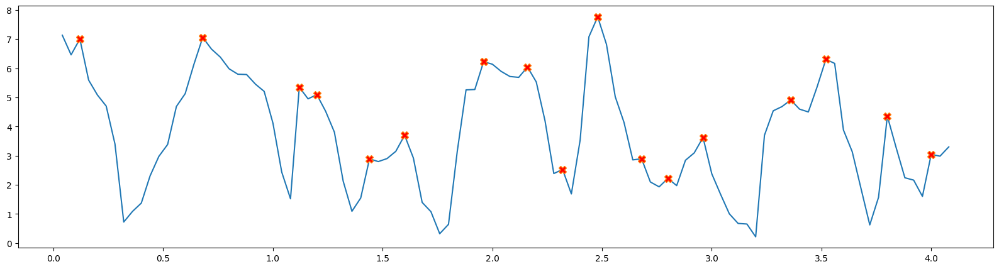

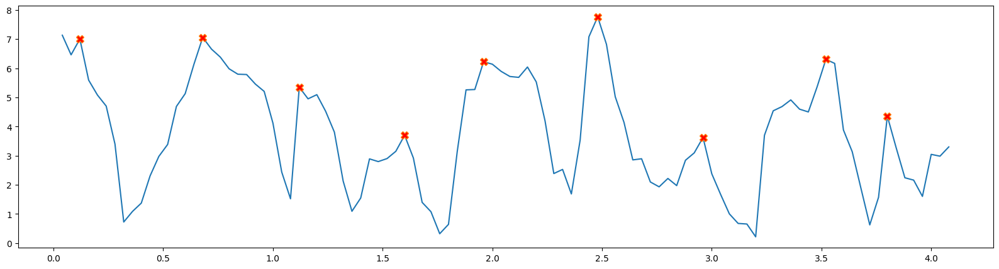

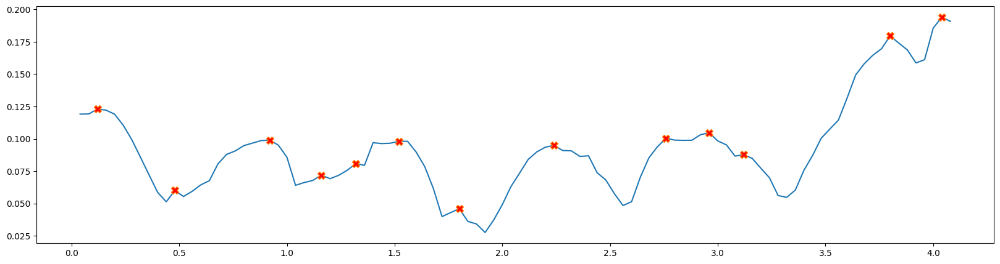

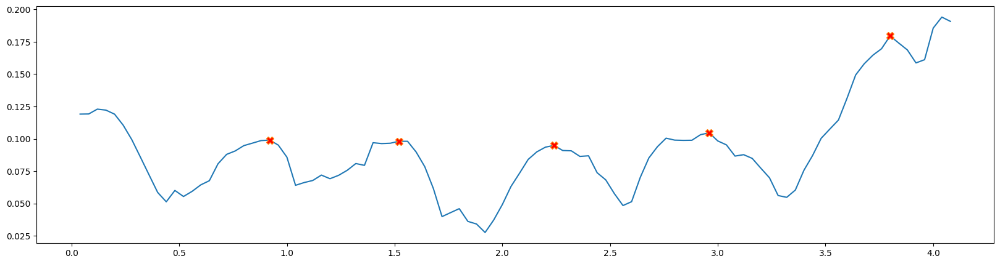

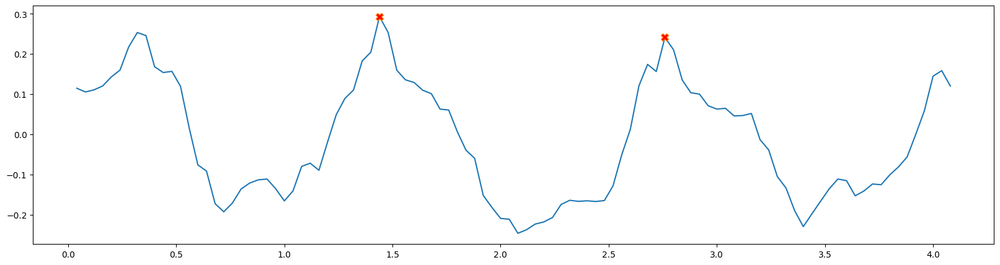

DETECTING GAIT___Foot lifting right


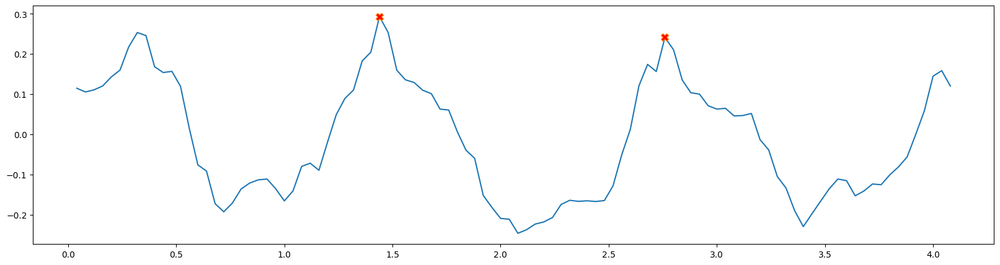

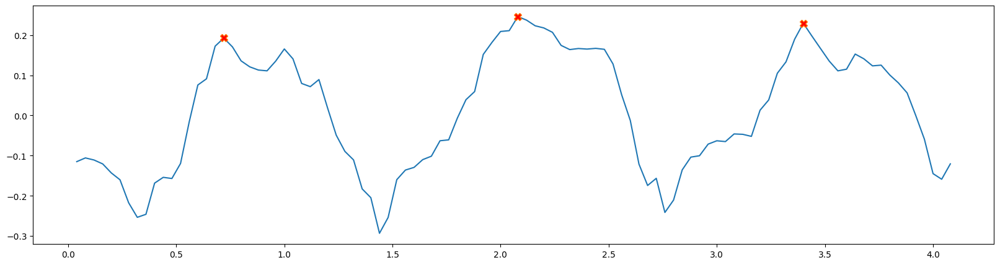

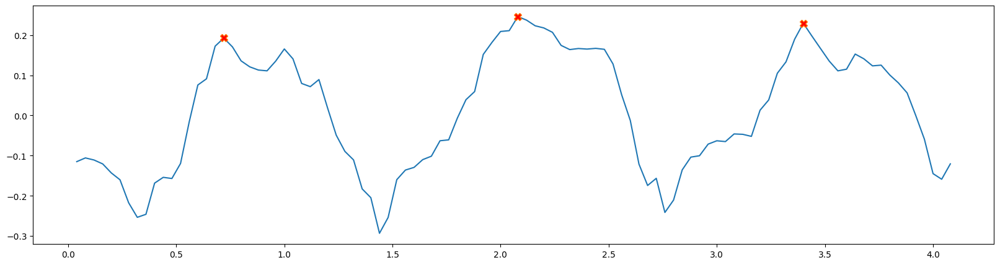

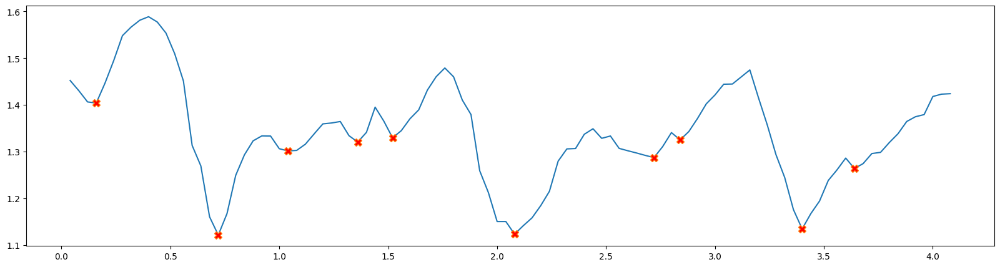

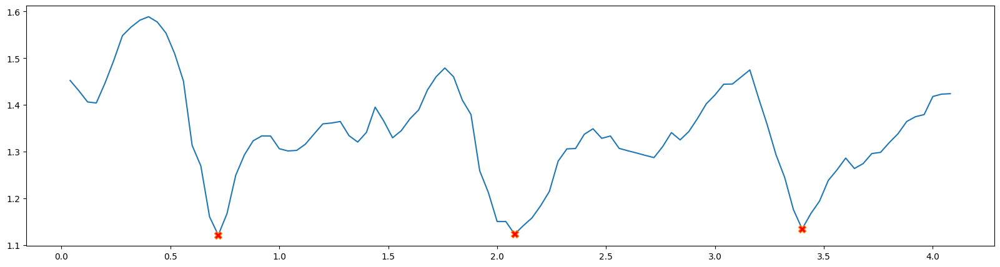

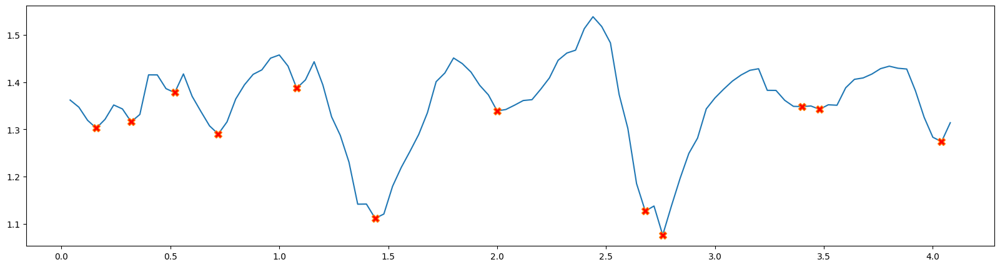

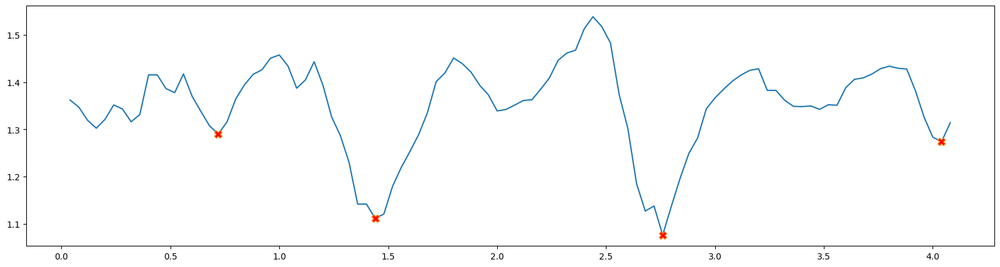

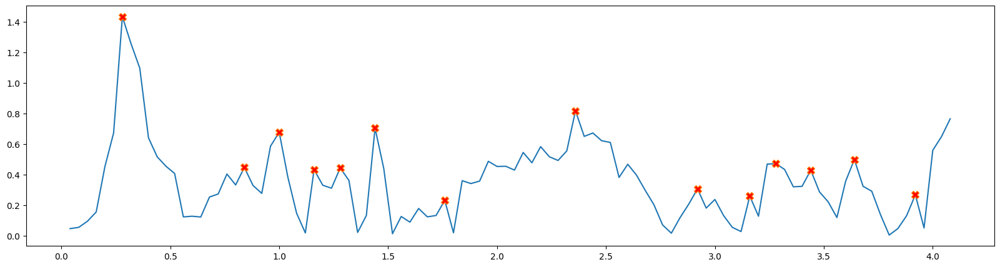

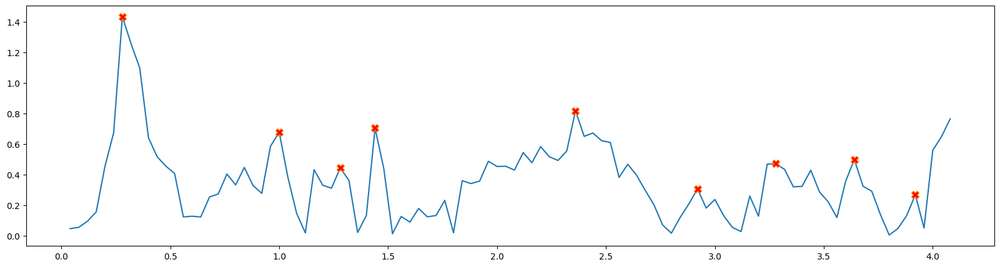

[51]
[39 48 61]
[37 55]
[35 58]
[51]
[39 48 61]
[37 55]
[35 58]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
   count  time       stl      hakr      hakl       flr       fll        po  \
0    0.0  1.44  0.761003  1.123455  1.093643  0.267182  0.245893  5.895379   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll   visi_po  \
0  0.096482  0.969308   0.980945   0.986892  0.964723  0.968674  0.999227   

    visi_sw  
0  0.973328  
front back hasitha back 3
       t  count        sl        po        sw       flr       fll      hakr  \
0   0.04    1.0  0.363092  1.937902  0.101048 -0.095442  0.095442  1.264162   
1   0.08    2.0  0.362107  1.575680  0.103462 -0.100264  0.100264  1.253319   
2   0.12    3.0  0.361891  1.395117  0.104928 -0.098347  0.098347  1.254692   
3   0.16    4.0  0.363149  1.317761  0.106936 -0.100021  0.100021  1.254388   
4   0.20    5.0  0.369820  0.421853  0.111511 -0.086024  0.086024  1.288402   
..   ...    ...       ...      

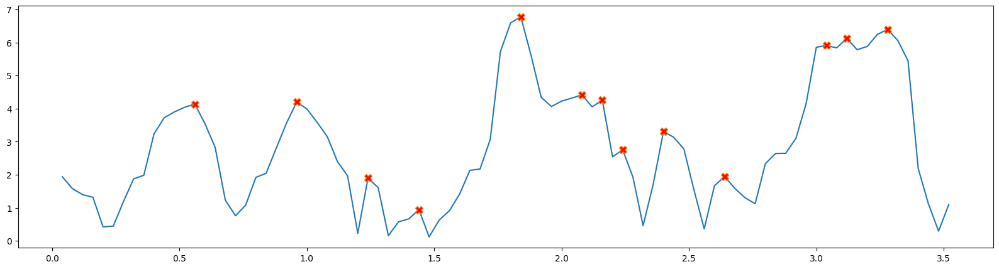

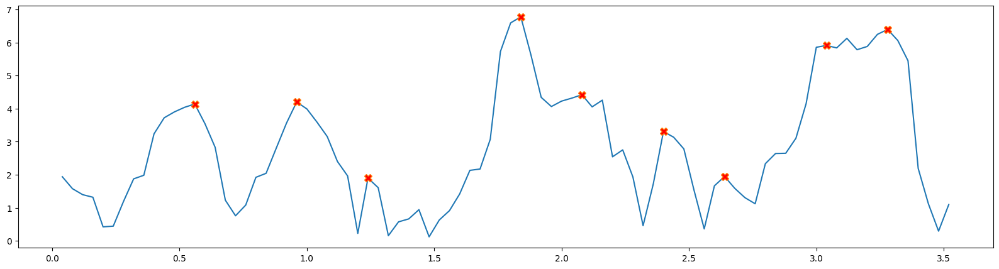

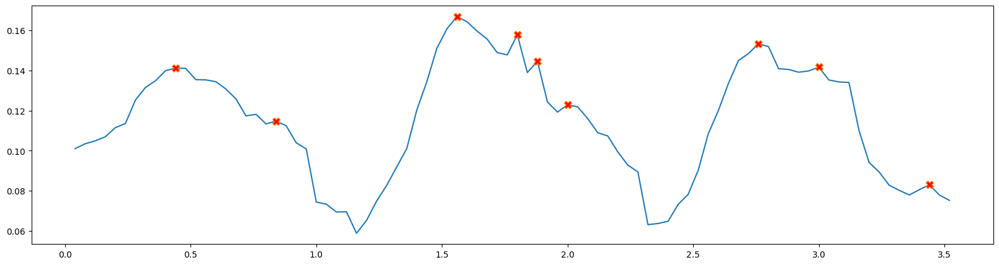

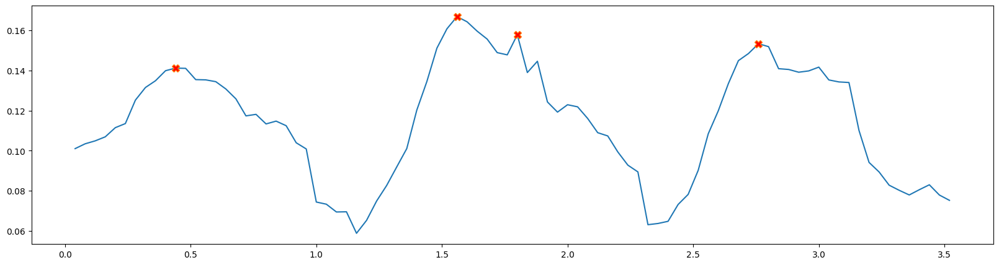

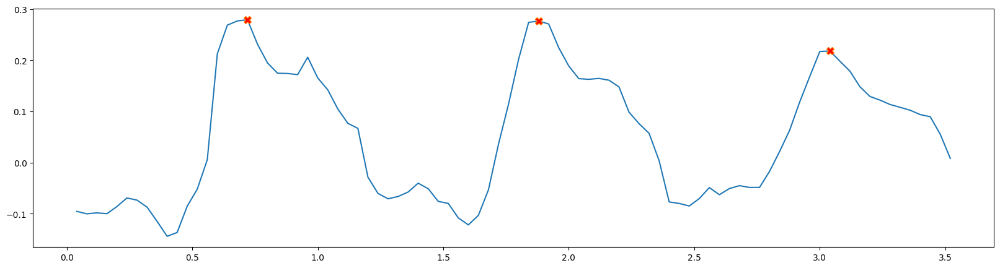

DETECTING GAIT___Foot lifting right


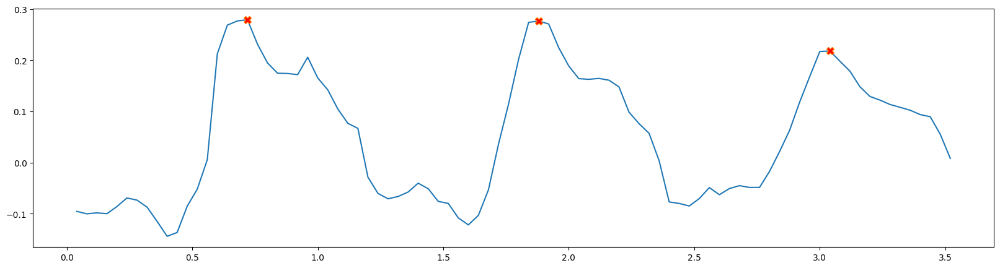

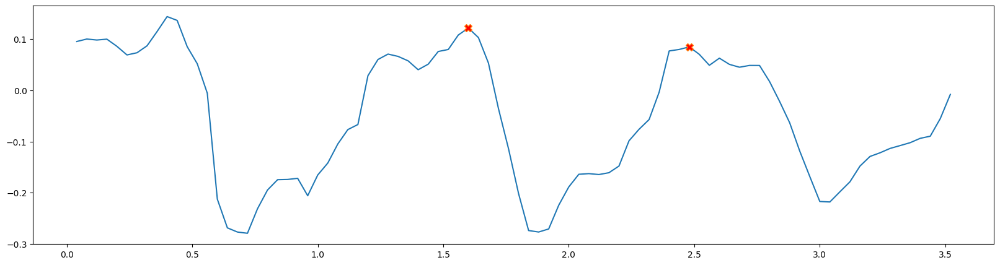

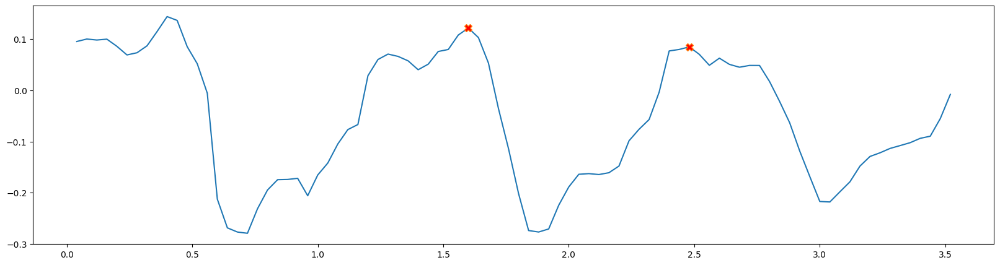

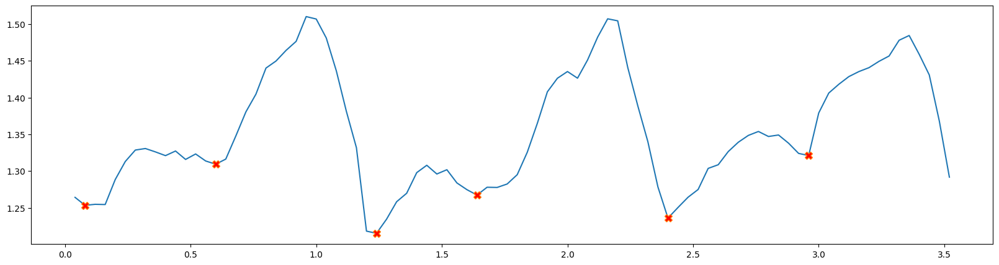

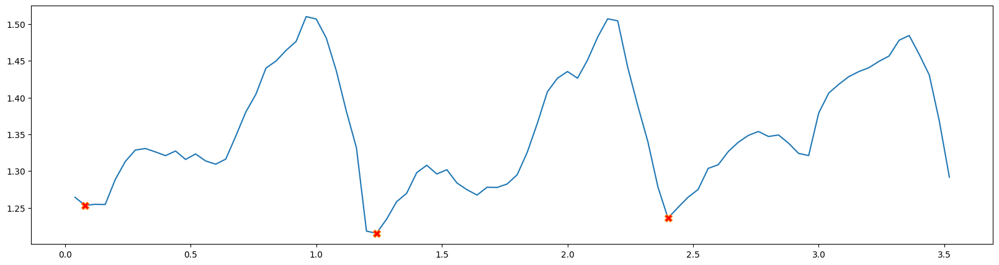

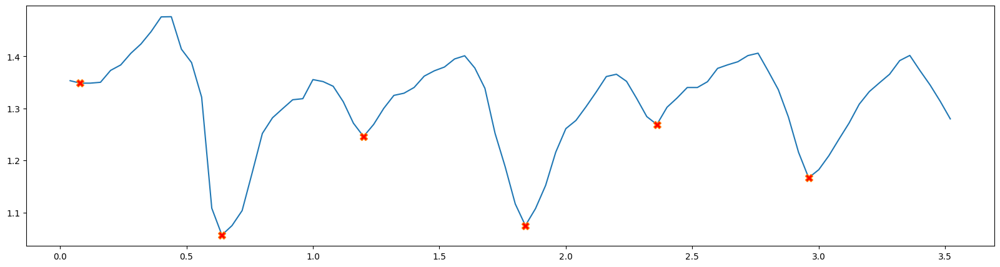

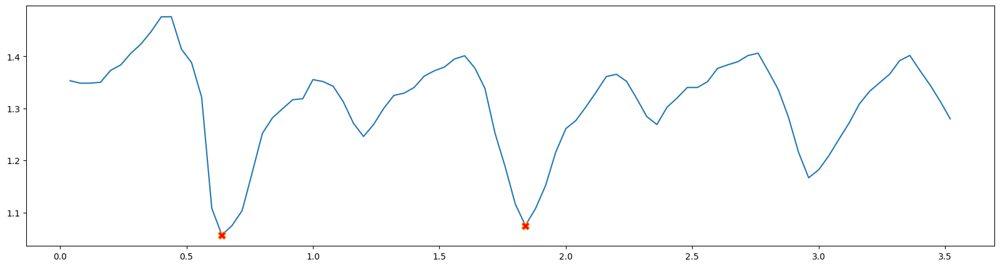

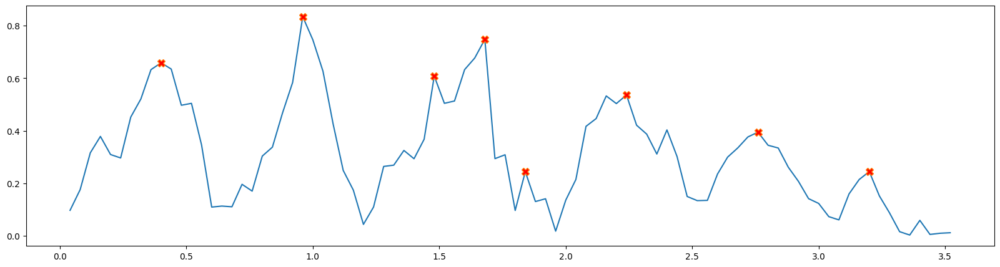

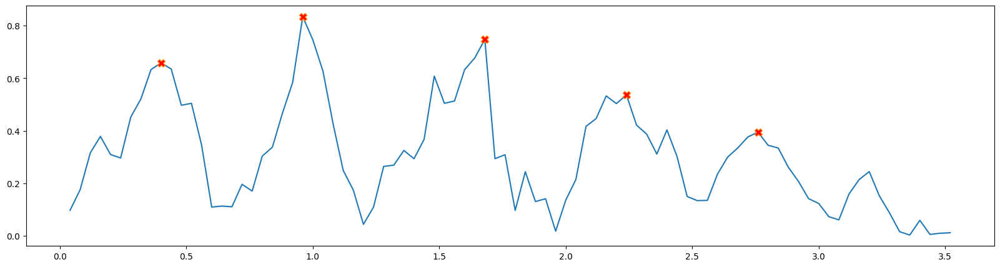

[39]
[23 30 45]
[38 44]
[23 41]
[39]
[23 30 45]
[38 44]
[23 41]
[61]
[51 59 65 75]
[68]
[55 68]
[61]
[51 59 65 75]
[68]
[55 68]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count  time       stl      hakr      hakl       flr       fll        po  \
0    0.0  0.72  0.791106  1.215250  1.074961  0.278152  0.121806  4.290518   
1    1.0  1.88  0.465356  1.235904  1.107477  0.247555  0.084940  3.895593   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll   visi_po  \
0  0.162412  0.985205   0.993362   0.994105  0.986442  0.985538  0.999604   
1  0.153402  0.982428   0.992208   0.989847  0.985373  0.984041  0.999548   

    visi_sw  
0  0.985993  
1  0.984561  
front back jayasanka back 3
        t  count        sl        po        sw       flr       fll      hakr  \
0    0.04    1.0  0.350851  1.424260  0.217113 -0.156876  0.156876  1.446661   
1    0.08    2.0  0.357647  1.028436  0.20812

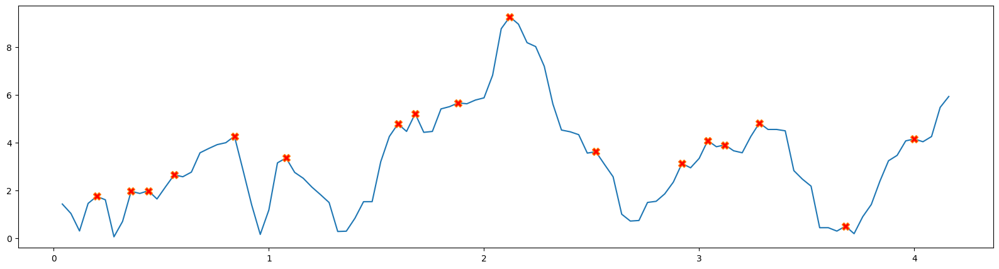

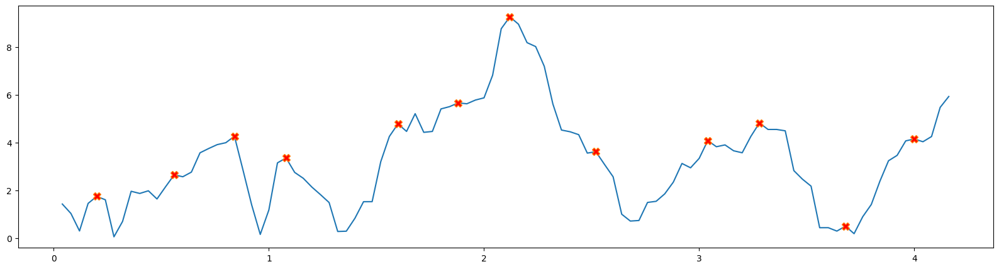

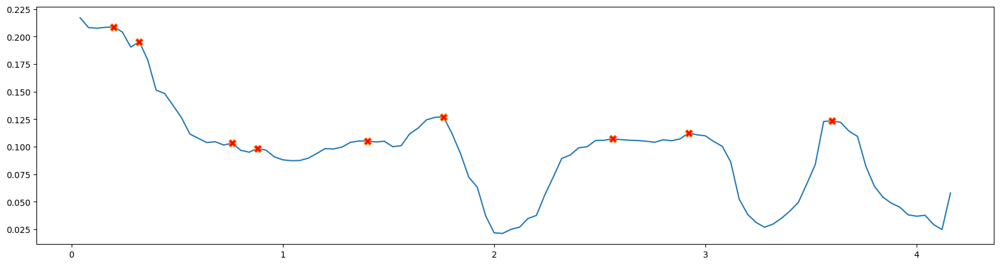

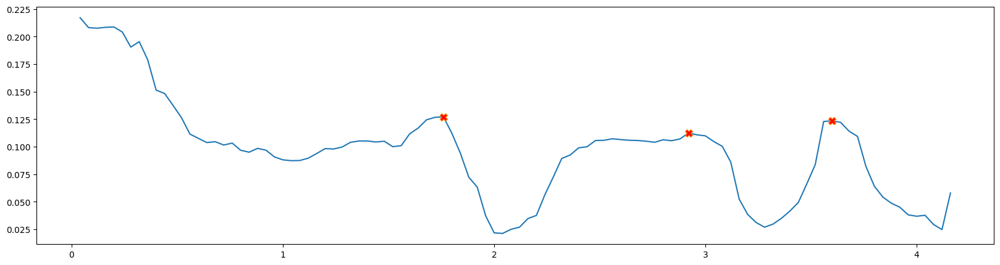

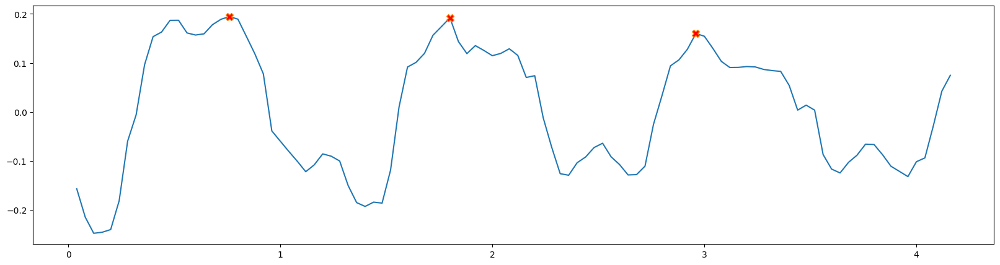

DETECTING GAIT___Foot lifting right


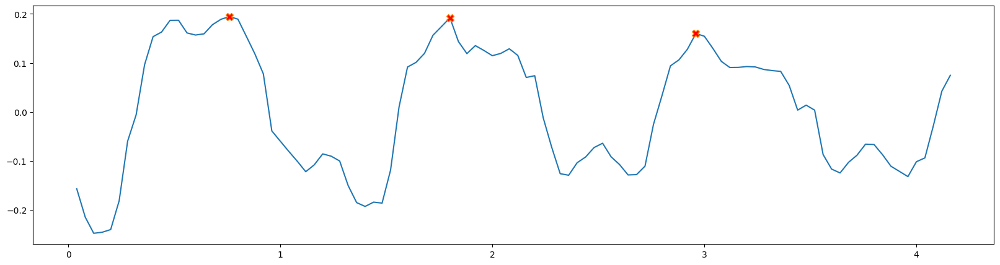

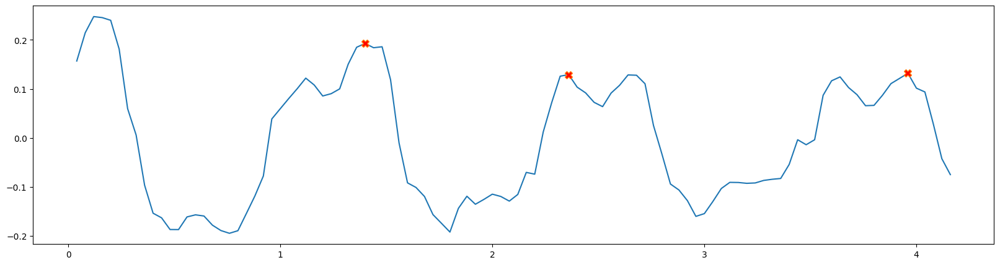

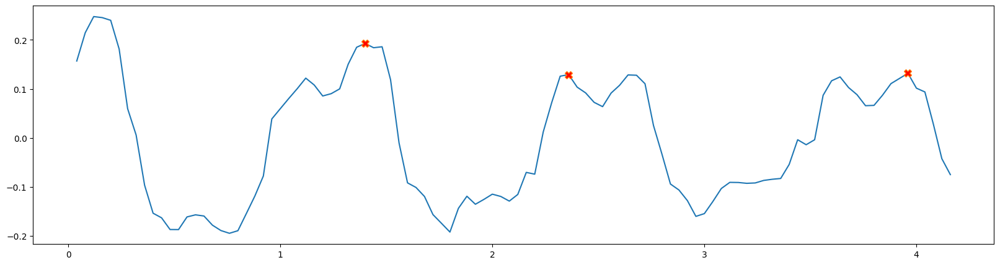

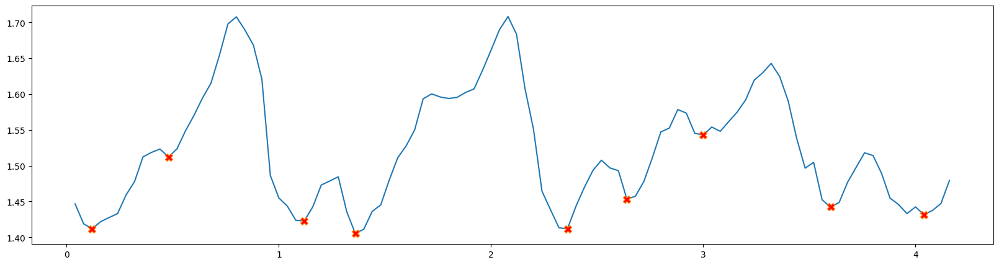

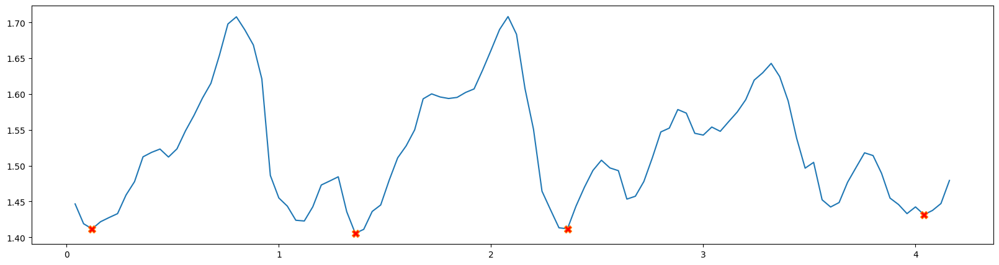

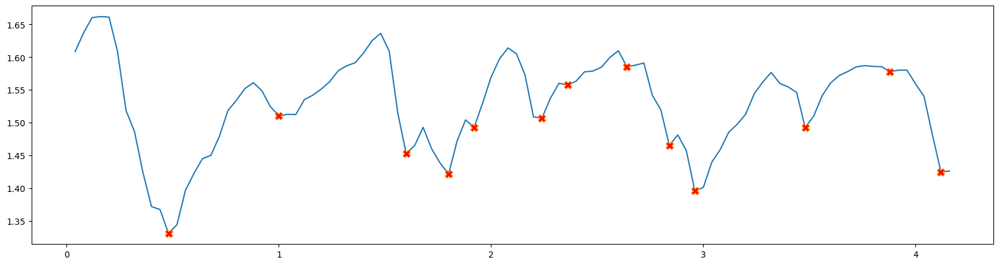

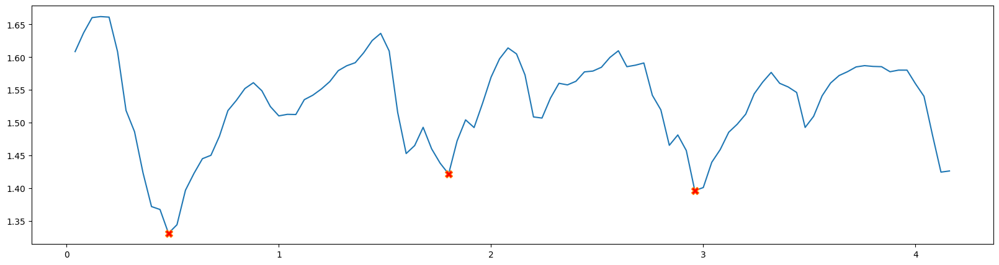

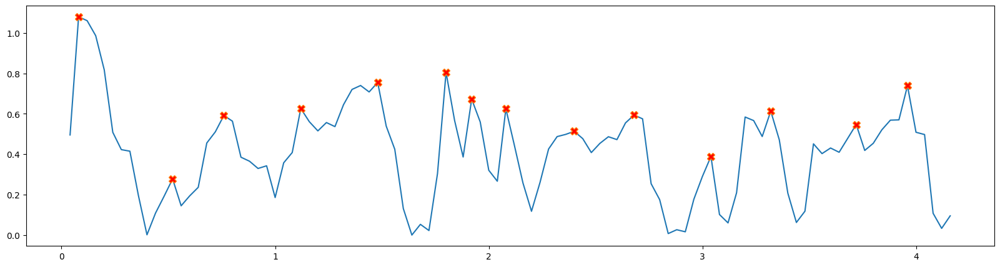

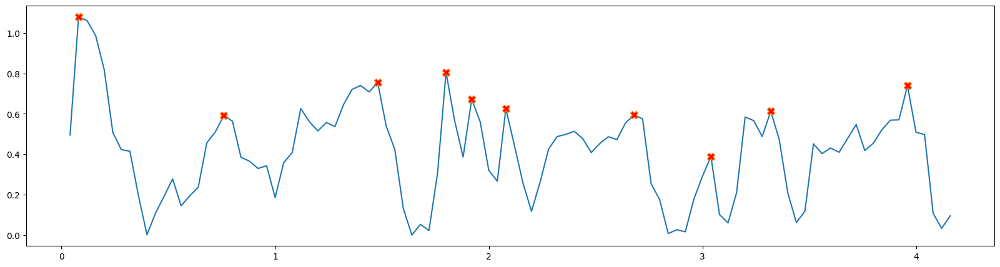

[34]
[20 26 39]
[43]
[18 36 44]
[34]
[20 26 39]
[43]
[18 36 44]
[58]
[46 52 62]
[72]
[44 47 51 66]
[58]
[46 52 62]
[72]
[44 47 51 66]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count  time       stl      hakr      hakl       flr       fll        po  \
0    0.0  0.76  0.717172  1.405653  1.421646  0.193220  0.192783  4.138378   
1    1.0  1.80  0.673963  1.411928  1.408992  0.175977  0.129145  6.188371   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  visi_po  \
0  0.127088  0.968658   0.982999    0.98928  0.965843  0.975158  0.99929   
1  0.112384  0.962032   0.977821    0.98869  0.971671  0.960350  0.99882   

    visi_sw  
0  0.975138  
1  0.955320  
front back udara back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.373795  2.794832  0.129236  0.348699 -0.348699   
1    0.066667    2.0  0.363533  2.824446  0.123190  0.3330

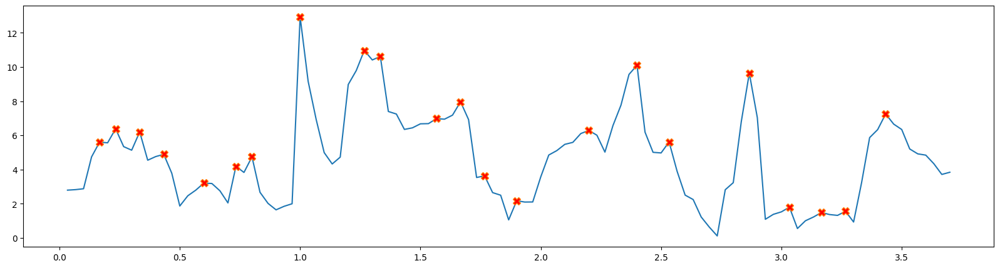

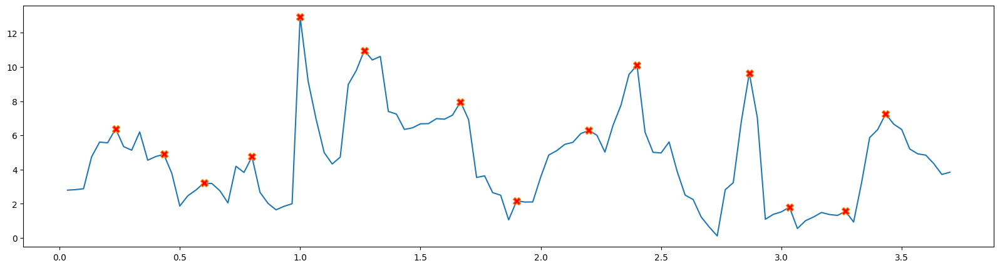

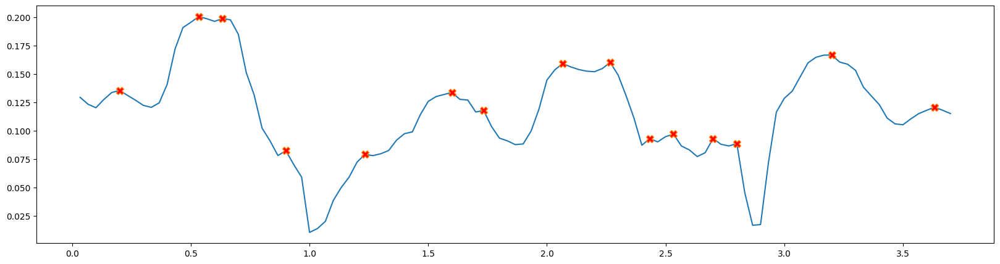

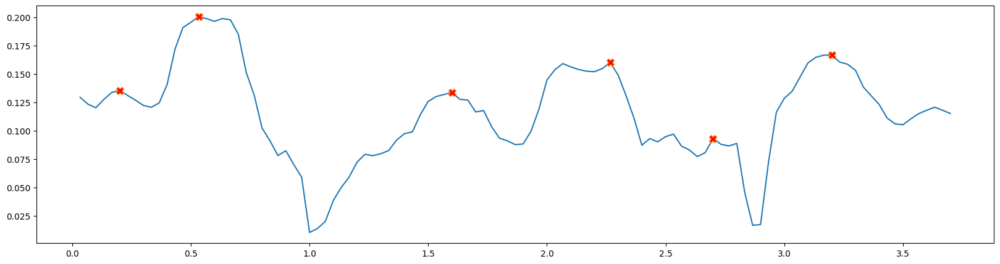

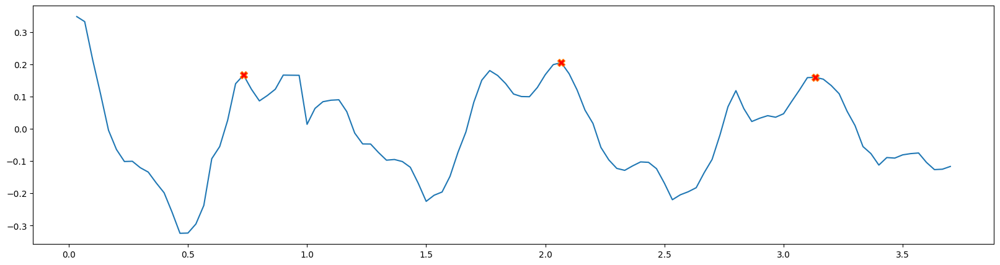

DETECTING GAIT___Foot lifting right


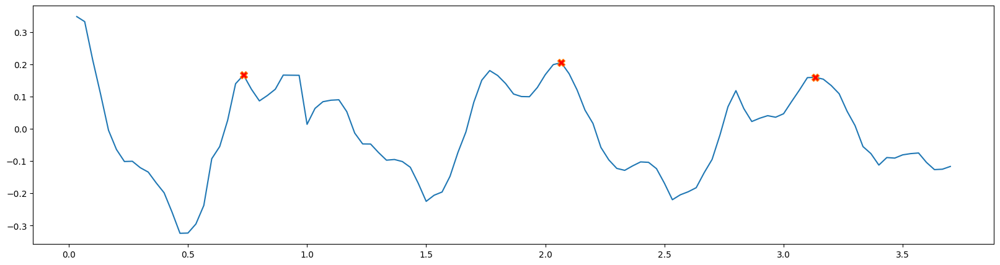

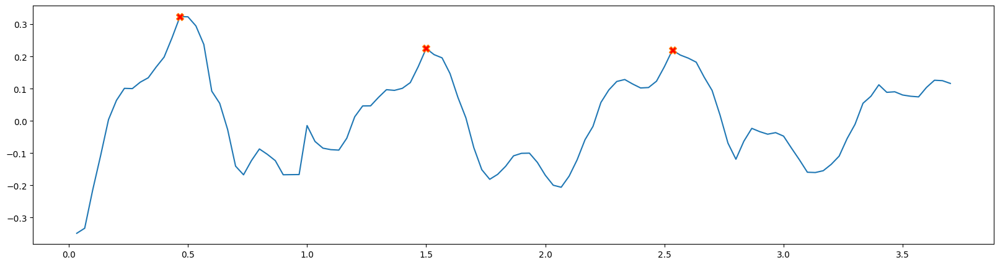

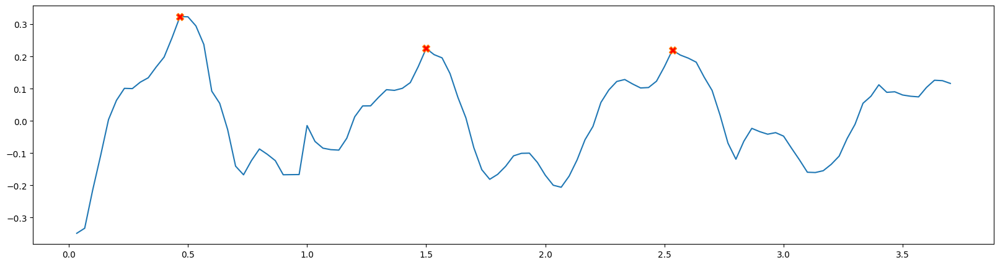

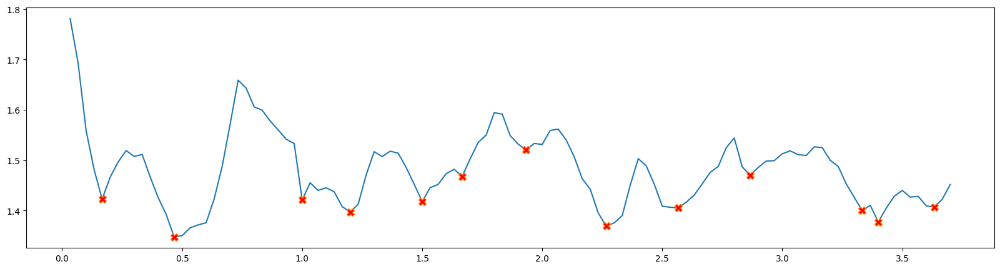

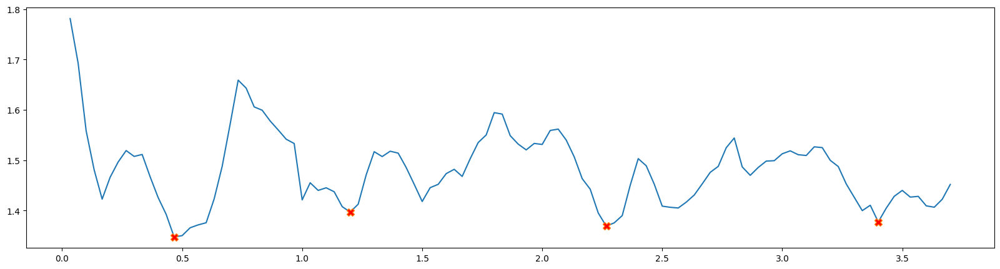

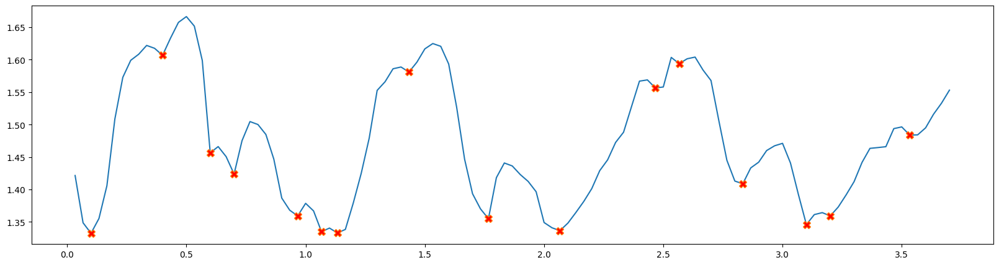

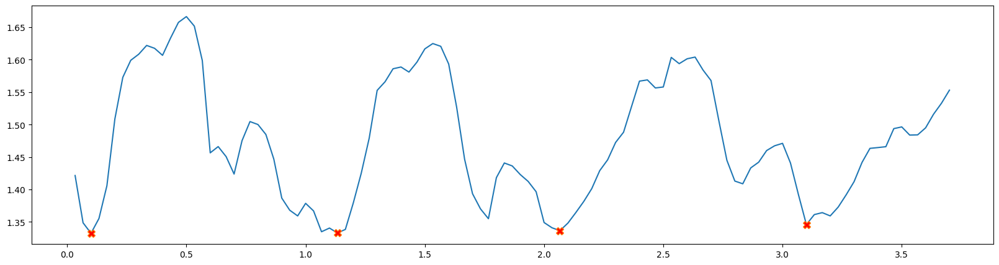

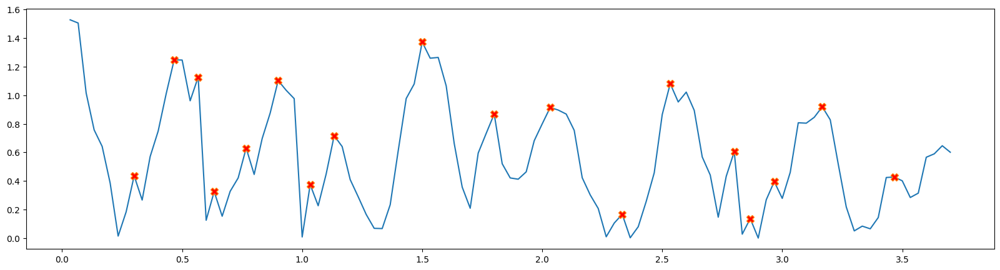

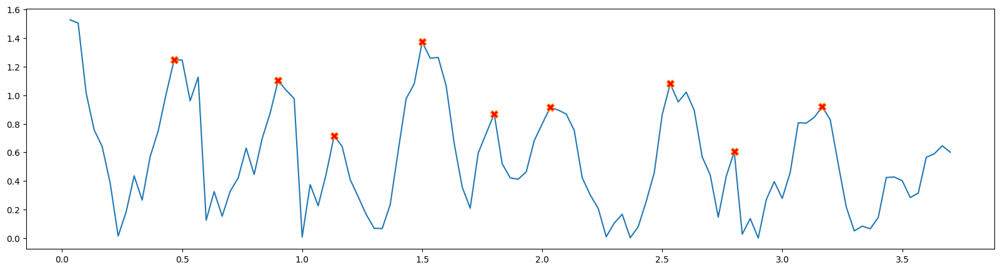

[44]
[23 29 37 49 56]
[47]
[26 33 44 53 60]
[44]
[23 29 37 49 56]
[47]
[26 33 44 53 60]
[75]
[65 71 85 90]
[67 80]
[75 83]
[75]
[65 71 85 90]
[67 80]
[75 83]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.733333  0.994794  1.396864  1.334830  0.186455  0.224889   
1    1.0  2.066667  0.842634  1.368904  1.341316  0.182942  0.219823   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  7.760057  0.133562  0.977227   0.987418   0.986542  0.979747  0.973130   
1  6.960101  0.126449  0.977038   0.992283   0.989638  0.979480  0.977364   

    visi_po   visi_sw  
0  0.999641  0.973745  
1  0.999446  0.976624  
front back anjalie back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.334790  8.500976  0.153938 -0.325768  0.325768   
1    0.066667    

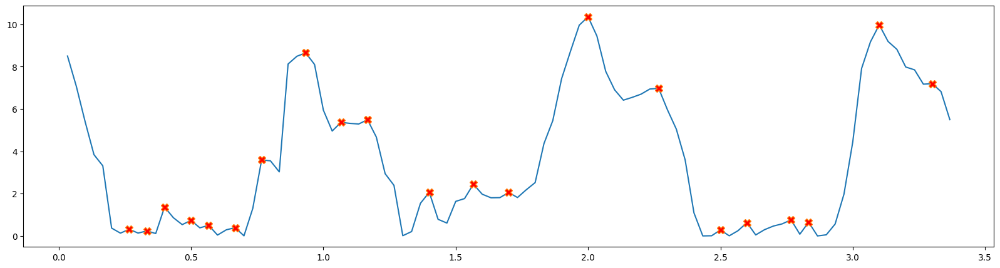

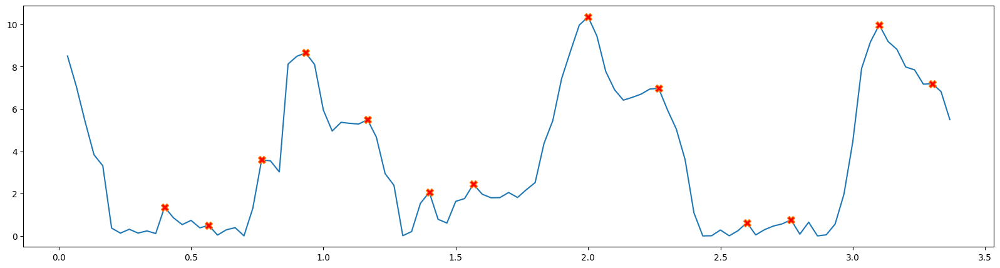

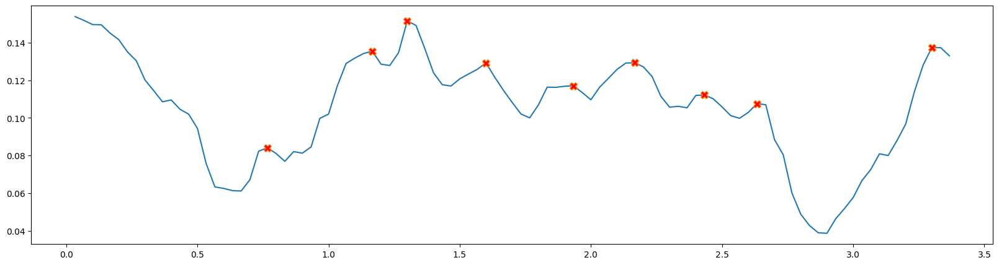

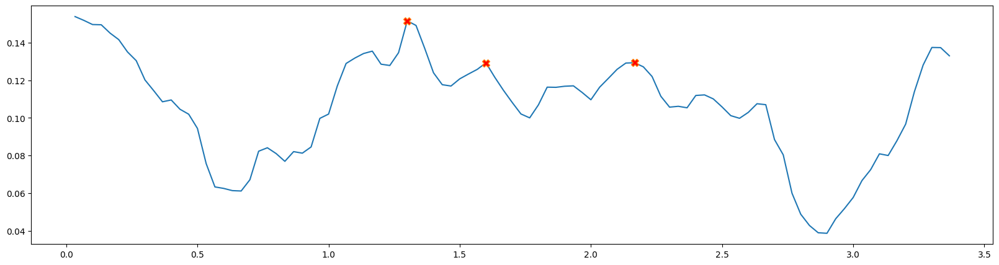

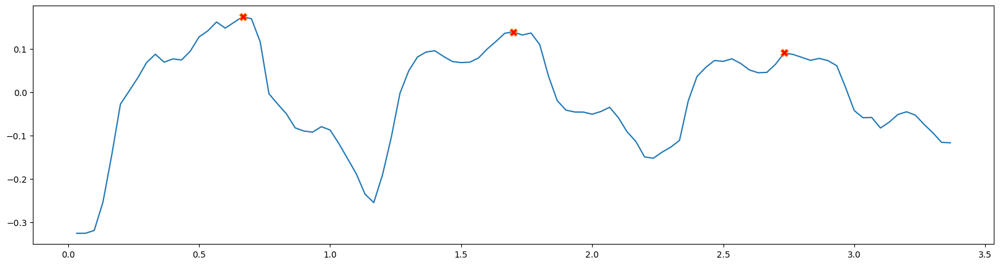

DETECTING GAIT___Foot lifting right


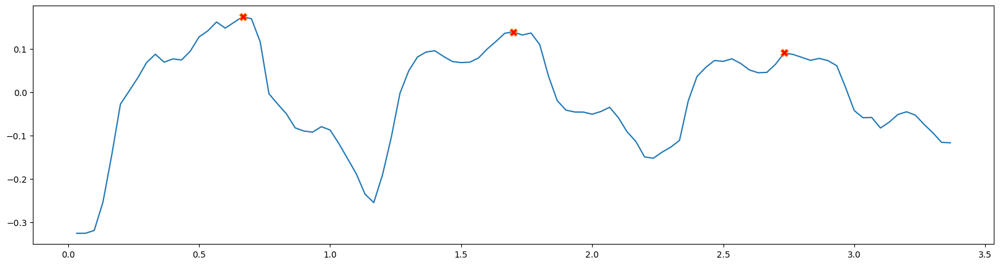

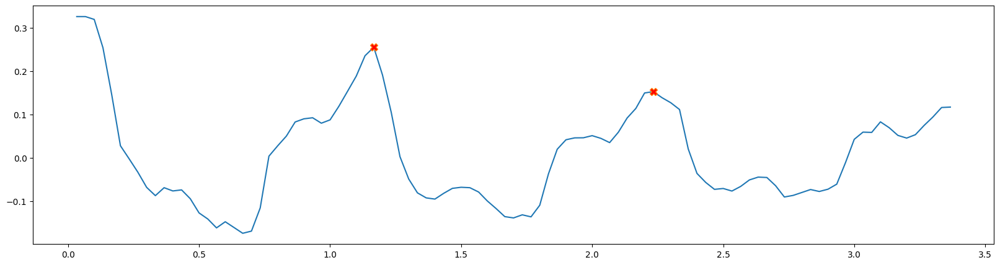

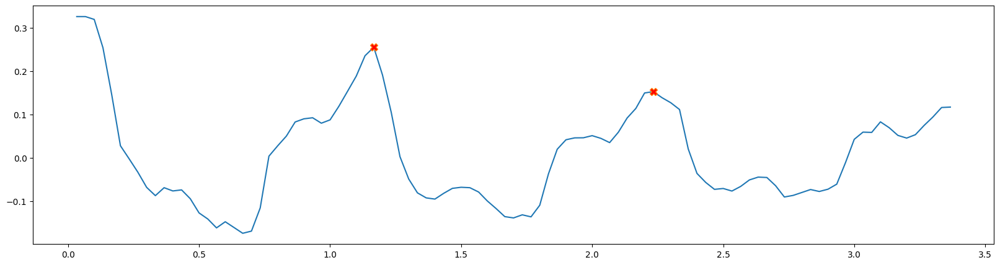

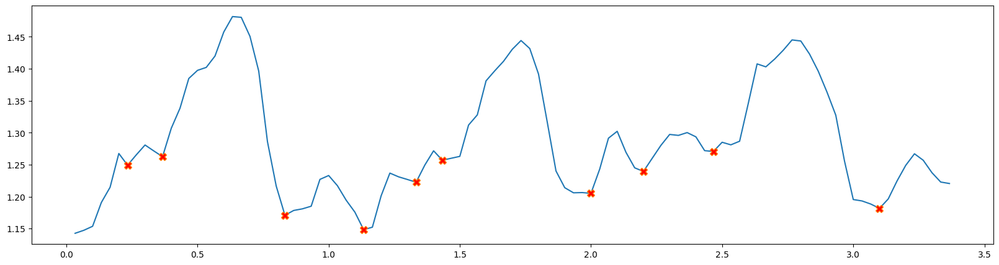

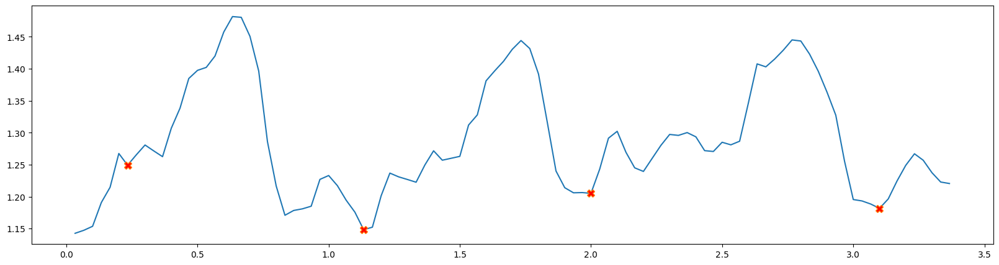

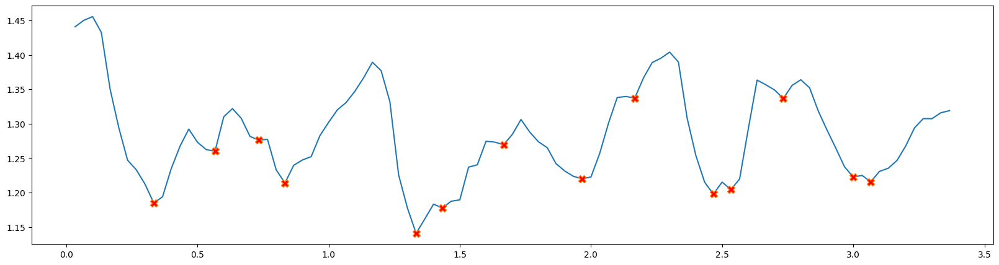

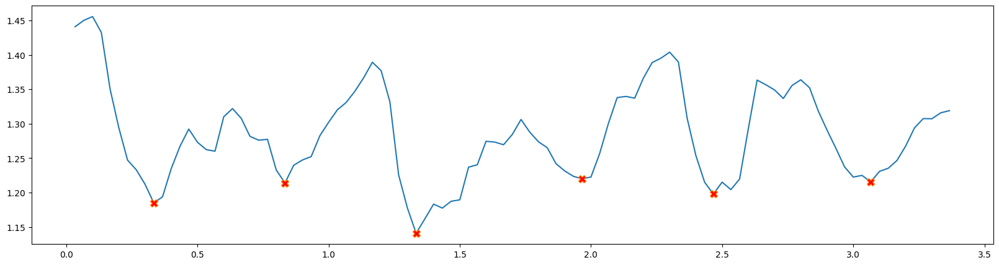

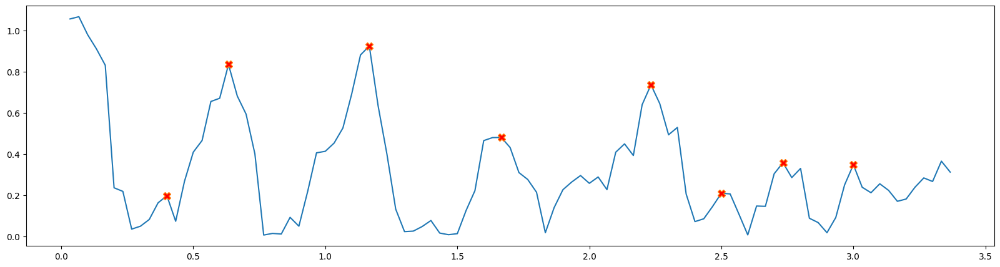

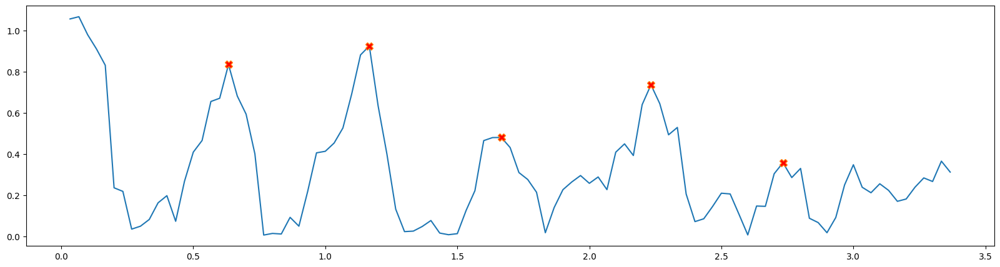

[34]
[22 27 34 41 46]
[38 47]
[34 49]
[34]
[22 27 34 41 46]
[38 47]
[34 49]
[66]
[59 67 77]
[64]
[66 81]
[66]
[59 67 77]
[64]
[66 81]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.666667  0.702689  1.148212  1.177498  0.156386  0.254950   
1    1.0  1.700000  0.546725  1.205102  1.208956  0.114521  0.152694   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  4.449442  0.140505  0.985070   0.990930   0.990958  0.981437  0.984809   
1  5.986171  0.129375  0.986983   0.991815   0.994425  0.986712  0.985962   

    visi_po   visi_sw  
0  0.999787  0.986747  
1  0.999708  0.987163  
front back bimsara back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.353284  3.310709  0.047310  0.046401 -0.046401   
1    0.066667    2.0  0.356086  3.968776 

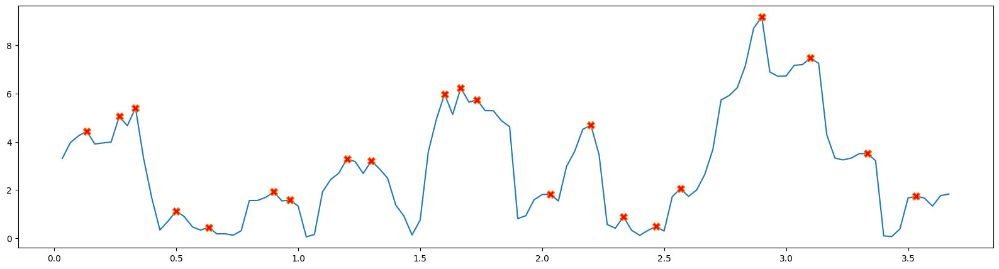

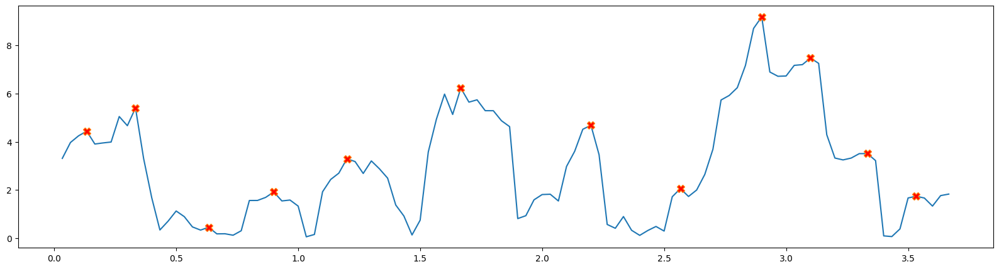

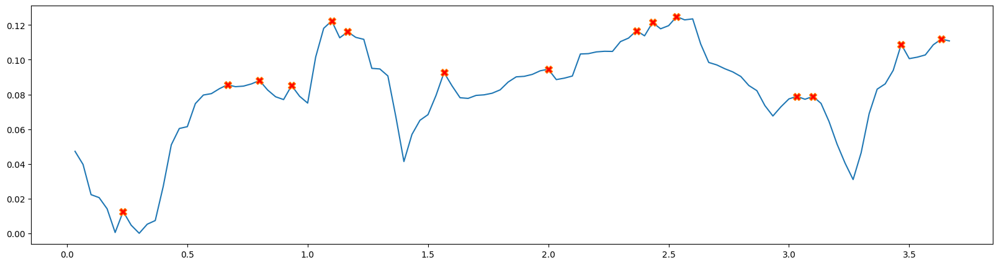

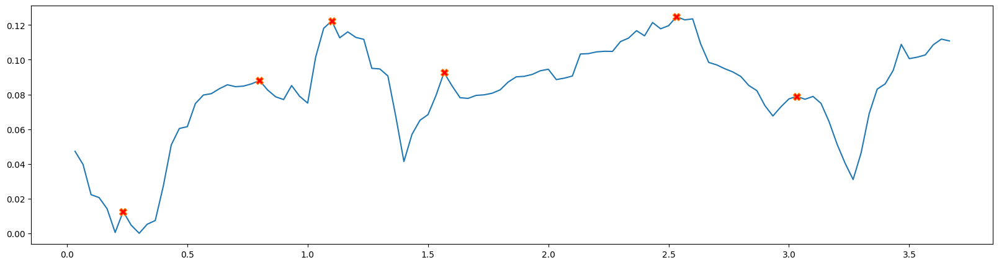

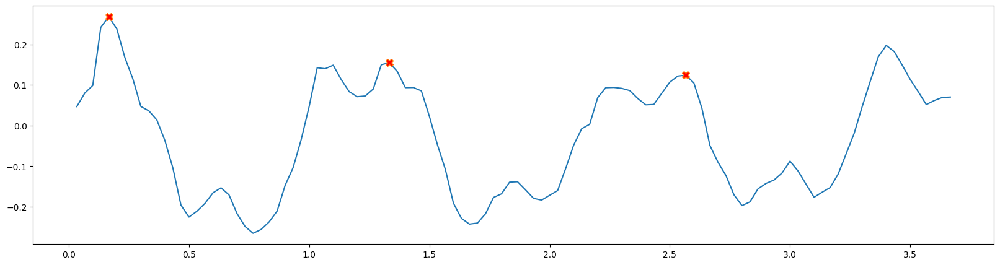

DETECTING GAIT___Foot lifting right


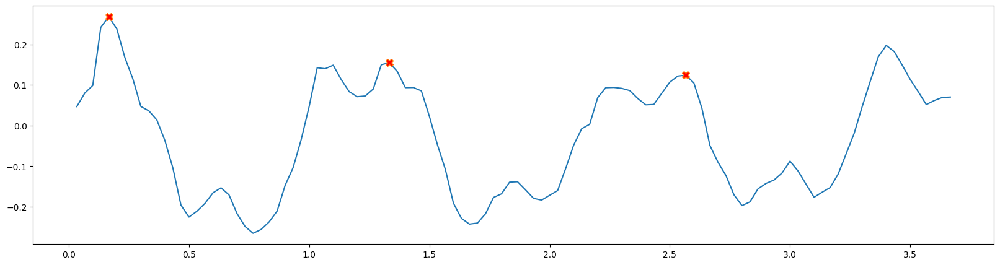

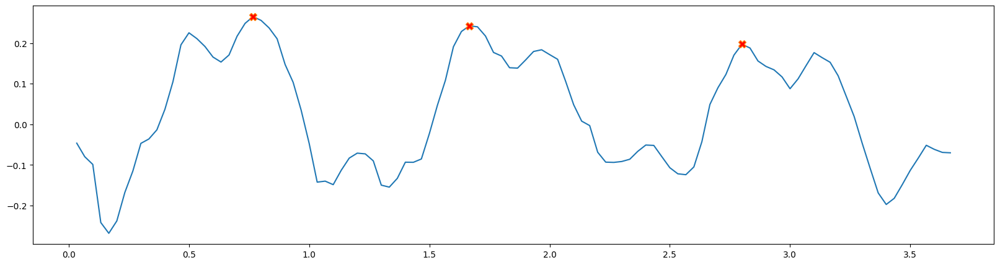

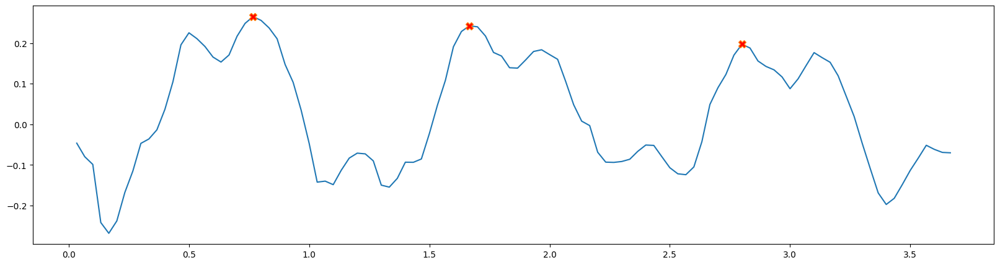

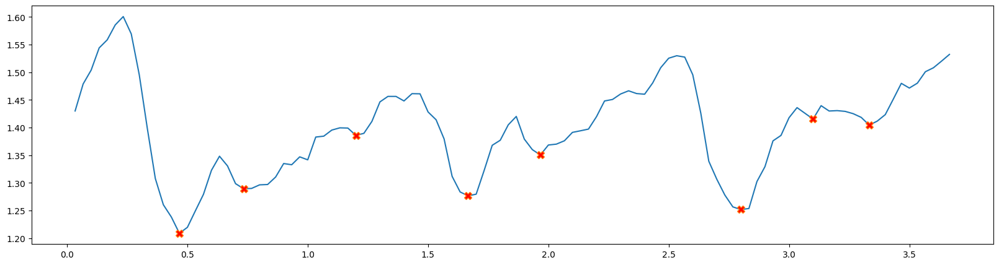

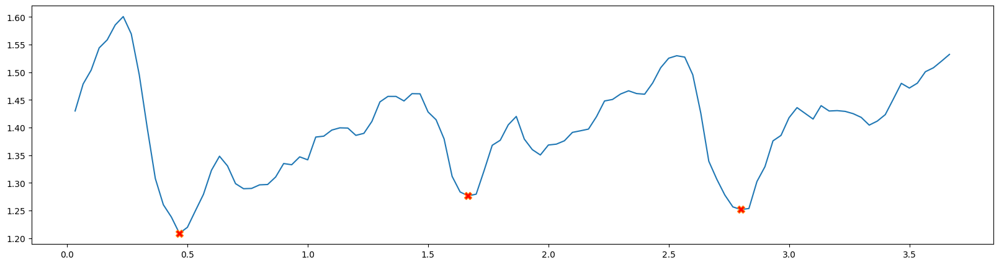

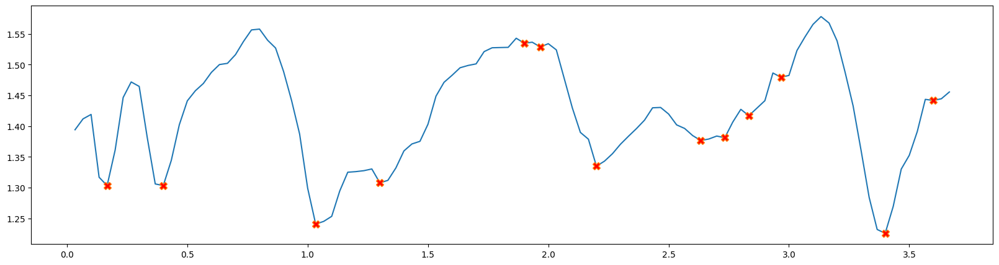

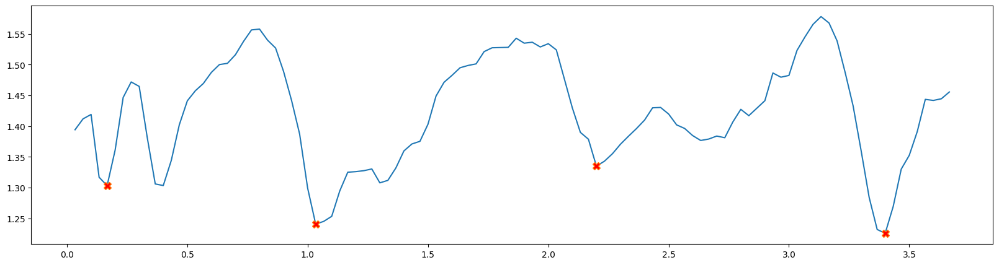

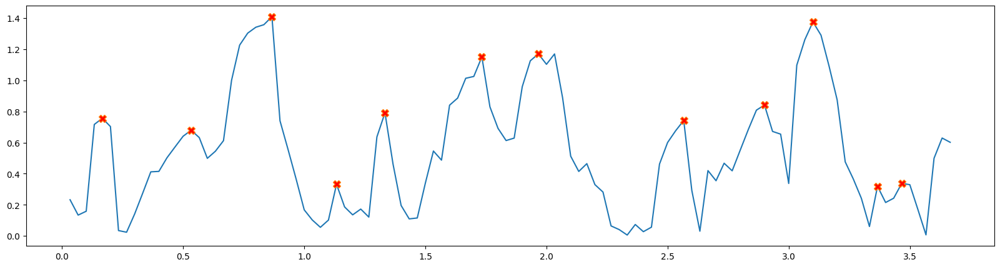

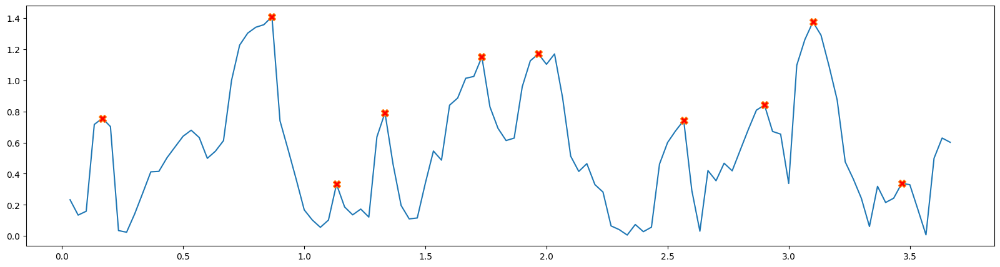

[22]
[ 9 18 26 35]
[ 6 23 32]
[ 4 25 33 39]
[22]
[ 9 18 26 35]
[ 6 23 32]
[ 4 25 33 39]
[49]
[49 65 76]
[46 75]
[39 51 58 76]
[49]
[49 65 76]
[46 75]
[39 51 58 76]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.166667  0.822411  1.208719  1.271878  0.211580  0.265511   
1    1.0  1.333333  0.963929  1.276476  1.334820  0.139399  0.242880   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  2.767326  0.074358  0.952282   0.960584   0.966228  0.936087  0.956091   
1  4.322879  0.108712  0.977425   0.985530   0.993286  0.979105  0.977281   

    visi_po   visi_sw  
0  0.999110  0.942824  
1  0.999288  0.977148  
front back botheju back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.356710  0.011160  0.116132 -0.304834  0.304834   
1    0.0666

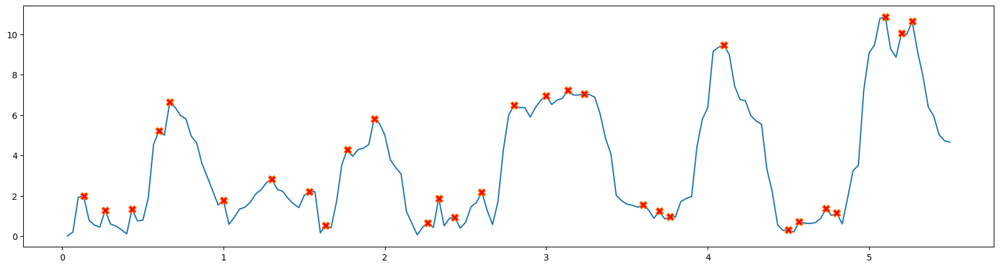

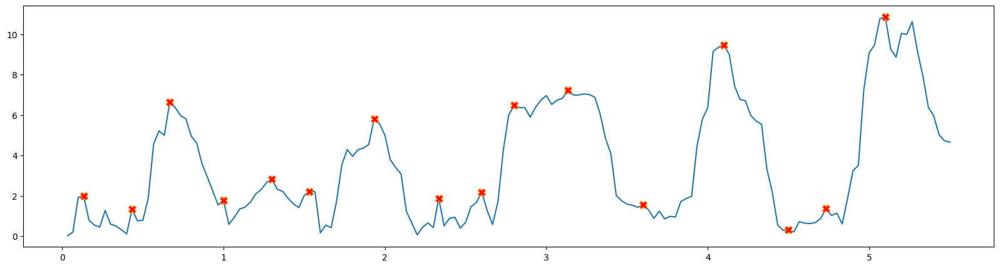

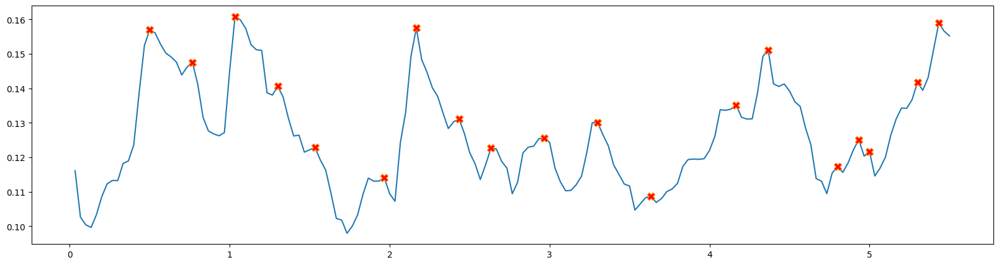

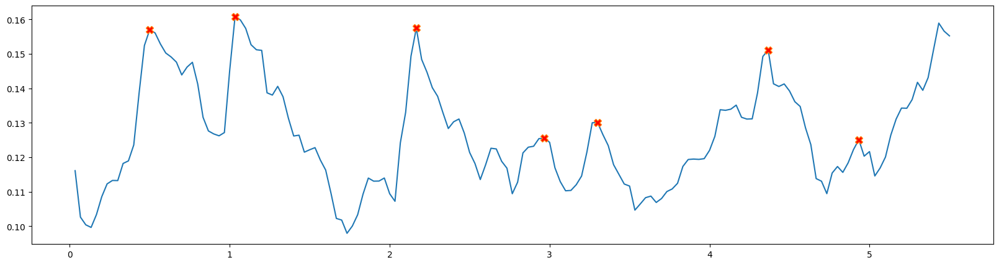

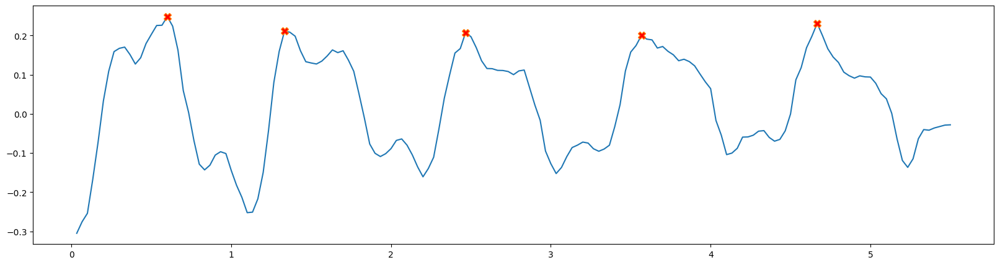

DETECTING GAIT___Foot lifting right


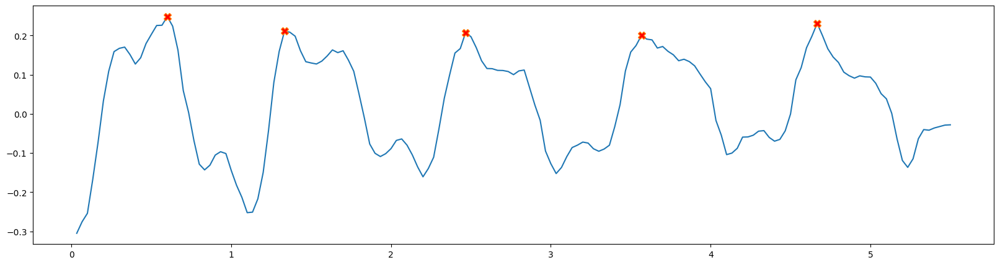

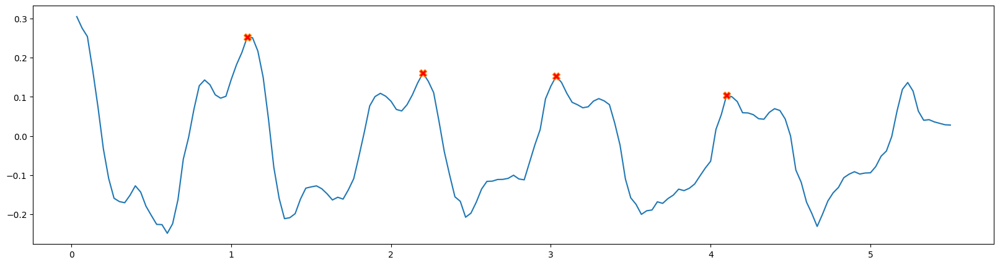

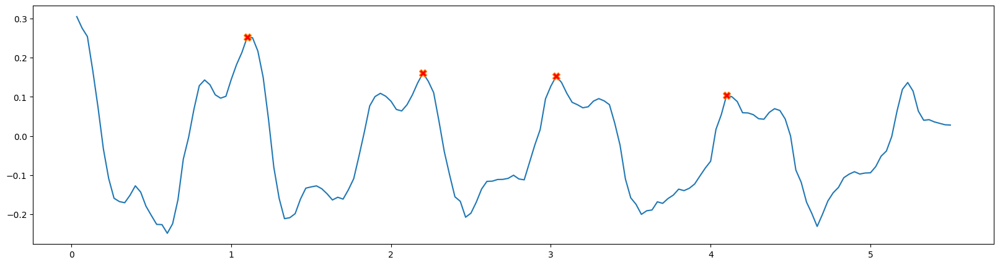

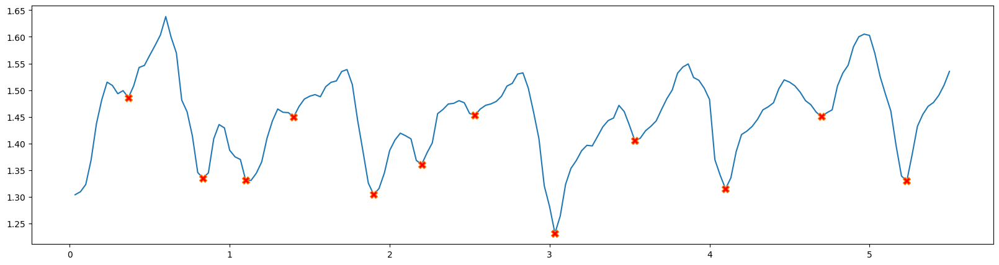

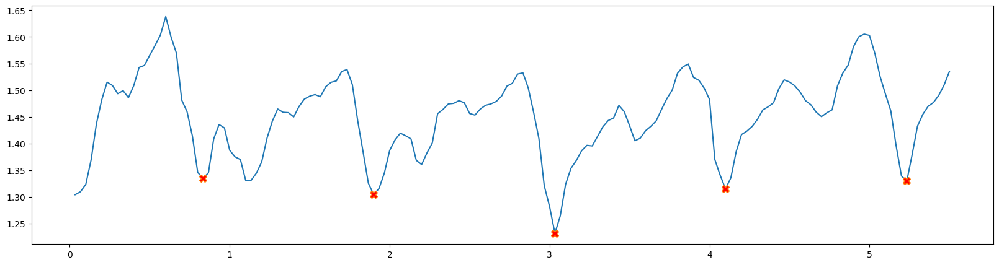

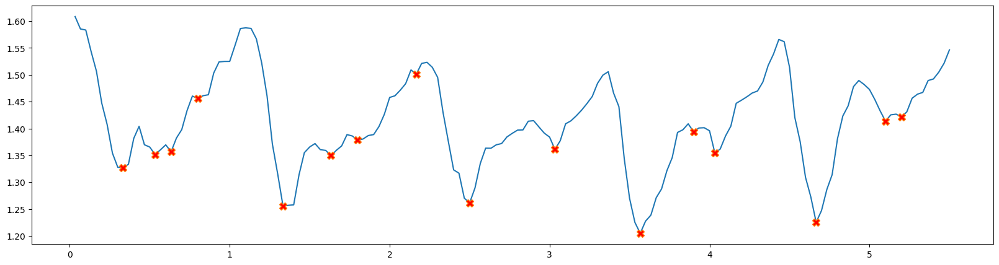

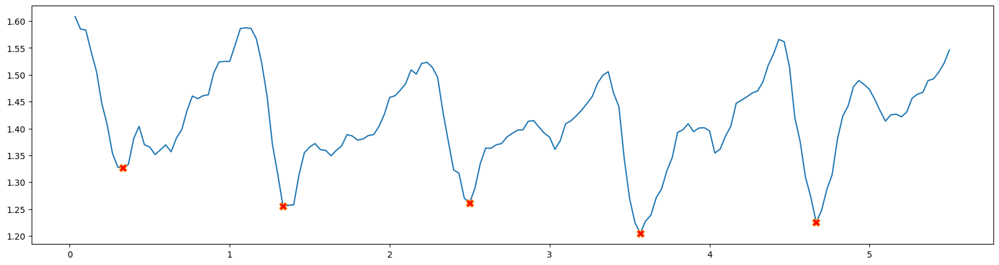

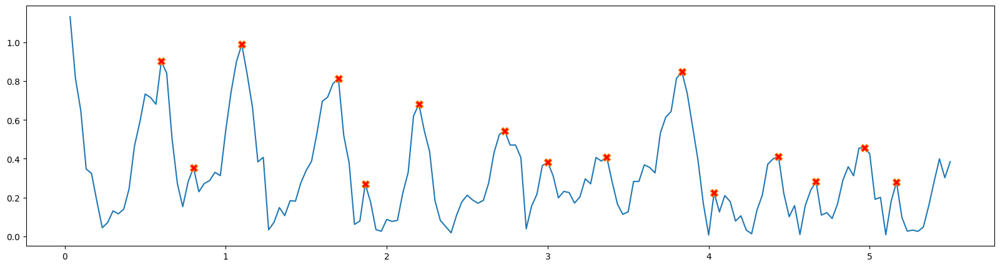

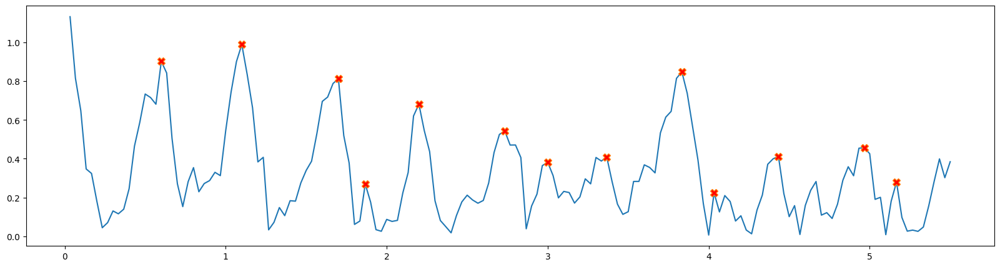

[32]
[19 29 38]
[30]
[17 32]
[32]
[19 29 38]
[30]
[17 32]
[65]
[45 57 69]
[64]
[50 55 65]
[65]
[45 57 69]
[64]
[50 55 65]
[90]
[77 83 93]
[88 98]
[ 81  89 100]
[90]
[77 83 93]
[88 98]
[ 81  89 100]
[122]
[107 122 134]
[130]
[114 120 132]
[122]
[107 122 134]
[130]
[114 120 132]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
0 2
1 2
2 2
3 2
4 2
5 2
6 2
7 2
8 2
9 2
10 2
11 2
12 2
13 2
14 2
0 3
1 3
2 3
3 3
4 3
5 3
6 3
7 3
8 3
9 3
10 3
11 3
12 3
13 3
14 3
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.600000  0.946411  1.334611  1.255466  0.229724  0.252177   
1    1.0  1.333333  0.587946  1.303857  1.255466  0.209187  0.160623   
2    2.0  2.466667  0.444855  1.231119  1.233145  0.203694  0.152346   
3    3.0  3.566667  0.494987  1.314672  1.215132  0.215477  0.104017   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  3.732905  0.160844  0

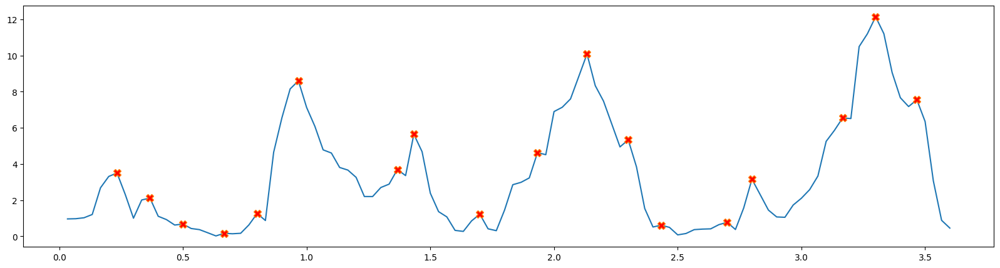

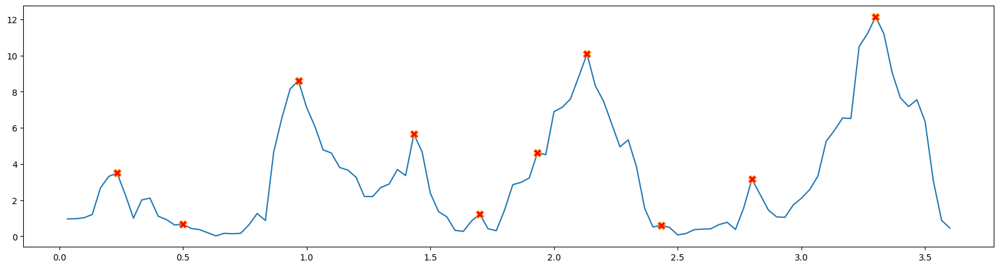

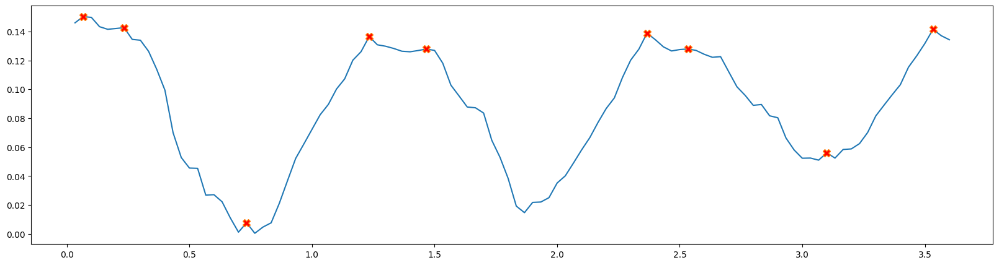

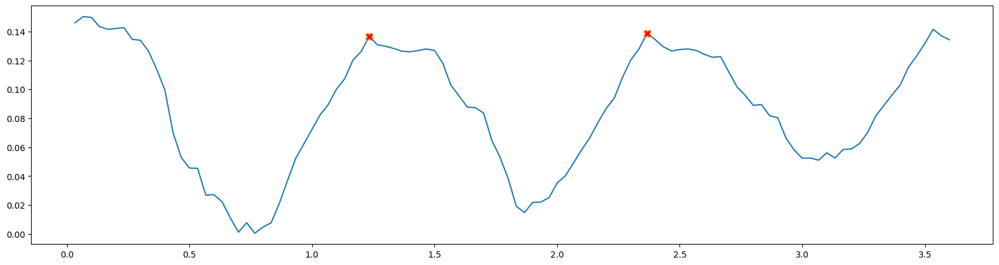

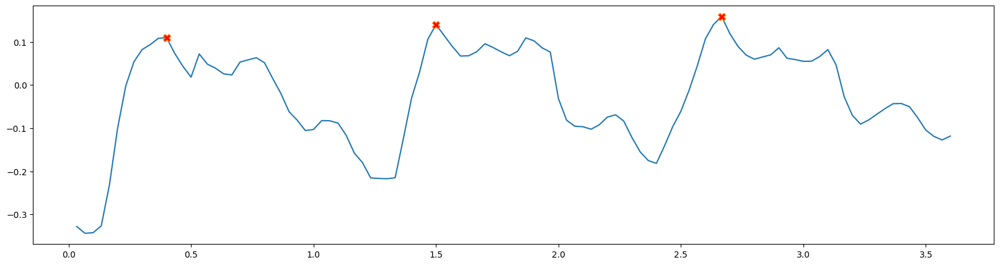

DETECTING GAIT___Foot lifting right


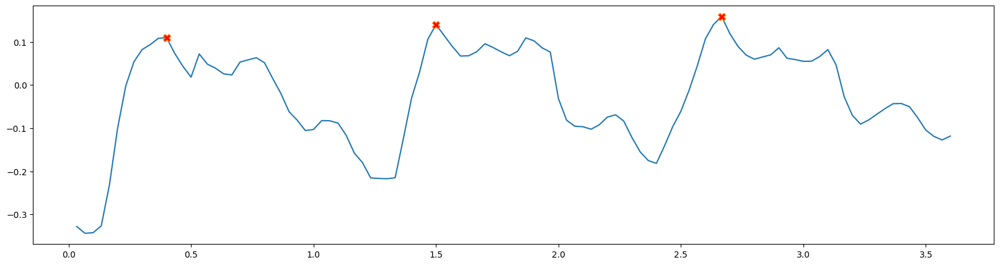

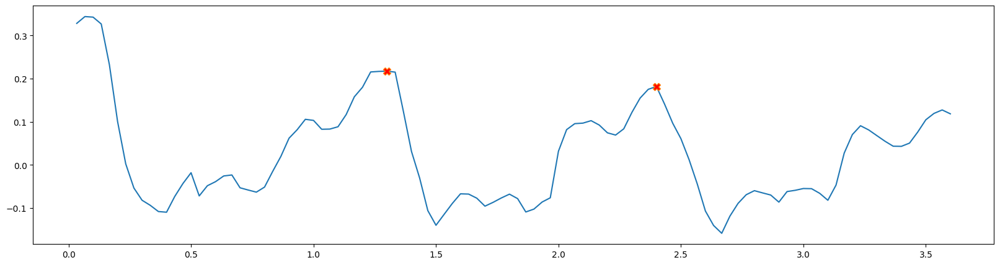

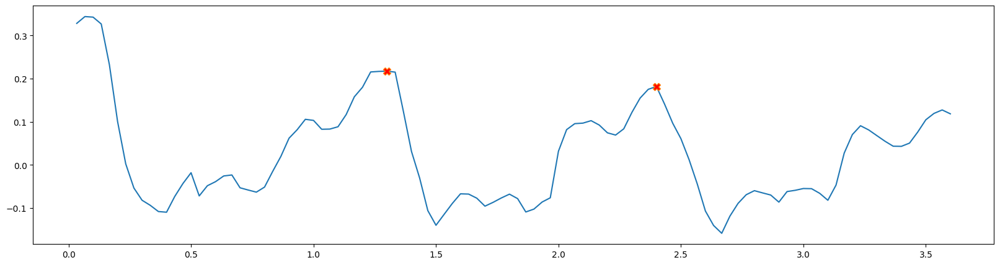

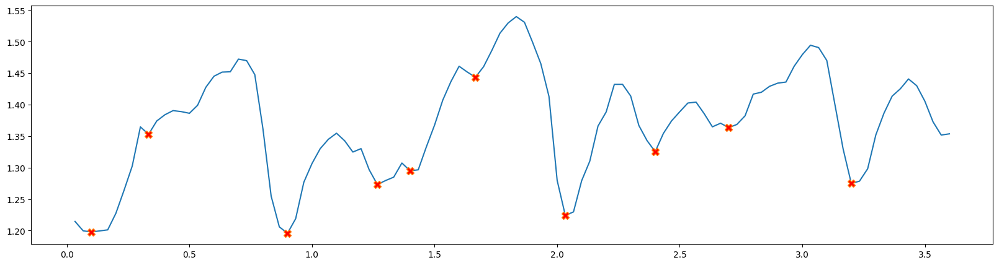

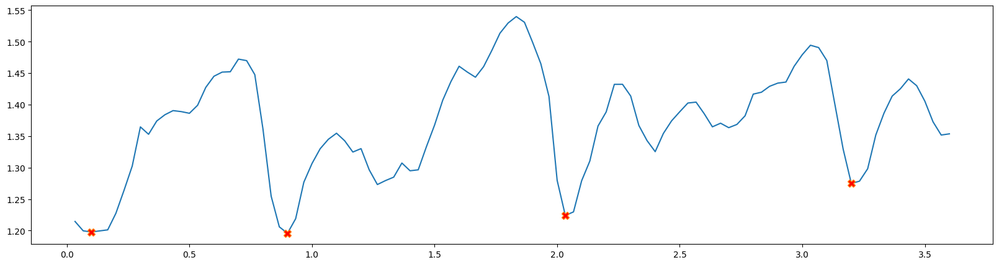

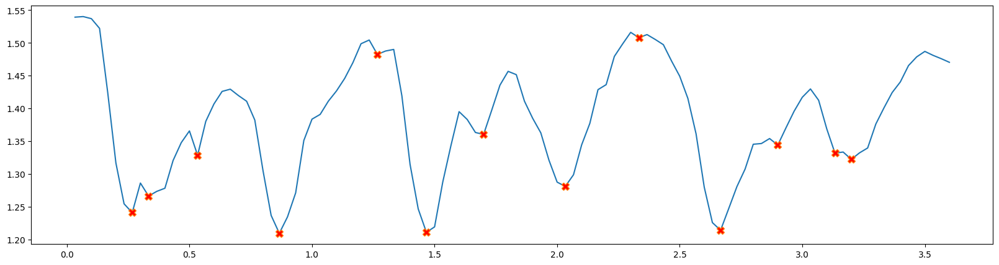

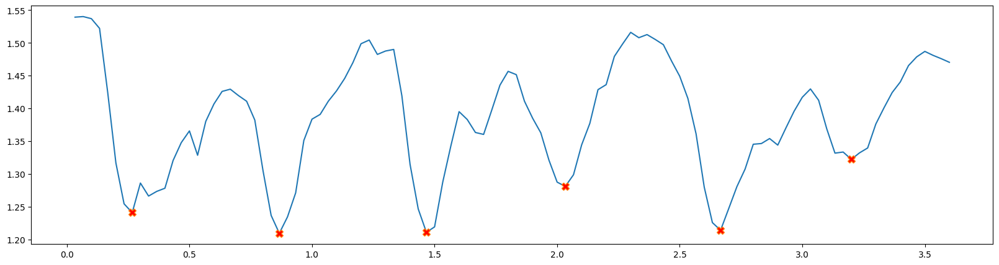

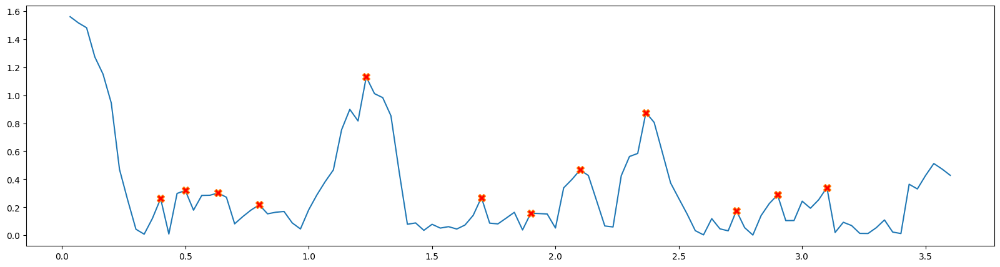

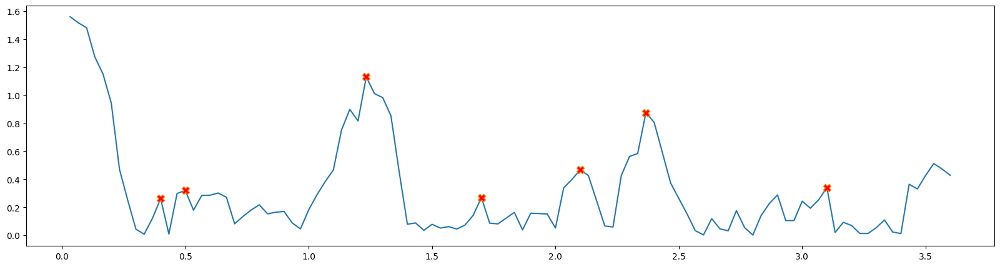

[38]
[14 28 42]
[36]
[11 14 36]
[38]
[14 28 42]
[36]
[11 14 36]
[71]
[50 57 63 72]
[70]
[50 62 70]
[71]
[50 57 63 72]
[70]
[50 62 70]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count  time       stl      hakr      hakl       flr       fll        po  \
0    0.0   0.4  0.570766  1.195761  1.210143  0.124973  0.217426  4.976189   
1    1.0   1.5  0.537444  1.224104  1.247539  0.149415  0.181831  4.140647   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll   visi_po  \
0  0.136526  0.964702   0.967215   0.988341  0.970190  0.974696  0.999472   
1  0.138846  0.975765   0.980850   0.990351  0.981924  0.978798  0.999418   

    visi_sw  
0  0.976415  
1  0.978676  
front back chamod back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.395405  6.503744  0.104642 -0.394176  0.394176   
1    0.066667    2.0  0.388147  6.871180  0.106210 -0.

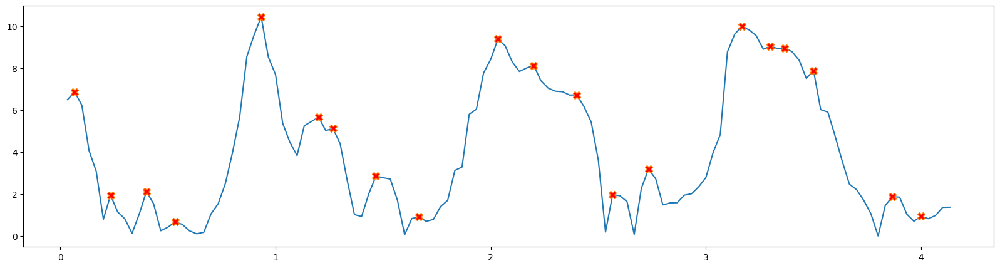

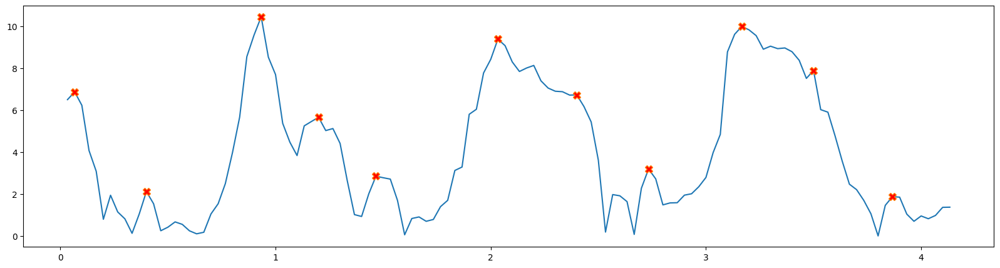

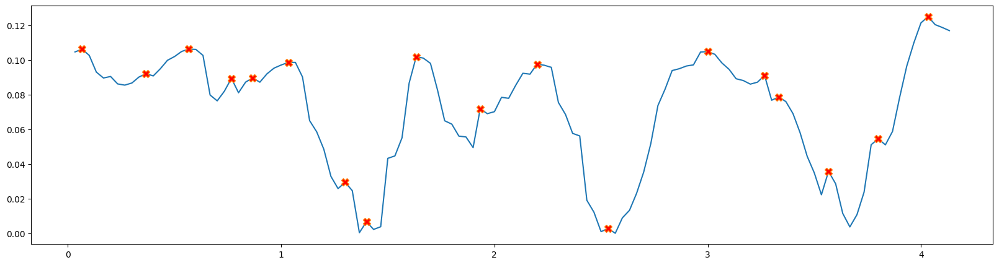

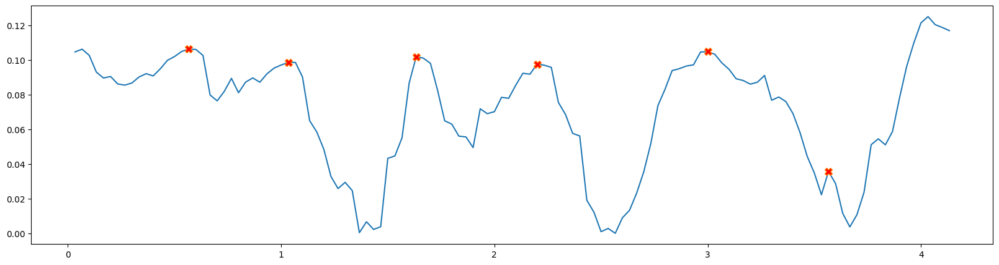

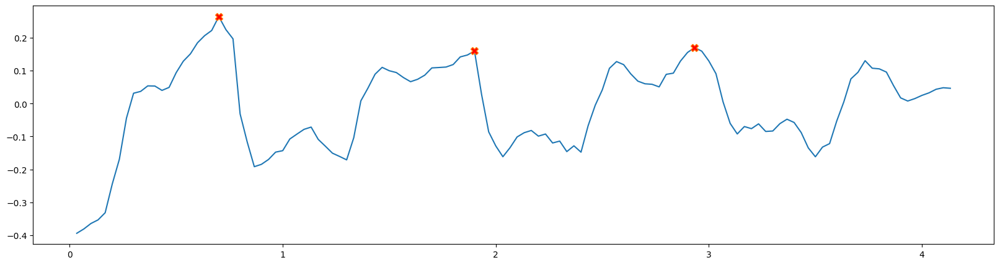

DETECTING GAIT___Foot lifting right


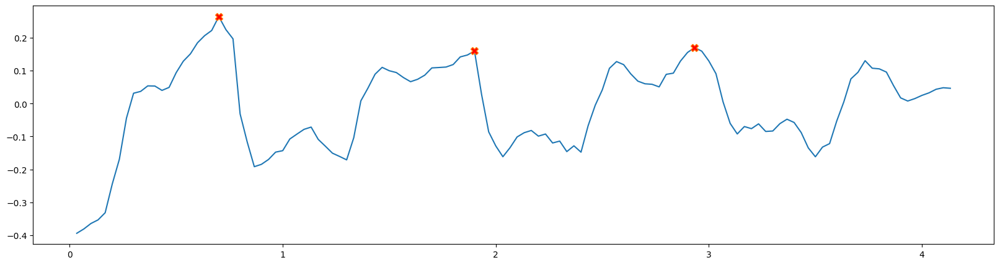

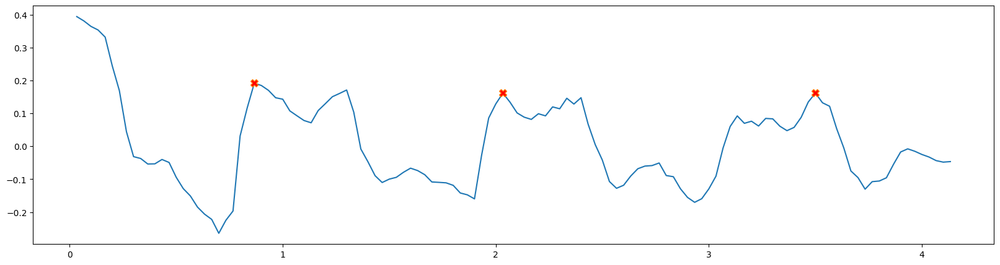

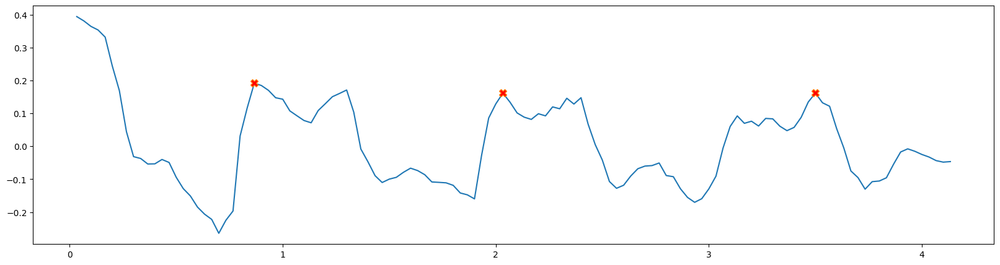

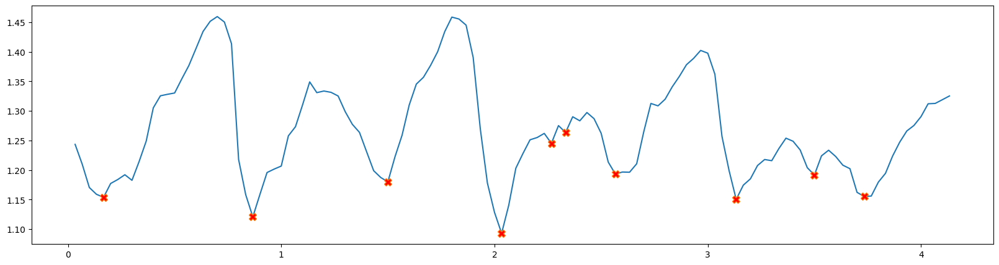

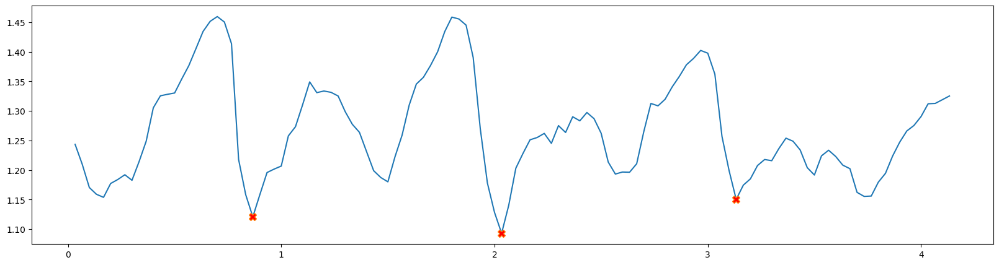

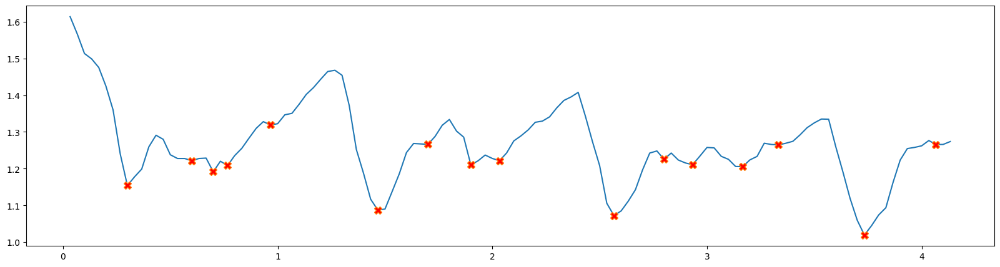

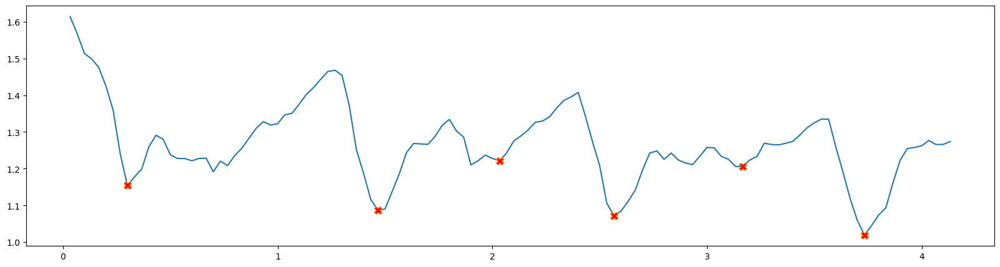

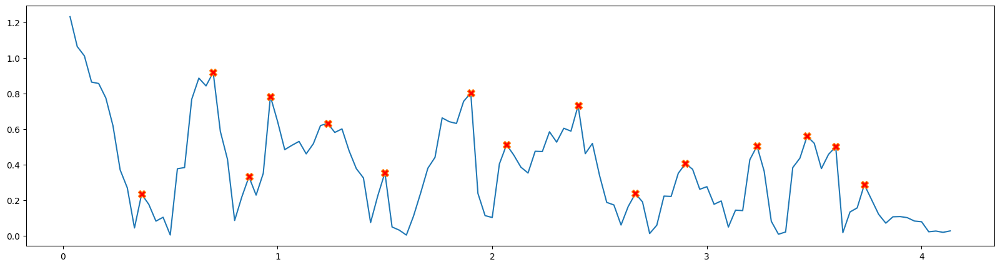

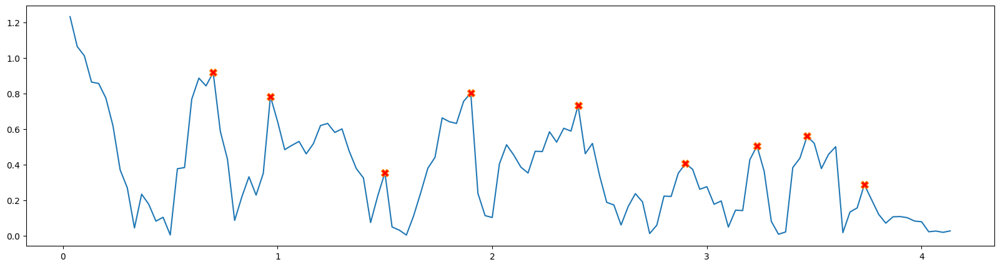

[25]
[27 35 43]
[30 48]
[20 28 44 56]
[25]
[27 35 43]
[30 48]
[20 28 44 56]
[60]
[60 71 81]
[65]
[56 71 86]
[60]
[60 71 81]
[65]
[56 71 86]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count  time       stl      hakr      hakl       flr       fll        po  \
0    0.0   0.7  0.714226  1.121016  1.087278  0.212096  0.191782  6.323401   
1    1.0   1.9  0.646123  1.093184  1.146995  0.165024  0.161484  6.437958   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll   visi_po  \
0  0.100242  0.961238   0.984476   0.985098  0.958987  0.957192  0.999730   
1  0.097624  0.970070   0.988498   0.987012  0.966827  0.973278  0.999705   

    visi_sw  
0  0.971068  
1  0.980733  
front back yohan back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.349019  2.805901  0.071310  0.170192 -0.170192   
1    0.066667    2.0  0.346741  2.800203  0.06596

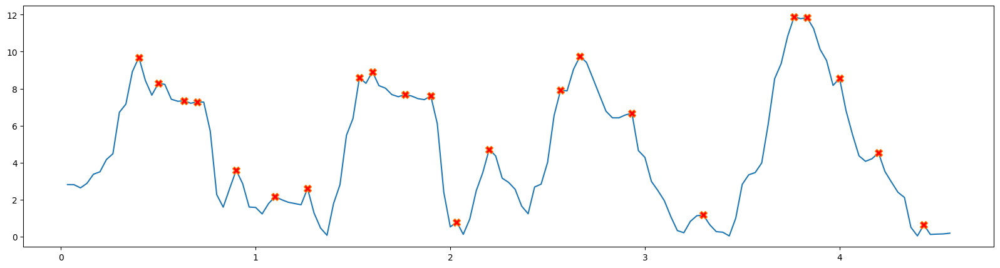

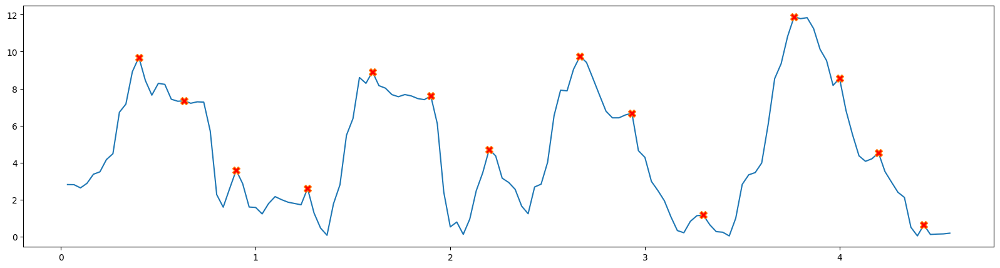

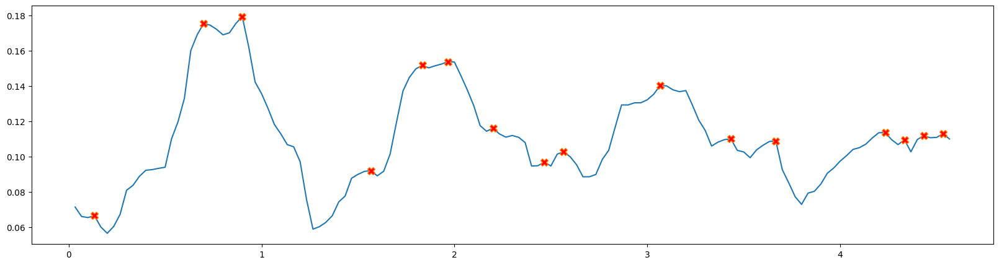

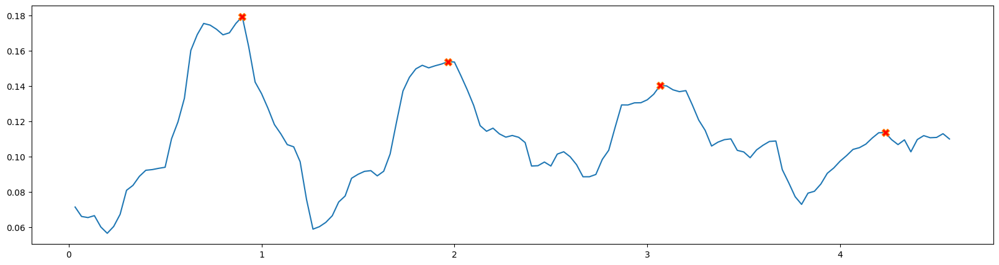

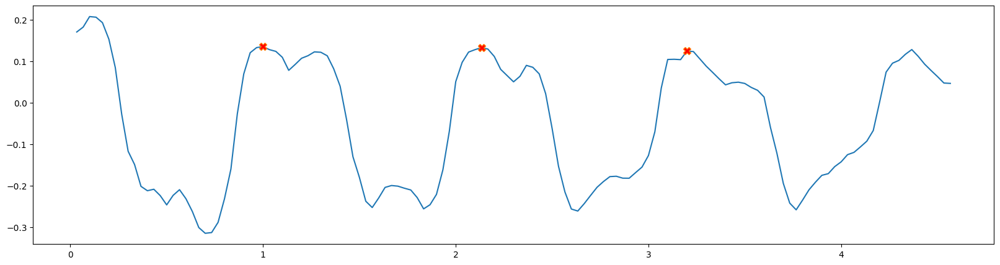

DETECTING GAIT___Foot lifting right


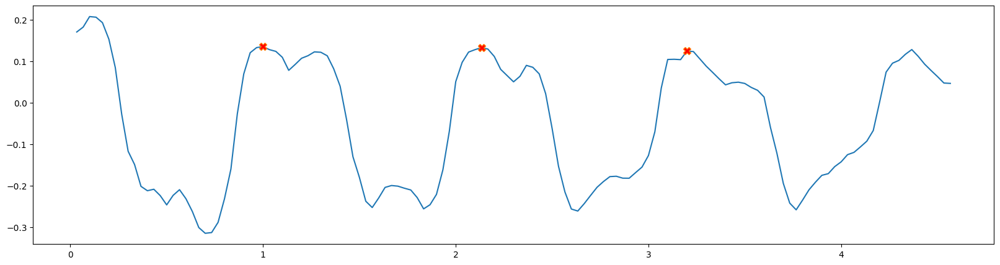

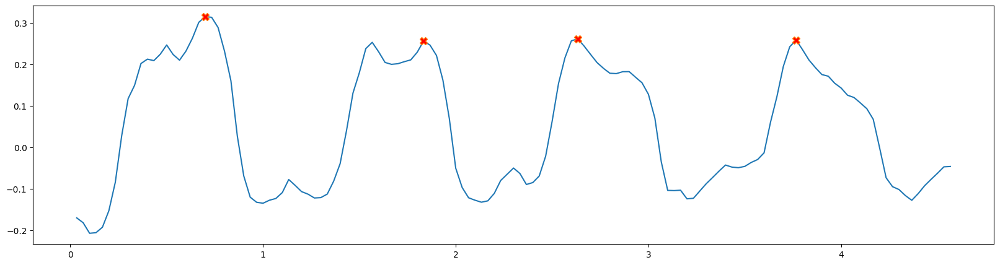

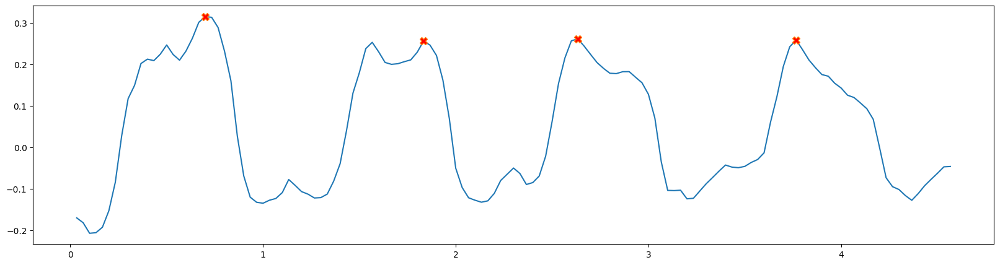

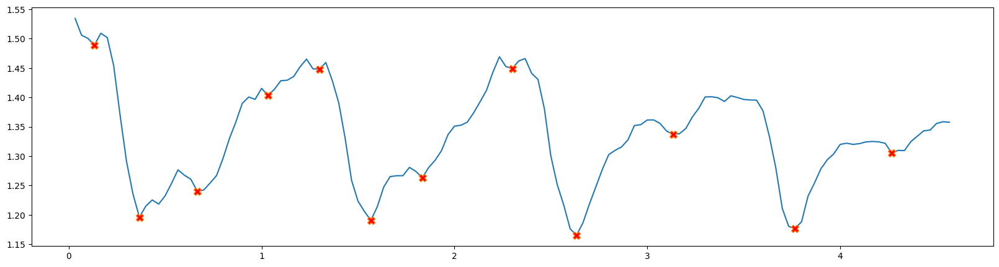

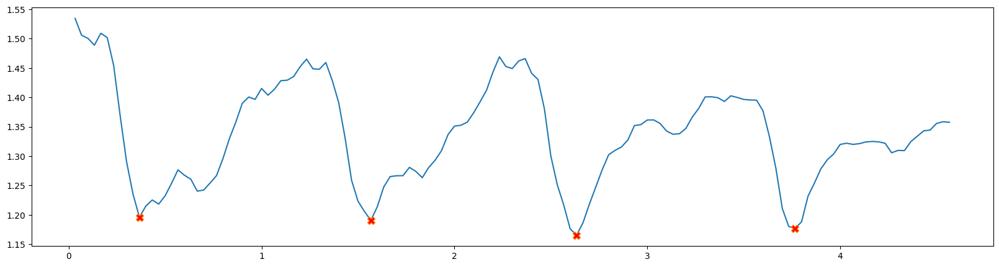

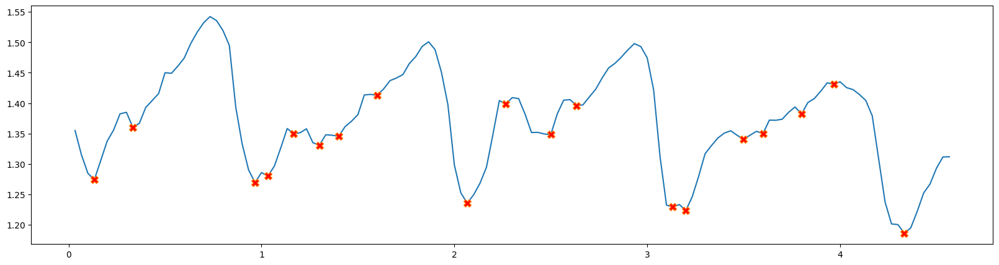

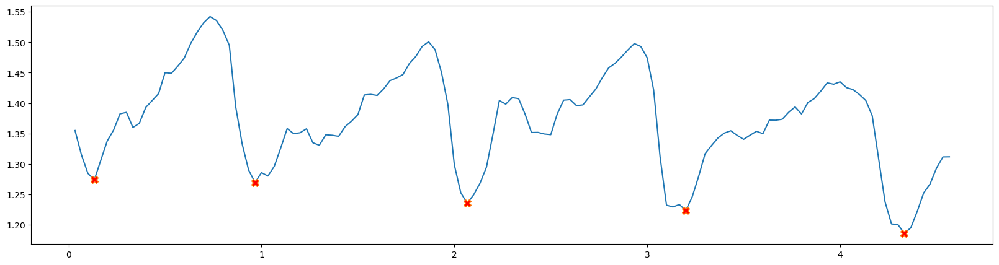

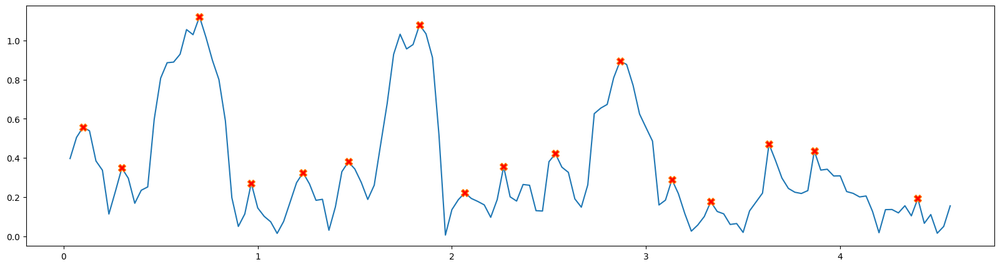

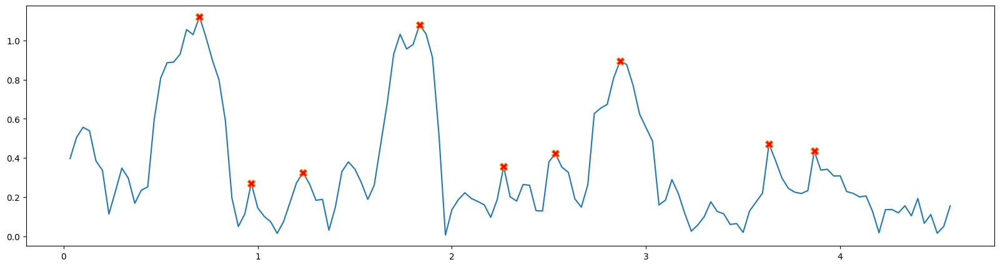

[54]
[37 47 56]
[58]
[36 54]
[54]
[37 47 56]
[58]
[36 54]
[78]
[65 79 87]
[91]
[67 75 85]
[78]
[65 79 87]
[91]
[67 75 85]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  1.000000  0.702342  1.190384  1.235578  0.133655  0.255755   
1    1.0  2.133333  0.557622  1.165032  1.223378  0.128367  0.260967   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  6.370215  0.153747  0.986497   0.992318   0.996366  0.989397  0.987539   
1  7.043094  0.140223  0.987982   0.992265   0.996111  0.989602  0.988130   

    visi_po   visi_sw  
0  0.999568  0.990243  
1  0.999699  0.988276  
front back dasith back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.359316  2.064670  0.111476  0.440327 -0.440327   
1    0.066667    2.0  0.355514  0.635940  0.104692  0.

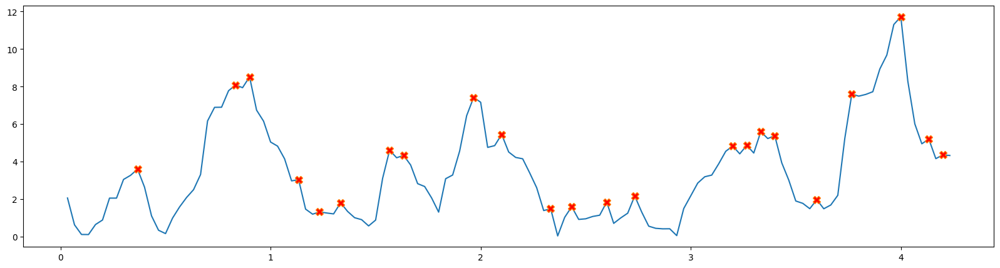

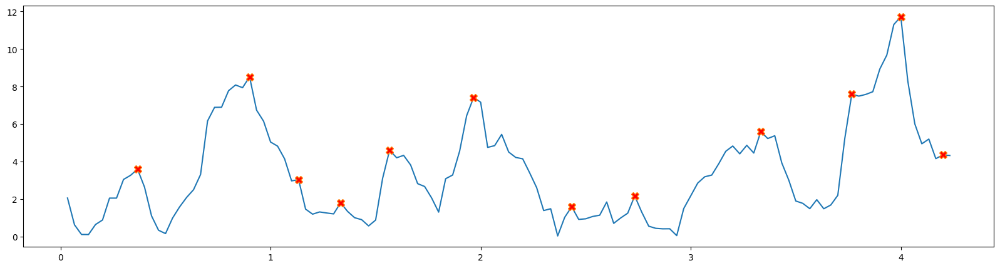

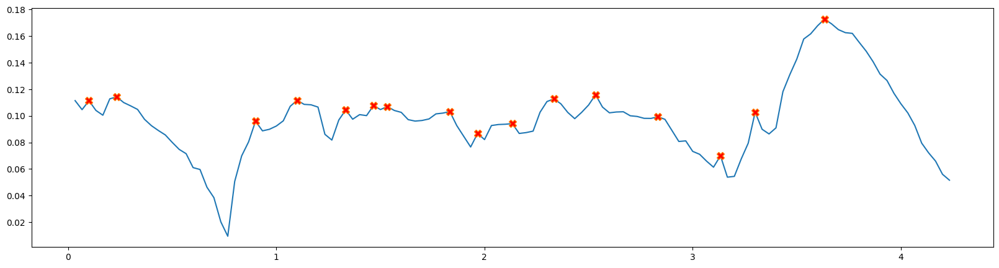

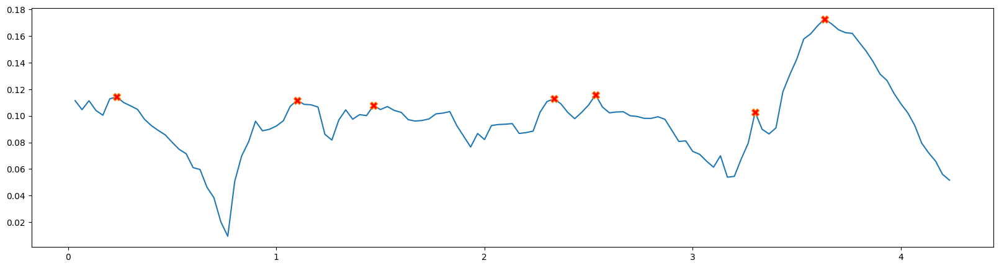

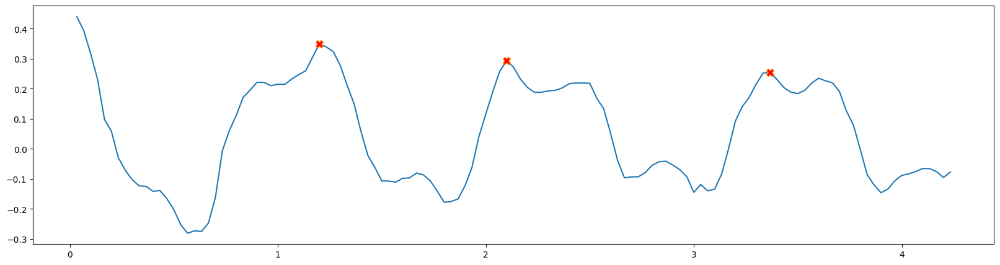

DETECTING GAIT___Foot lifting right


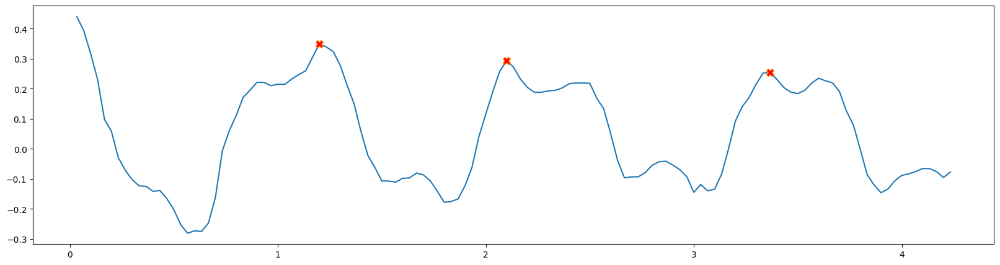

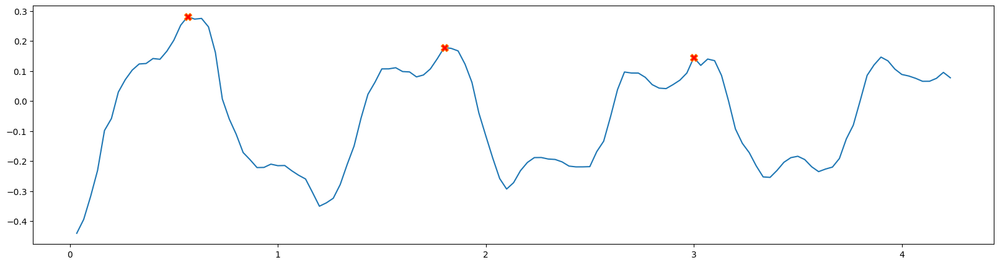

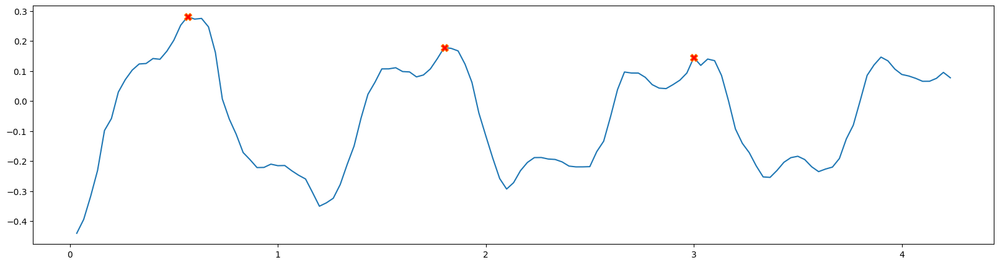

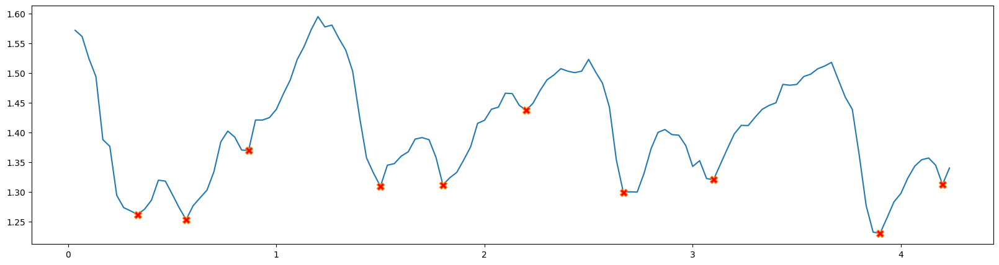

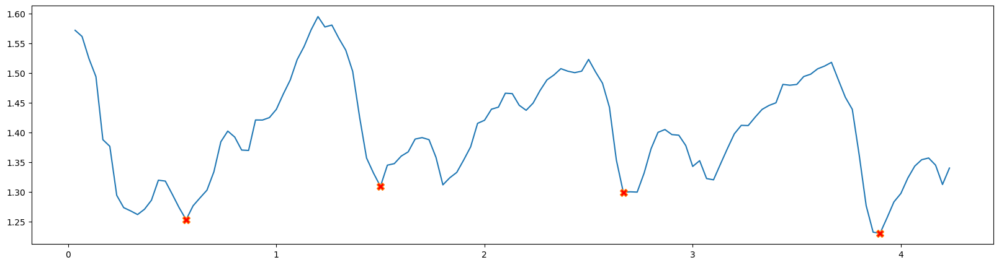

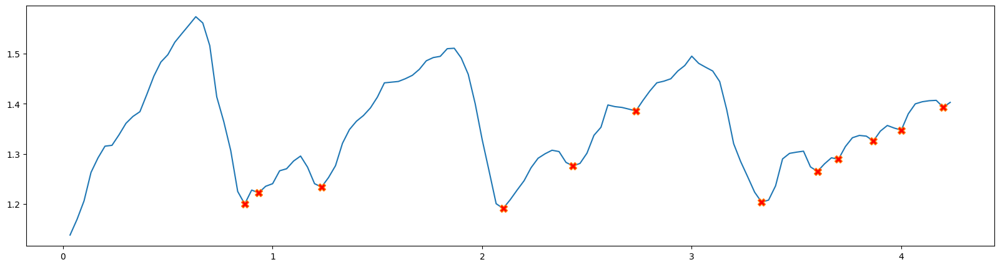

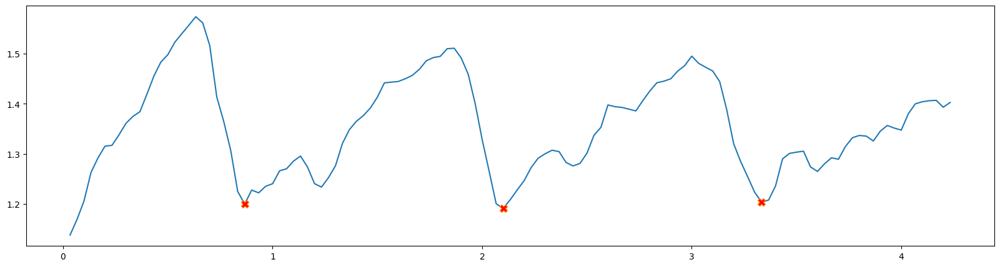

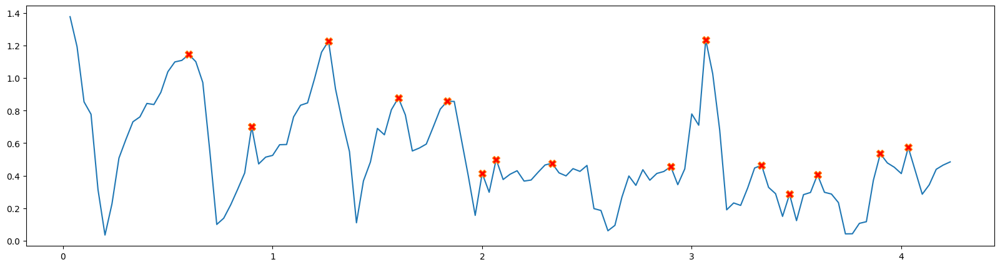

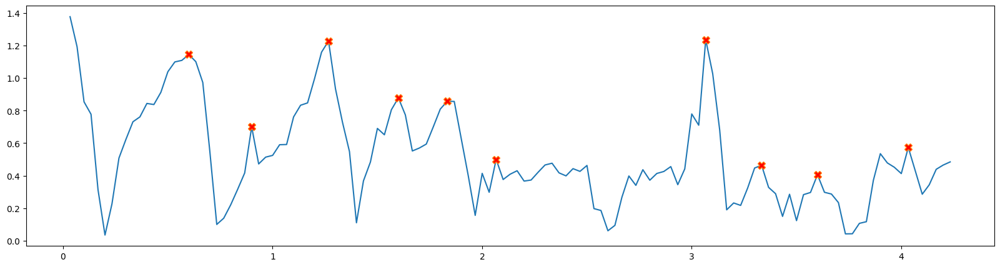

[53]
[39 46 58]
[43]
[37 47 54 61]
[53]
[39 46 58]
[43]
[37 47 54 61]
[89]
[72 81 99]
[69 75 98]
[91 99]
[89]
[72 81 99]
[69 75 98]
[91 99]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count  time       stl      hakr      hakl       flr       fll        po  \
0    0.0   1.2  0.866147  1.309429  1.191294  0.321596  0.178161  4.615422   
1    1.0   2.1  0.850145  1.299546  1.197536  0.273602  0.144897  3.124760   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll   visi_po  \
0  0.107797  0.967384   0.988874   0.987932  0.966742  0.974993  0.999493   
1  0.110480  0.975878   0.991184   0.989182  0.977288  0.977816  0.999338   

    visi_sw  
0  0.964584  
1  0.972960  
front back derek back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.342183  3.484727  0.103915 -0.297692  0.297692   
1    0.066667    2.0  0.342115  2.752860  0.11142

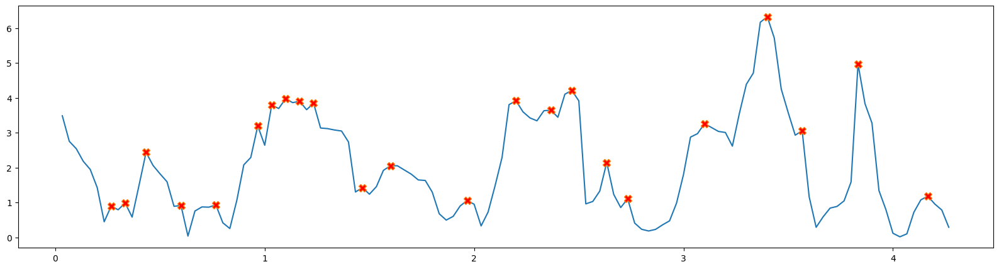

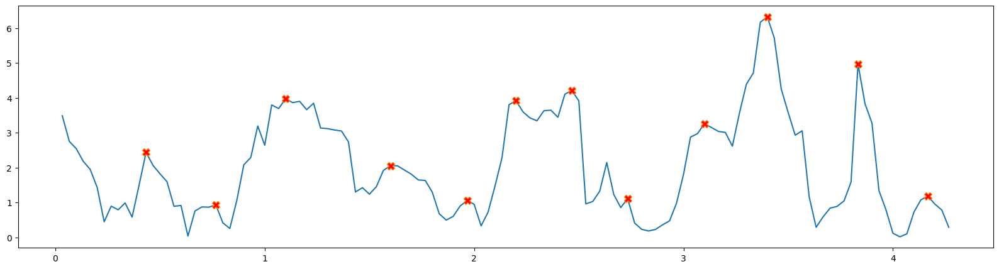

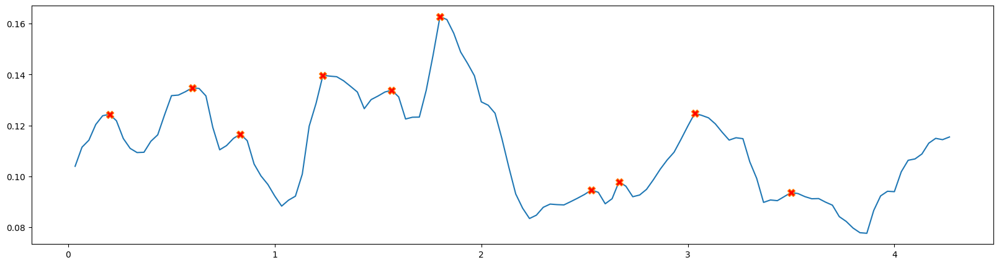

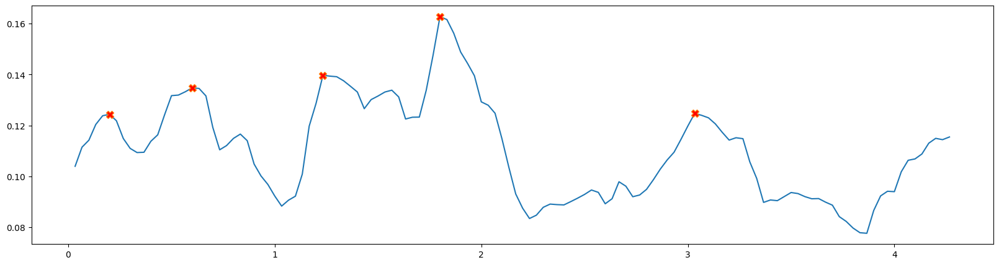

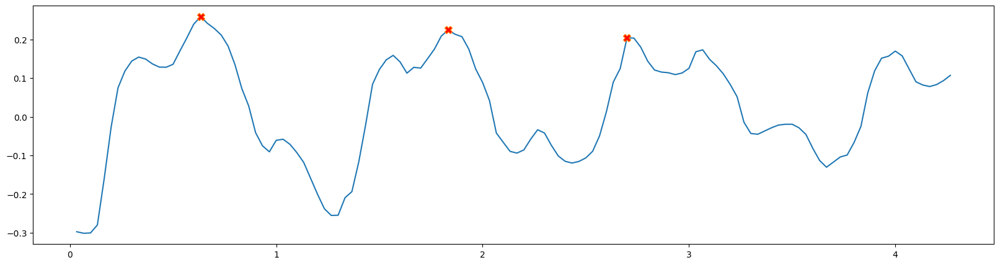

DETECTING GAIT___Foot lifting right


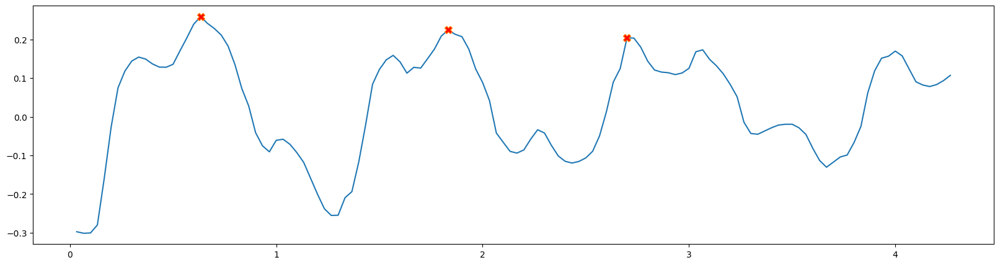

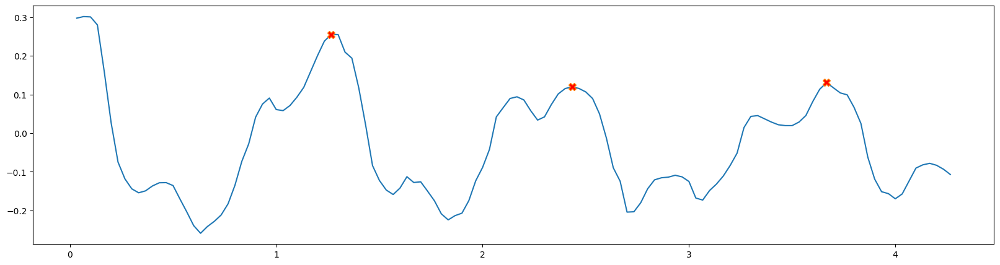

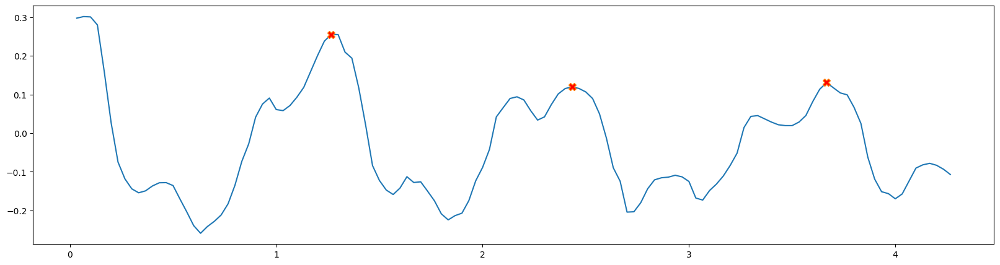

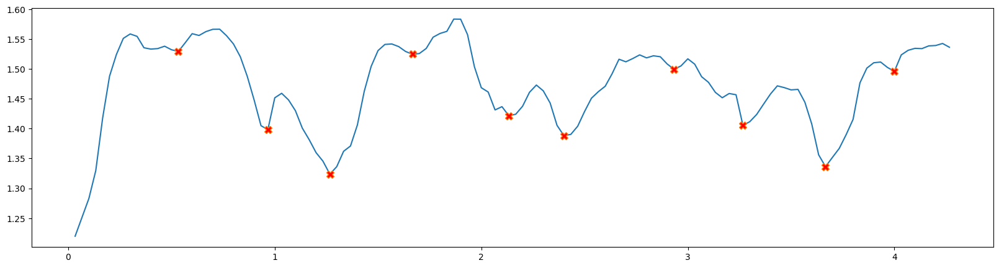

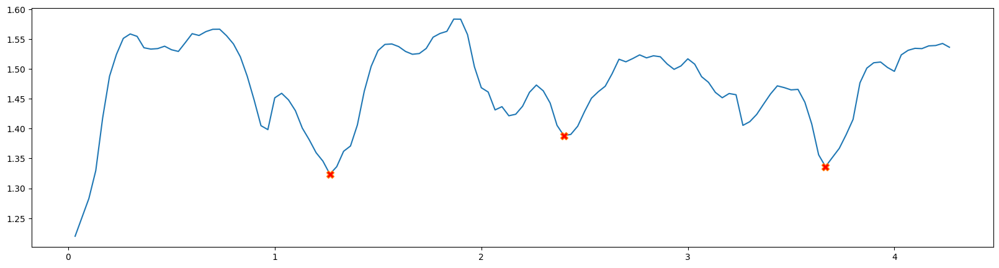

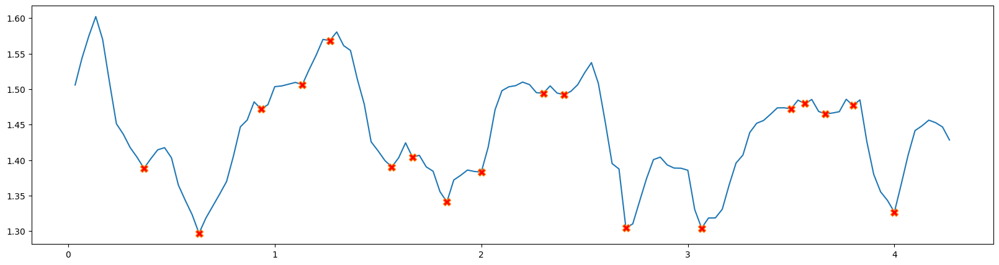

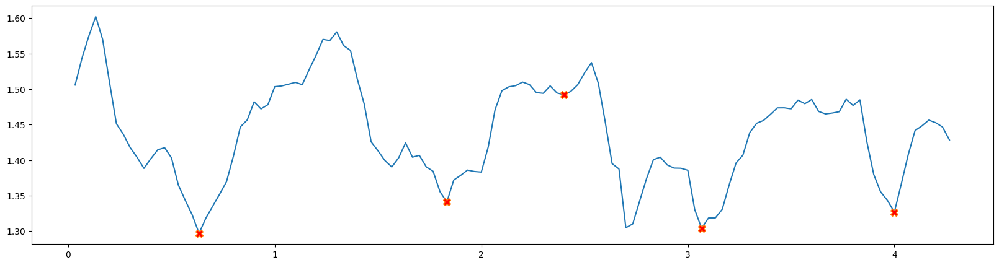

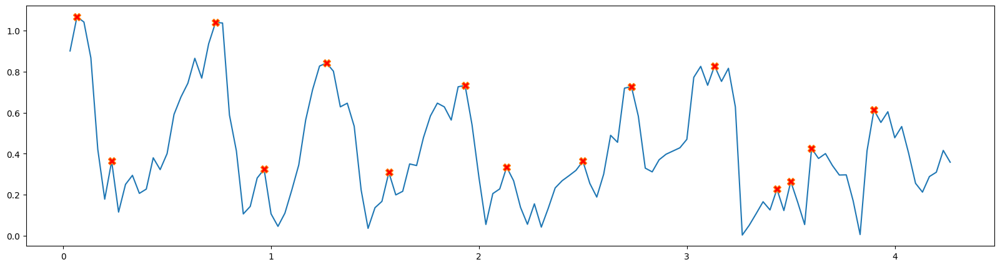

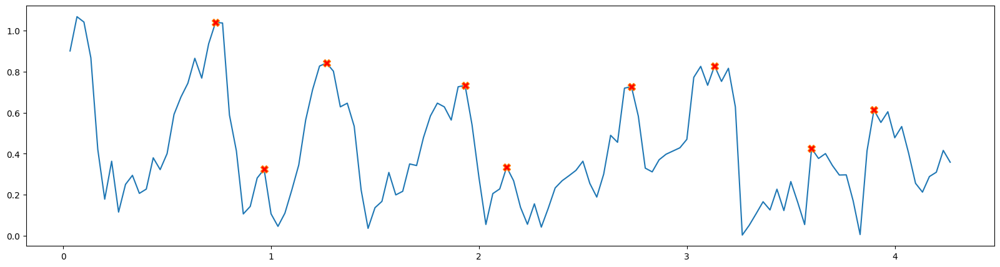

[37]
[22 32 47]
[36 53]
[21 28 37]
[37]
[22 32 47]
[36 53]
[21 28 37]
[72]
[58 65 73]
[]
[57 63]
[72]
[58 65 73]
[]
[57 63]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.633333  0.735250  1.323783  1.318937  0.241855  0.255526   
1    1.0  1.833333  0.533514  1.388248  1.416550  0.214449  0.119900   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  2.320093  0.151256  0.956678   0.979996   0.978405  0.959121  0.965236   
1  3.061777  0.161622  0.964106   0.984055   0.983031  0.971143  0.968215   

    visi_po   visi_sw  
0  0.999597  0.966955  
1  0.999604  0.967371  
front back eranga back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.400857  4.553232  0.087254  0.218219 -0.218219   
1    0.066667    2.0  0.398420  4.356084  0.079431  

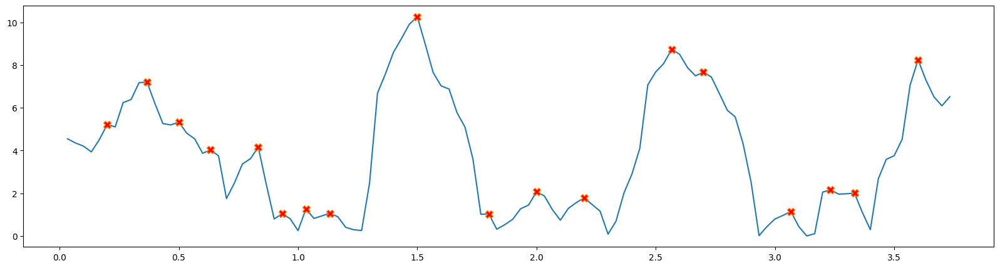

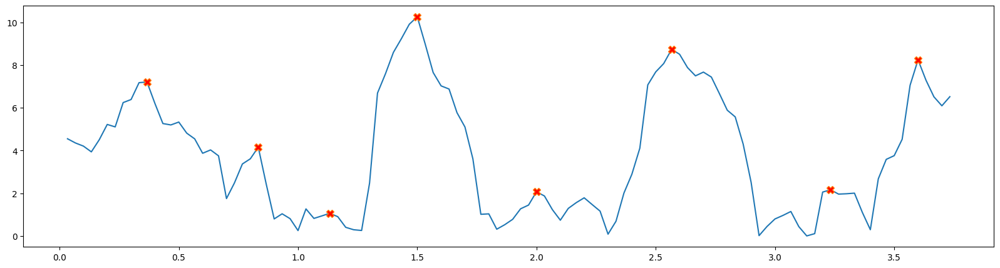

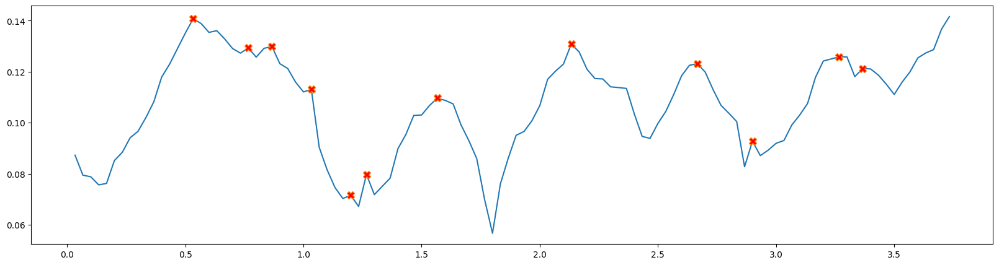

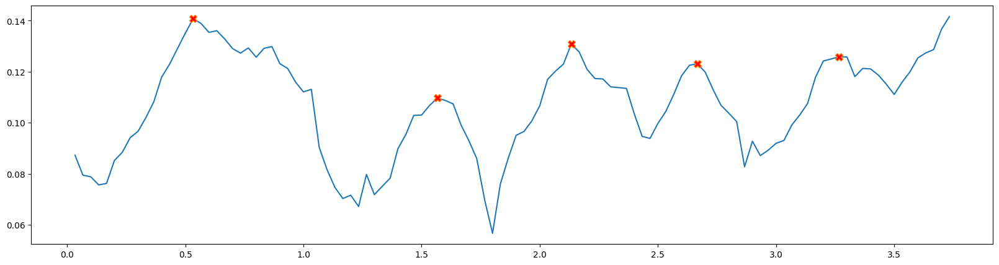

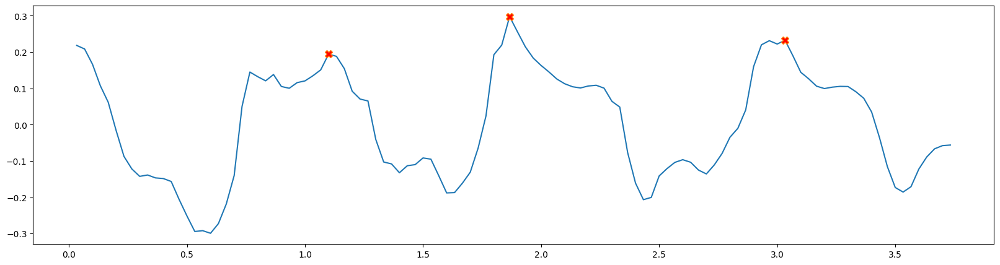

DETECTING GAIT___Foot lifting right


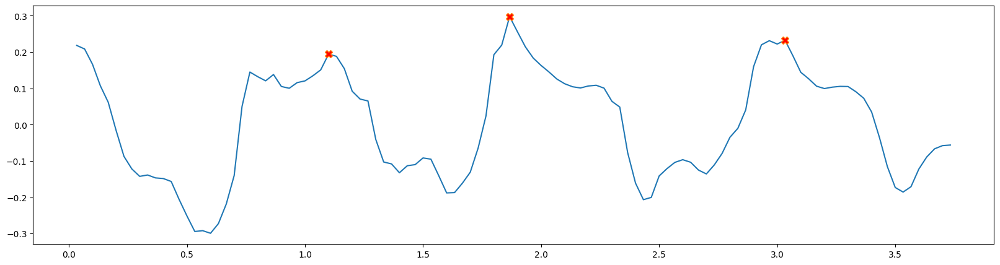

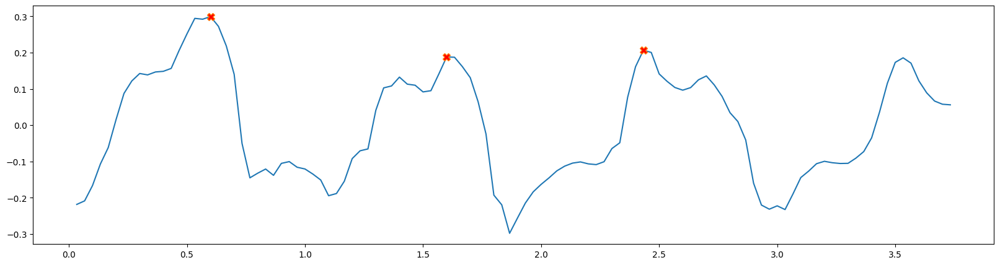

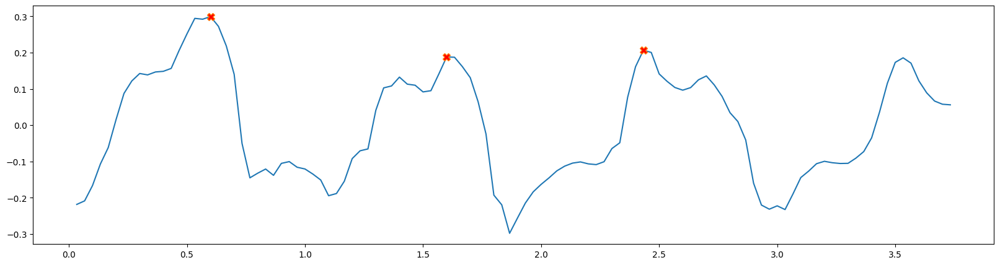

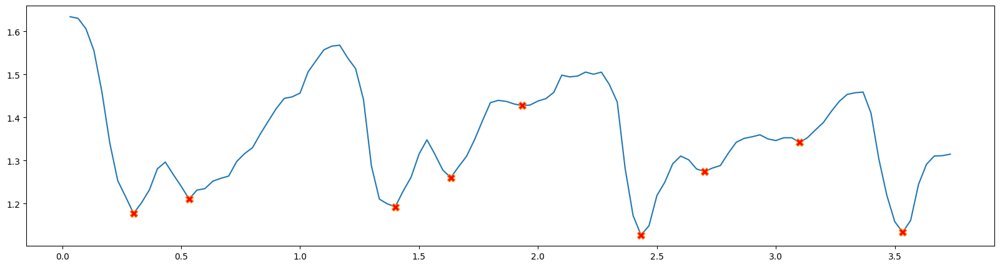

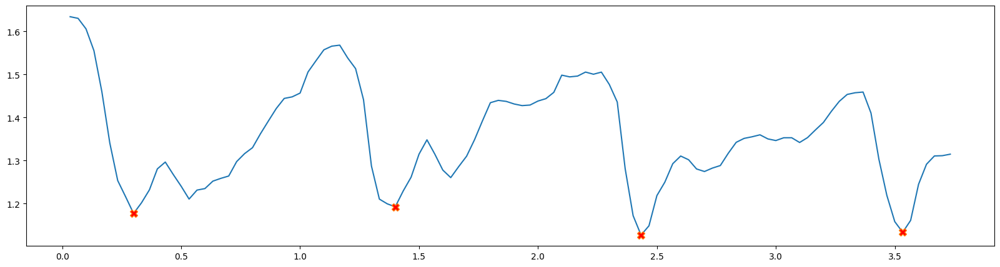

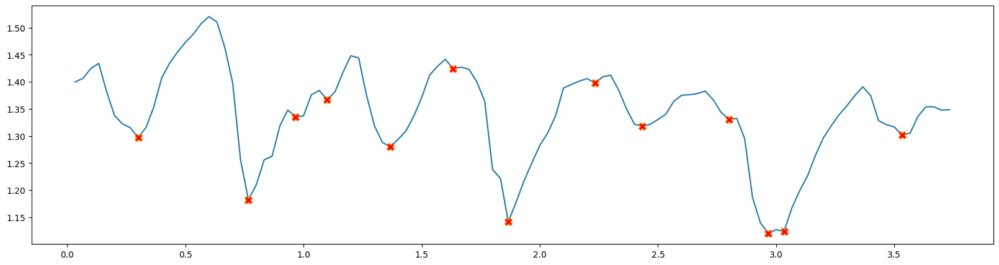

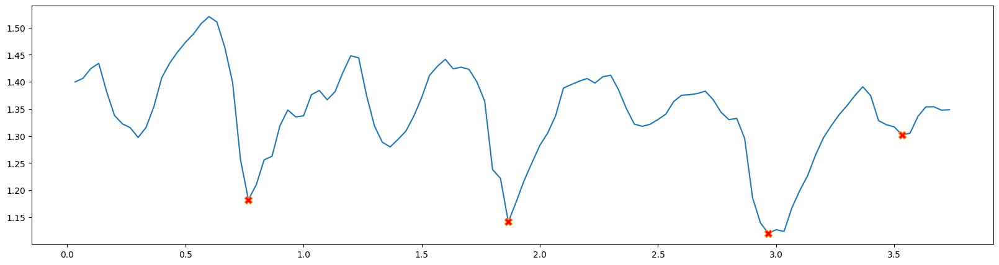

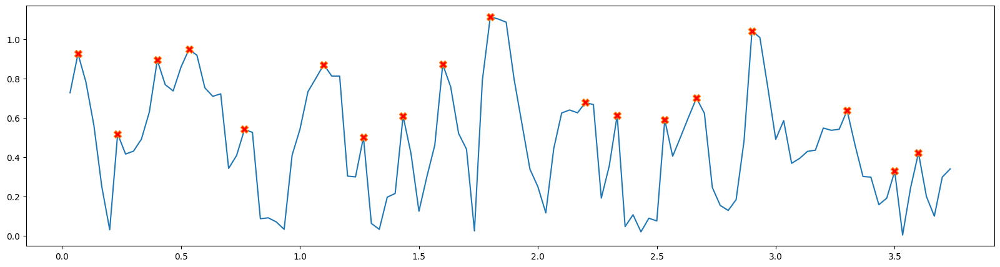

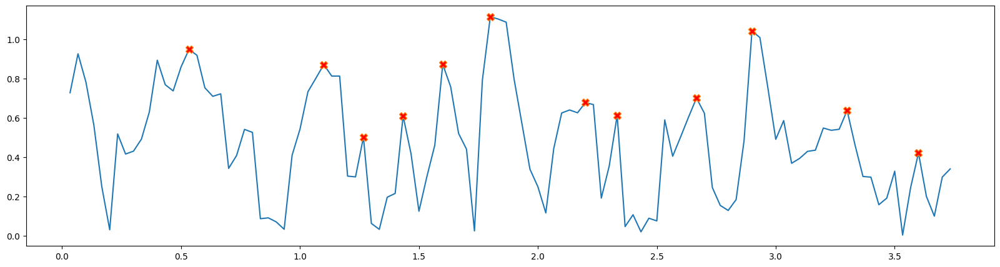

[47]
[33 44]
[46]
[32 37 42 47 53]
[47]
[33 44]
[46]
[32 37 42 47 53]
[72]
[59 76]
[63 79]
[65 69 79 86]
[72]
[59 76]
[63 79]
[65 69 79 86]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  1.100000  0.794239  1.192429  1.141592  0.245960  0.188179   
1    1.0  1.866667  0.758699  1.126784  1.131032  0.265061  0.206802   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  5.664429  0.109642  0.974914   0.989639   0.976614  0.969928  0.977199   
1  5.404930  0.126988  0.978359   0.991129   0.981719  0.973158  0.978847   

    visi_po   visi_sw  
0  0.999369  0.978555  
1  0.999256  0.978214  
front back ijaz back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.386648  1.358913  0.065046 -0.166498  0.166498   
1    0.066667    2.0  0.389065  1.0690

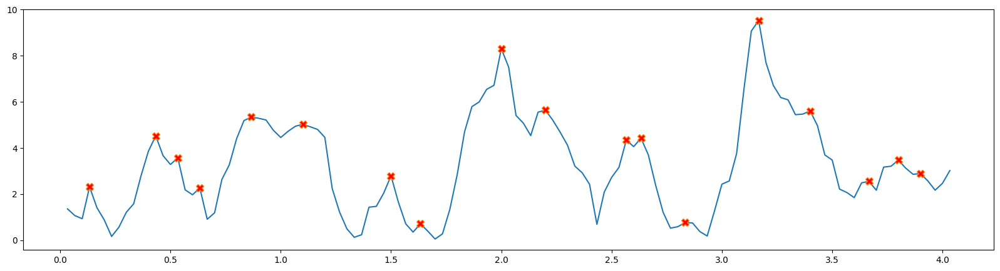

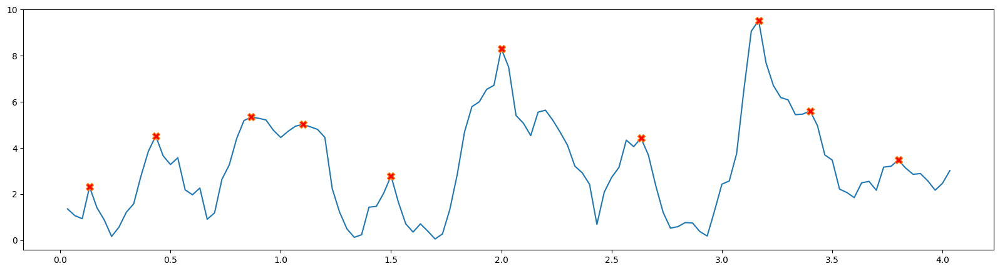

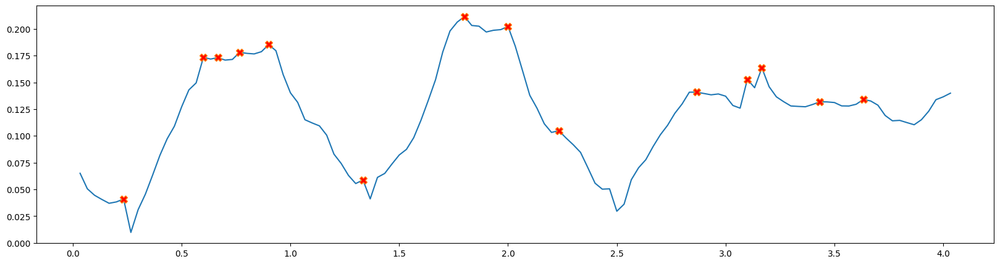

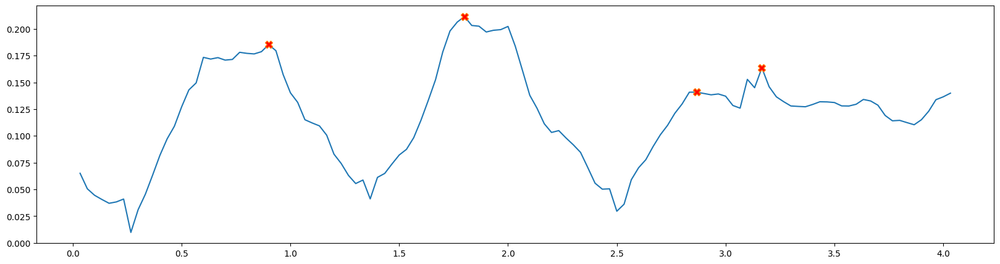

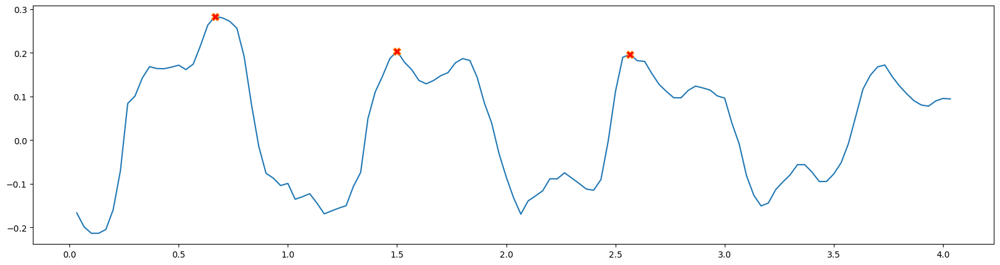

DETECTING GAIT___Foot lifting right


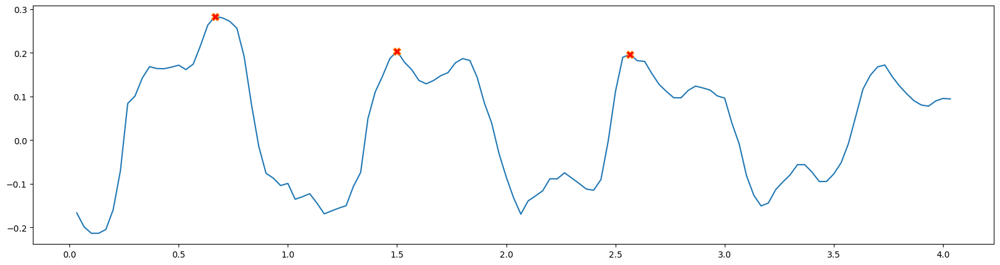

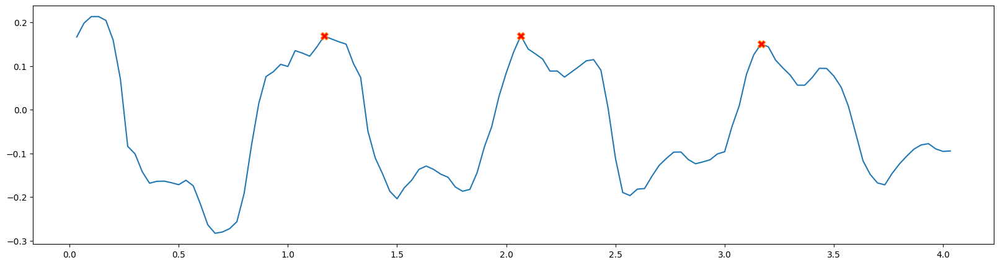

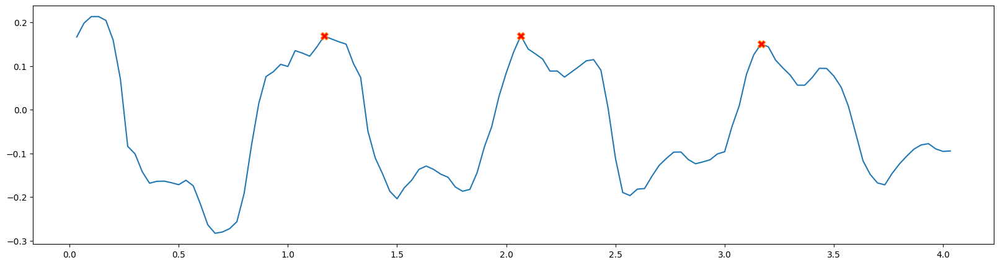

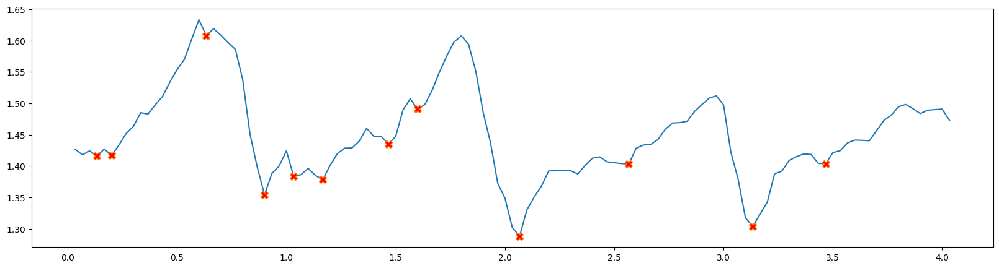

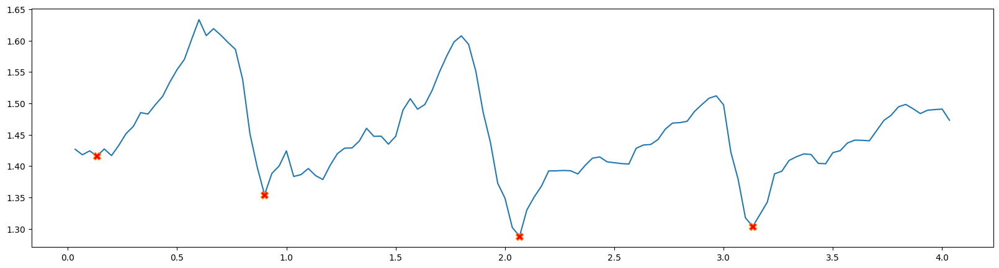

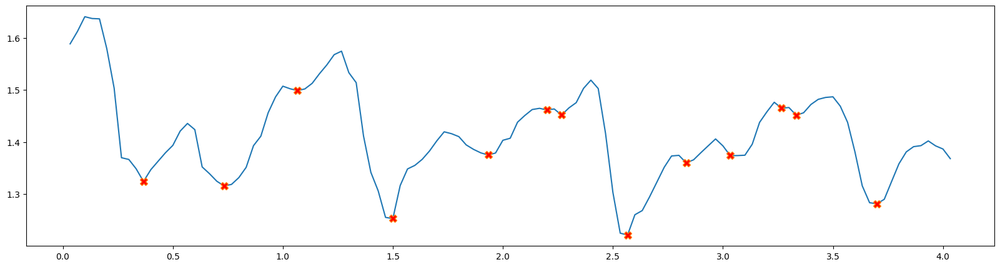

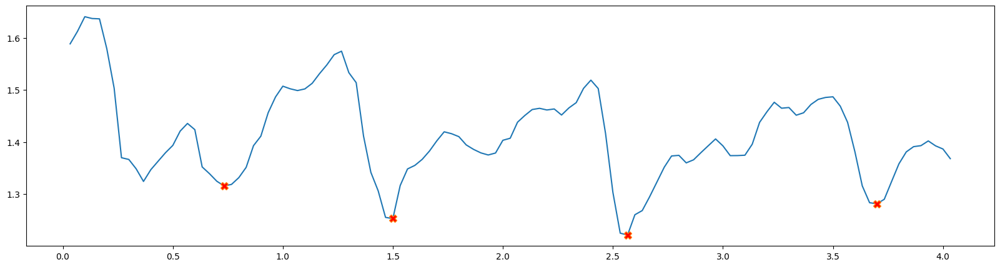

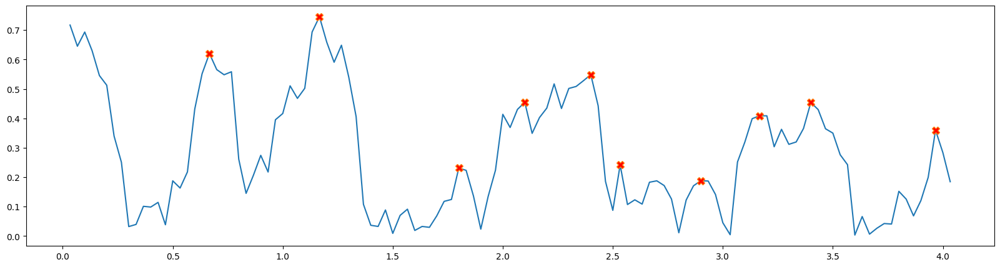

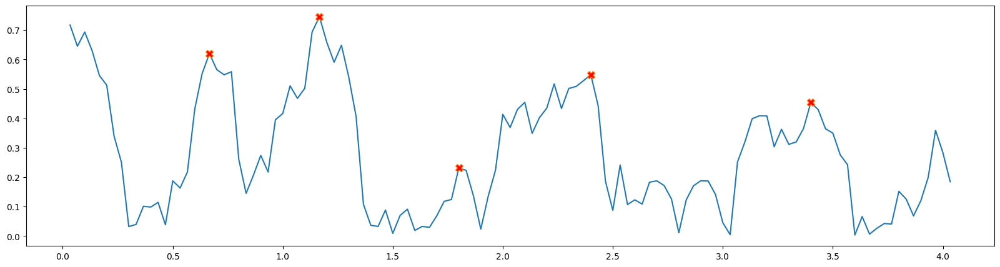

[34]
[25 32 44]
[26]
[19 34]
[34]
[25 32 44]
[26]
[19 34]
[61]
[44 59]
[53]
[53 71]
[61]
[44 59]
[53]
[53 71]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.666667  0.682779  1.354467  1.284210  0.243580  0.168741   
1    1.0  1.500000  0.389788  1.288110  1.237026  0.200413  0.169479   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  4.385778  0.185242  0.976793   0.988286   0.989931  0.976101  0.981178   
1  5.549506  0.211534  0.981388   0.992498   0.991319  0.978424  0.987980   

    visi_po   visi_sw  
0  0.999413  0.978133  
1  0.999367  0.983601  
front back imantha back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.361461  3.071267  0.155064 -0.362184  0.362184   
1    0.066667    2.0  0.361142  3.136138  0.150469 -0.359738  0.3

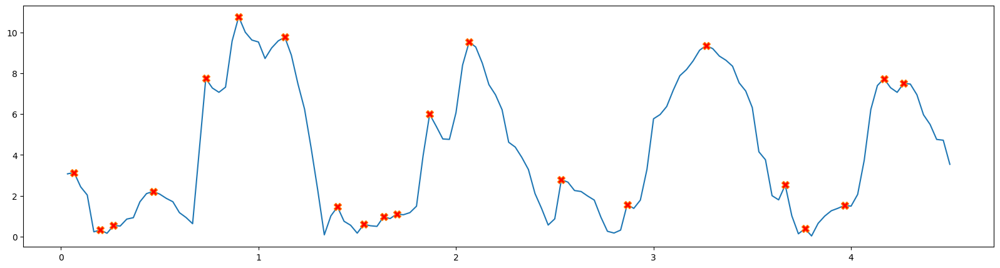

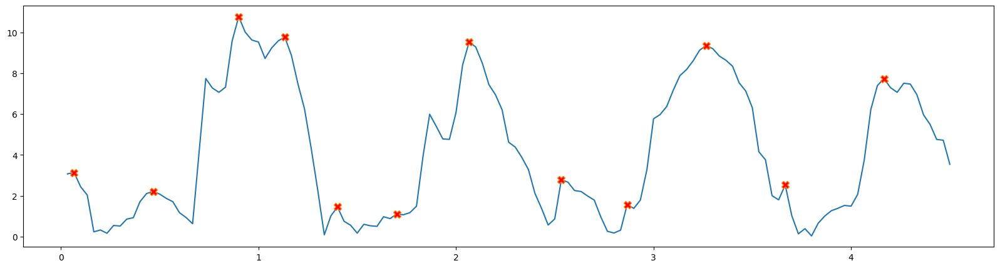

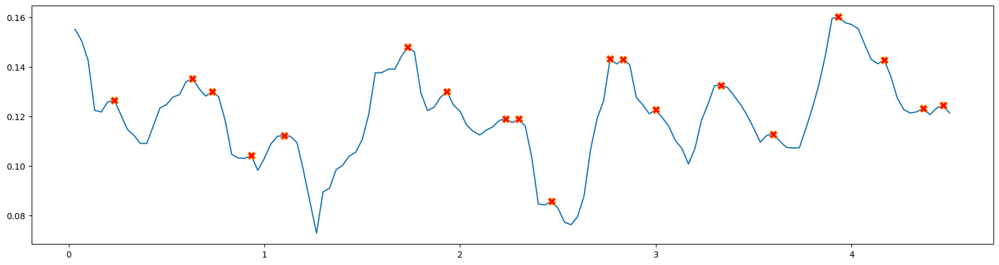

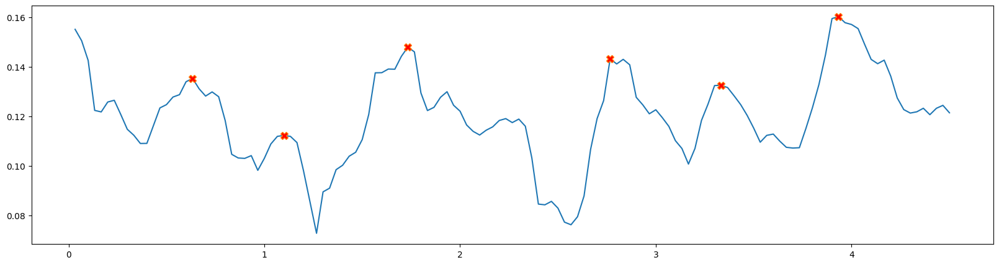

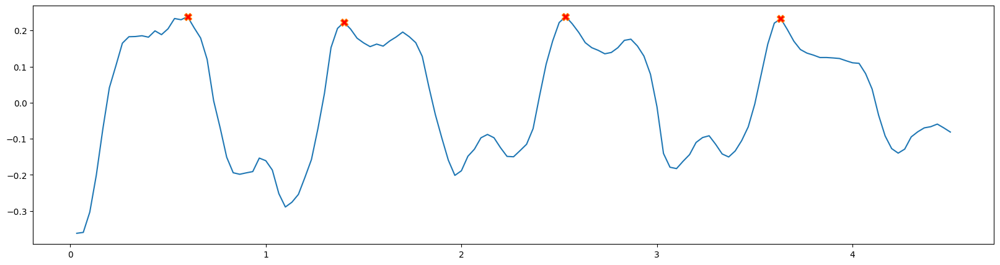

DETECTING GAIT___Foot lifting right


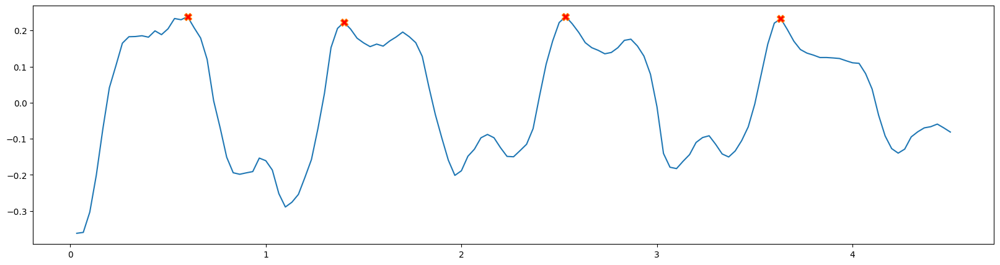

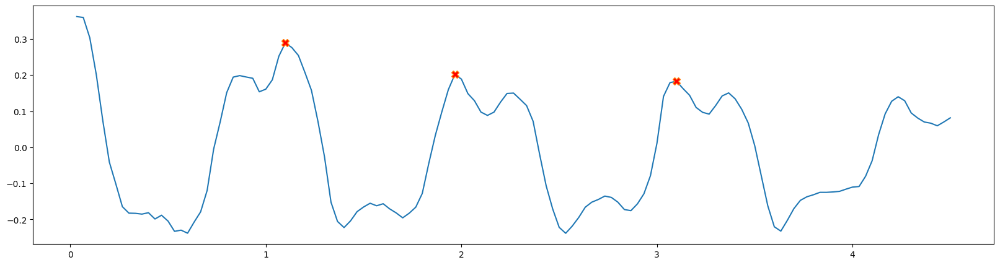

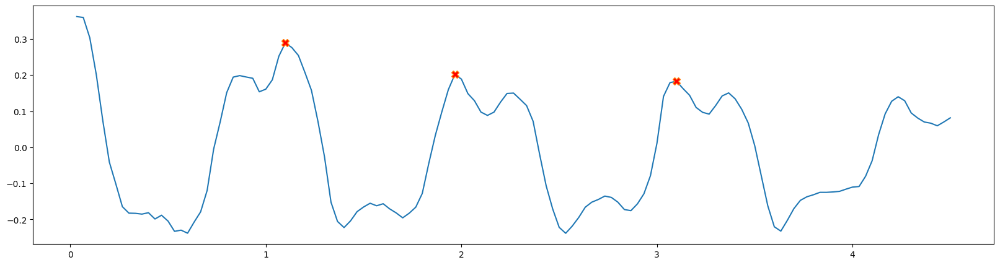

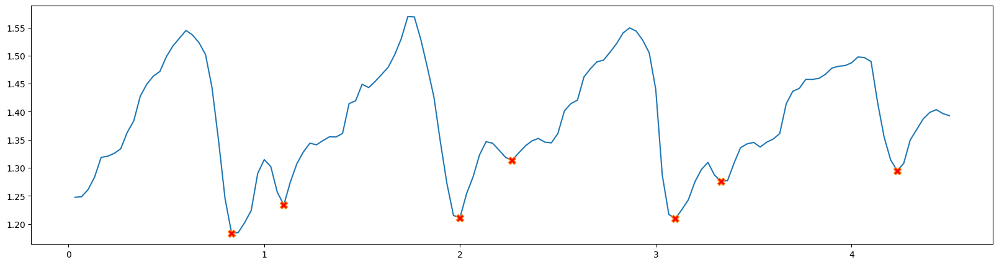

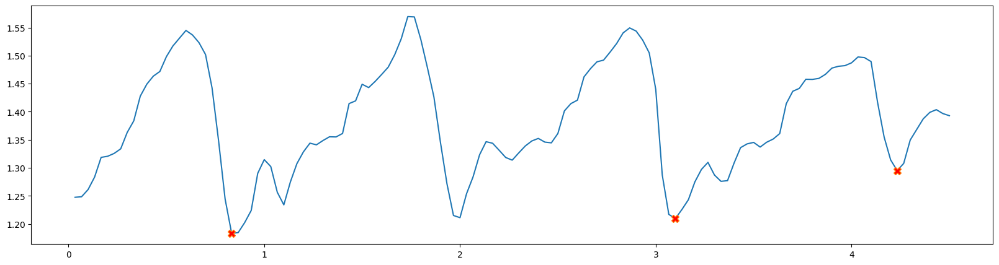

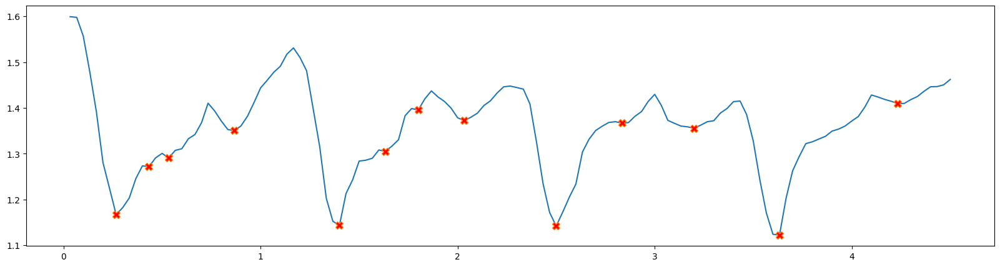

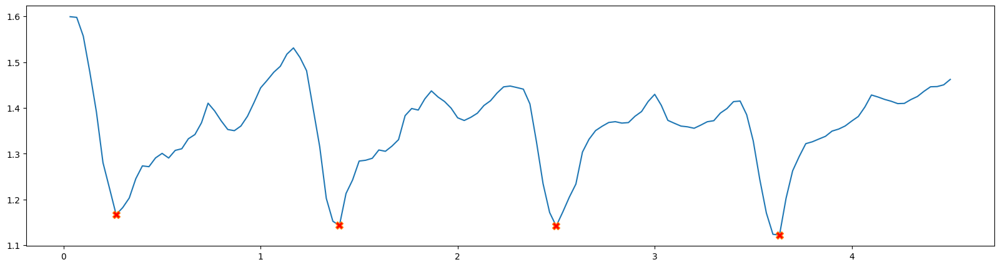

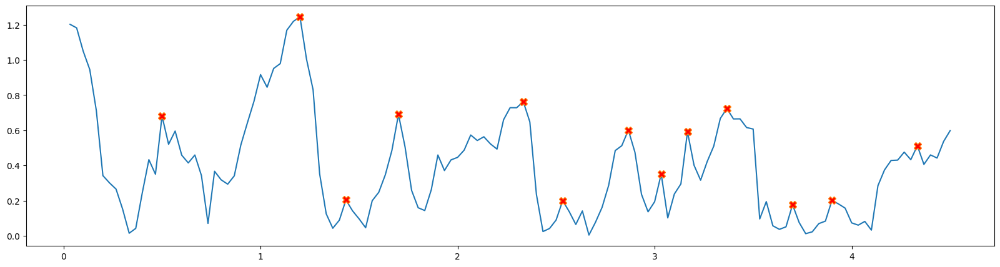

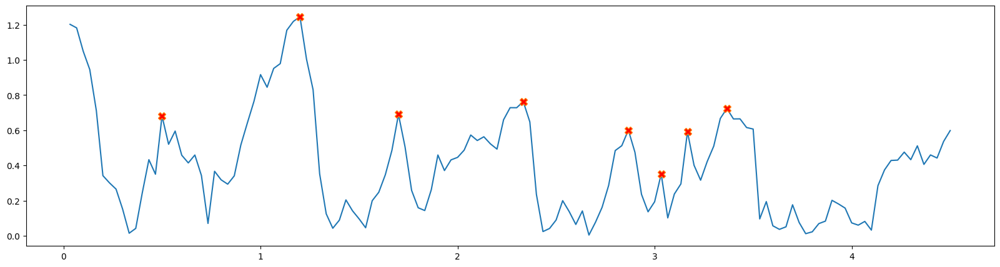

[32]
[26 33 41]
[18 32]
[35]
[32]
[26 33 41]
[18 32]
[35]
[58]
[41 50 61 75]
[51]
[50 69]
[58]
[41 50 61 75]
[51]
[50 69]
[92]
[75 85 97]
[82 99]
[ 85  90  94 100]
[92]
[75 85 97]
[82 99]
[ 85  90  94 100]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
0 2
1 2
2 2
3 2
4 2
5 2
6 2
7 2
8 2
9 2
10 2
11 2
12 2
13 2
14 2
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.600000  1.245964  1.183191  1.143351  0.230559  0.289309   
1    1.0  1.400000  0.726736  1.211049  1.142700  0.230678  0.201655   
2    2.0  2.533333  0.567047  1.209332  1.122420  0.235605  0.182864   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  7.327568  0.123807  0.981211   0.987843   0.995534  0.980069  0.981127   
1  3.719448  0.147909  0.986708   0.989777   0.995761  0.987580  0.988184   
2  4.570937  0.137862  0.990034   0.994754   0.996211  0.990679  0.990043   

 

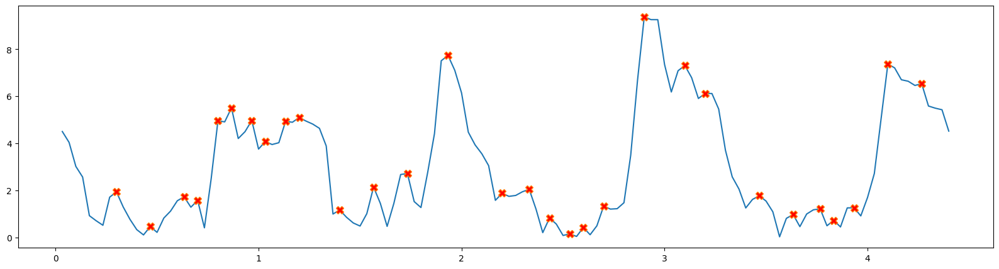

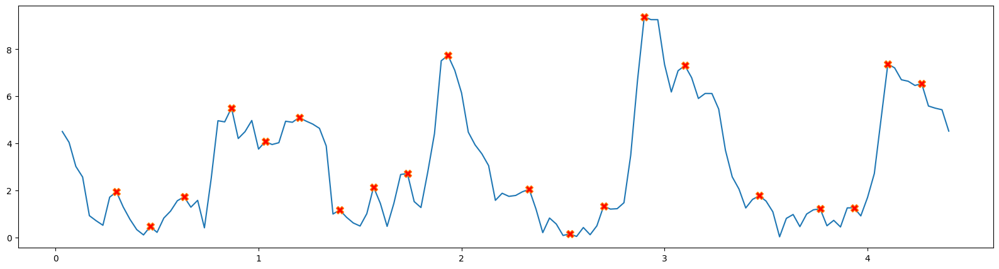

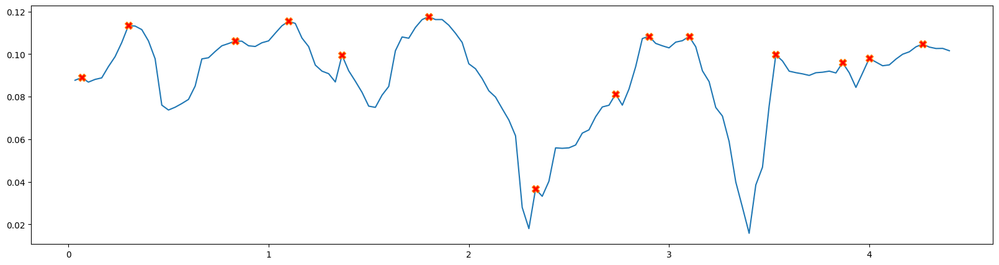

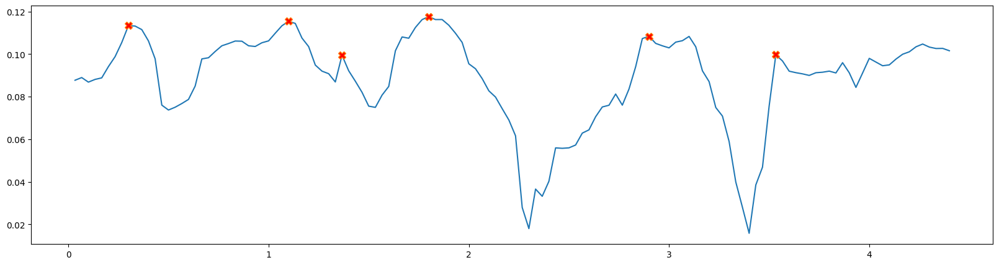

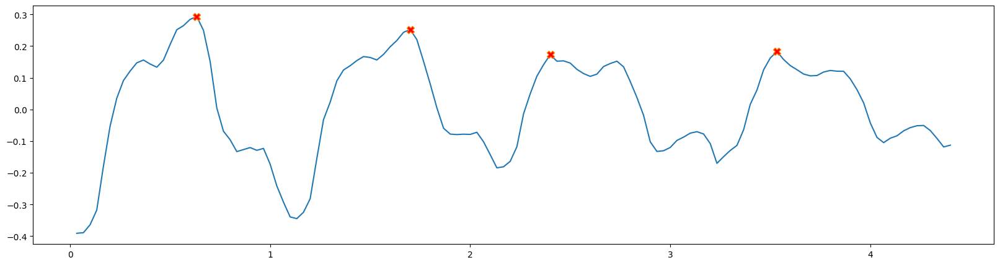

DETECTING GAIT___Foot lifting right


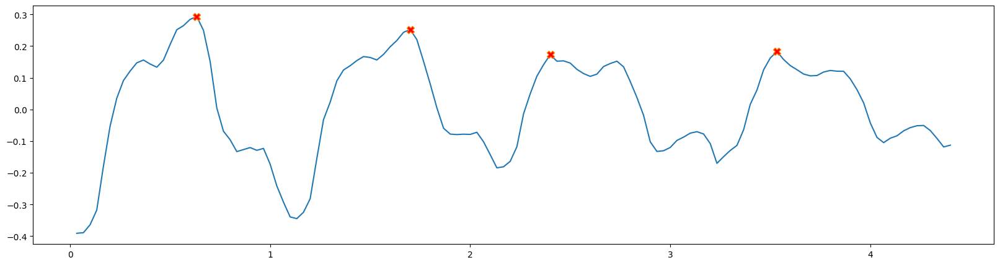

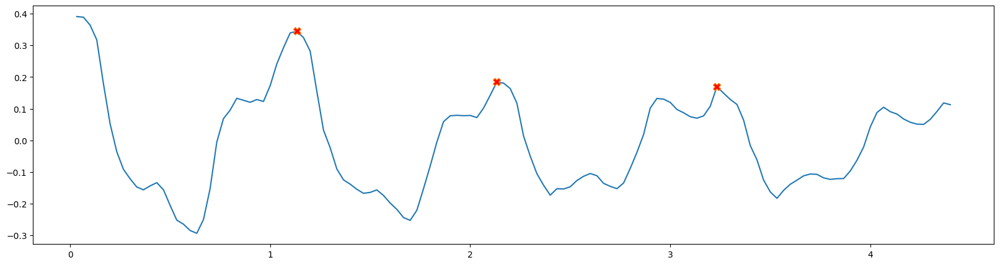

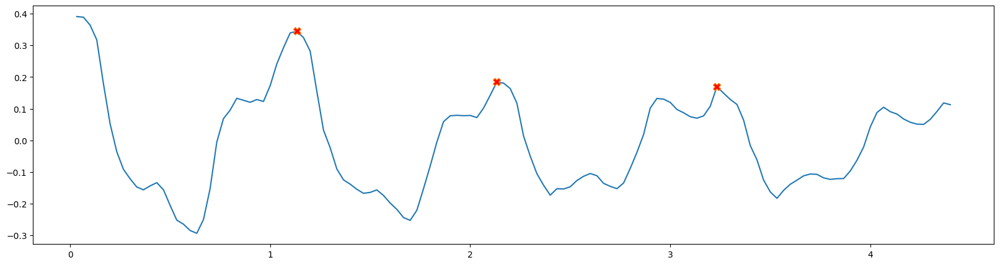

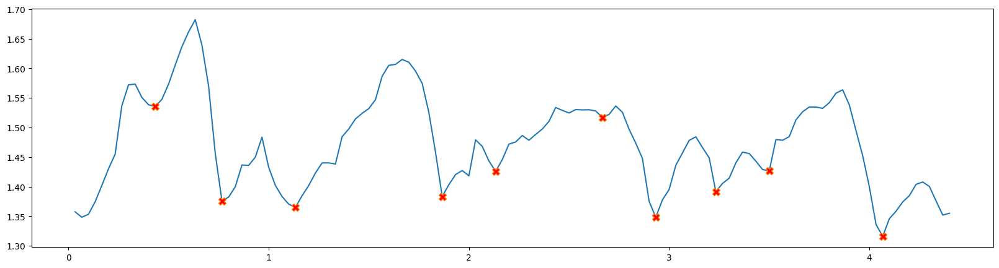

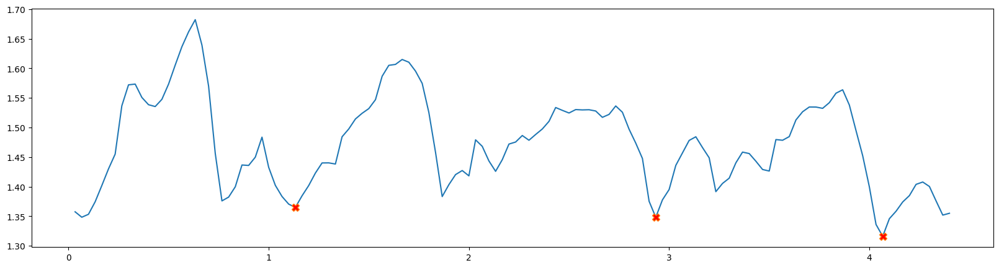

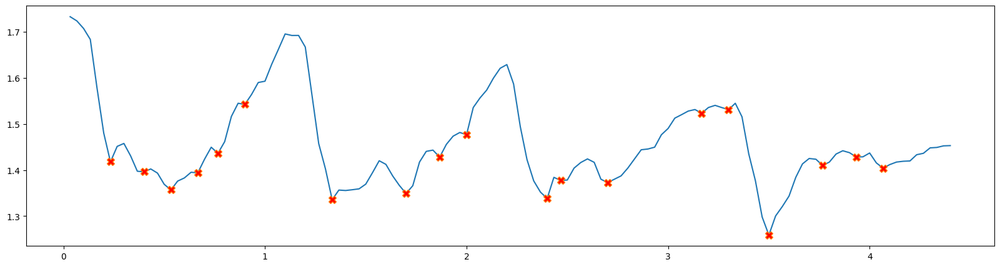

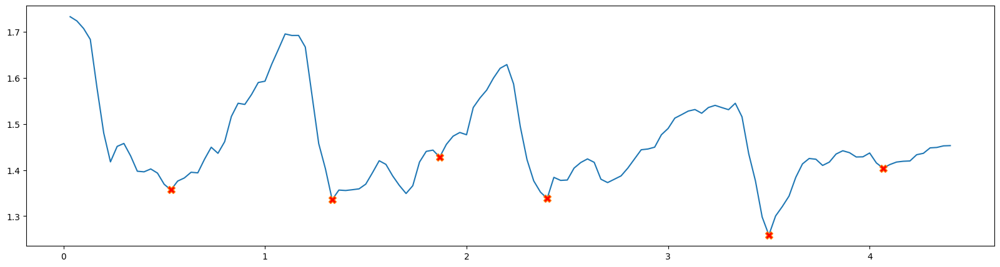

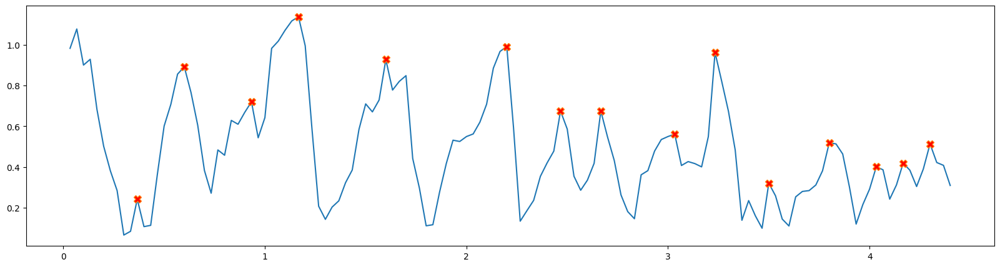

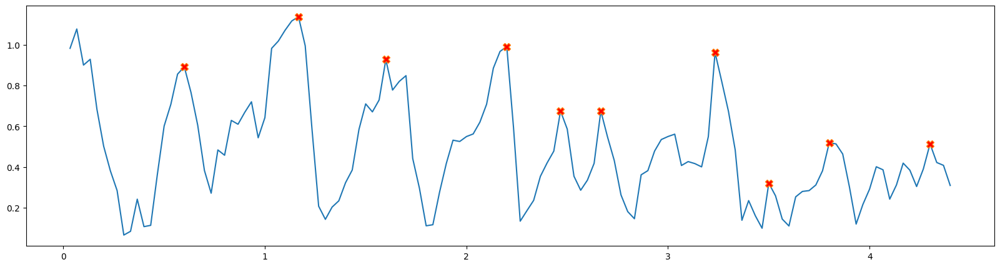

[33]
[18 25 30 35 41 46]
[32 40]
[34 47]
[33]
[18 25 30 35 41 46]
[32 40]
[34 47]
[63]
[51 57 69]
[53]
[65]
[63]
[51 57 69]
[53]
[65]
[96]
[ 75  80  86  92 103]
[ 86 105]
[ 73  79  96 104]
[96]
[ 75  80  86  92 103]
[ 86 105]
[ 73  79  96 104]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
0 2
1 2
2 2
3 2
4 2
5 2
6 2
7 2
8 2
9 2
10 2
11 2
12 2
13 2
14 2
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.633333  1.032232  1.364876  1.335639  0.272776  0.344520   
1    1.0  1.700000  0.990861  1.383225  1.383038  0.212609  0.184337   
2    2.0  2.400000  0.657845  1.348259  1.298475  0.177877  0.170036   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  3.283582  0.107465  0.971390   0.978586   0.991701  0.963575  0.970443   
1  4.164829  0.117644  0.977323   0.982713   0.986399  0.970499  0.979082   
2  3.986377  0.104058  0.969592   0.98529

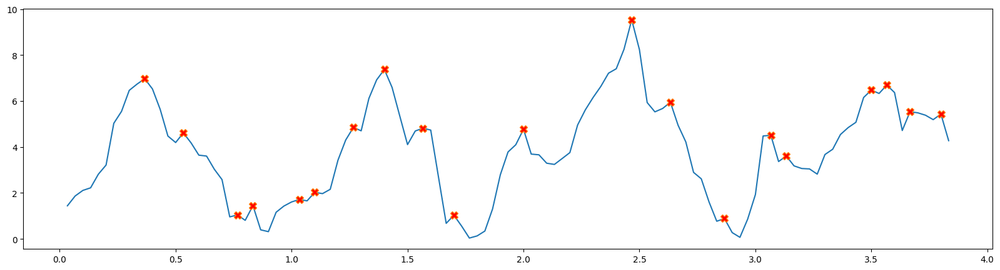

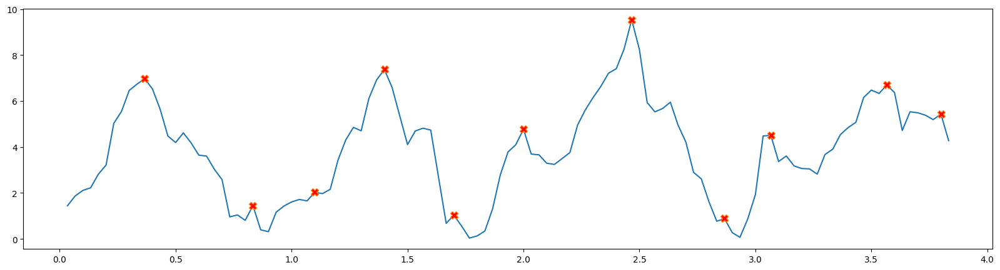

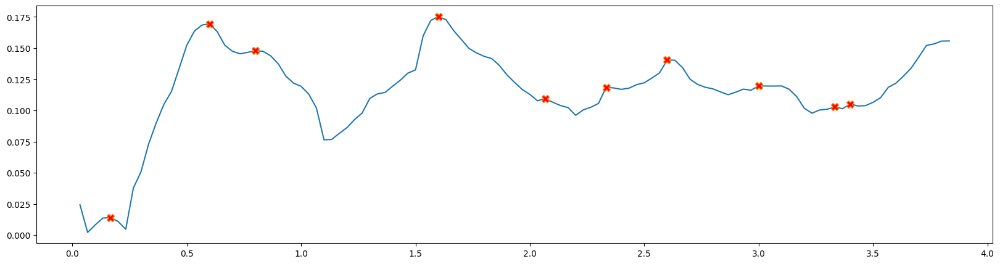

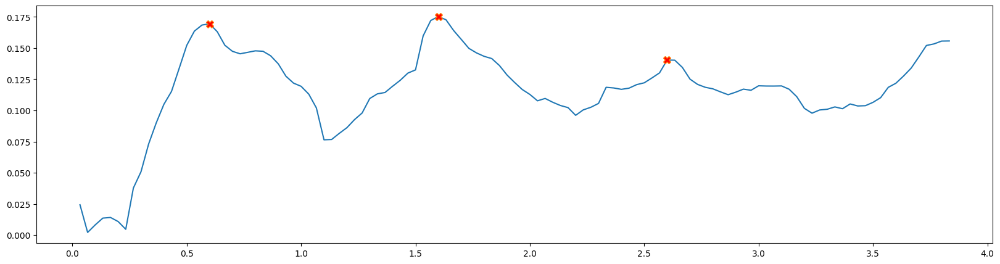

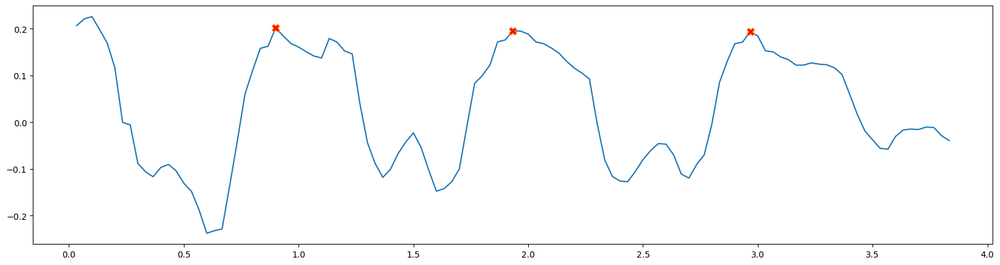

DETECTING GAIT___Foot lifting right


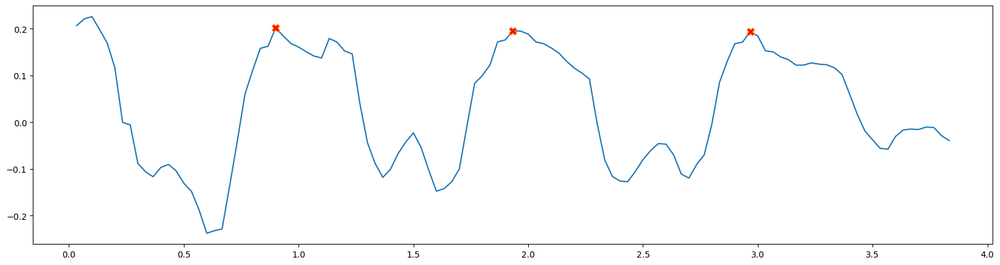

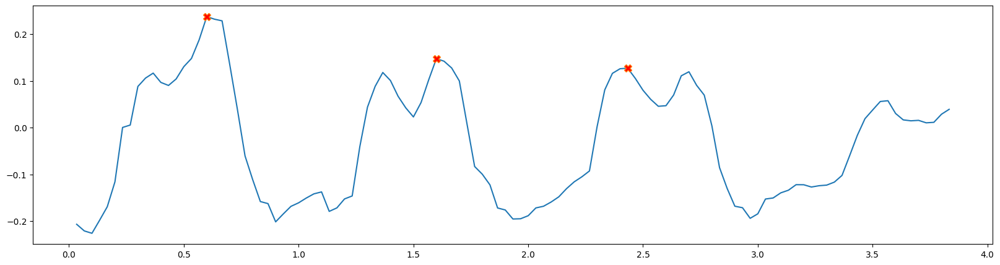

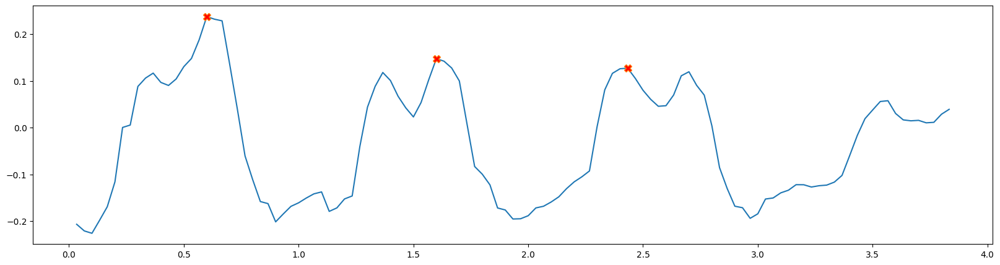

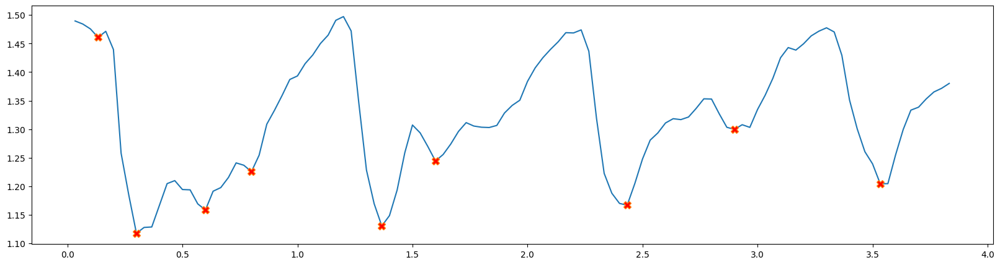

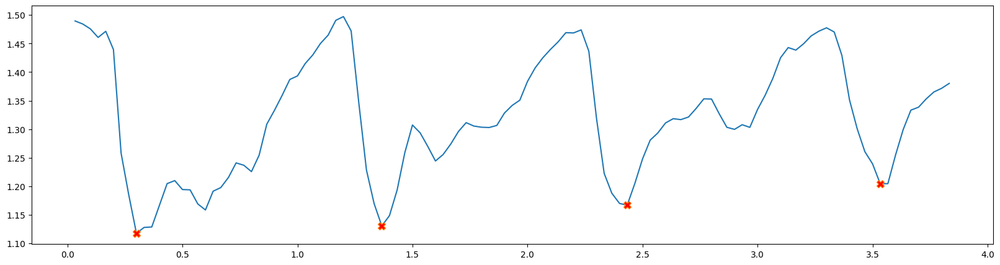

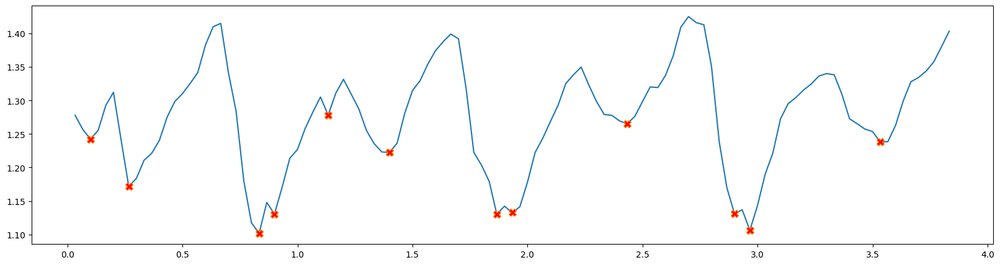

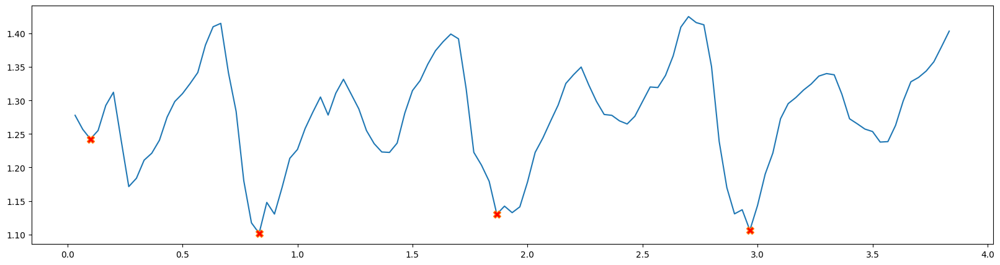

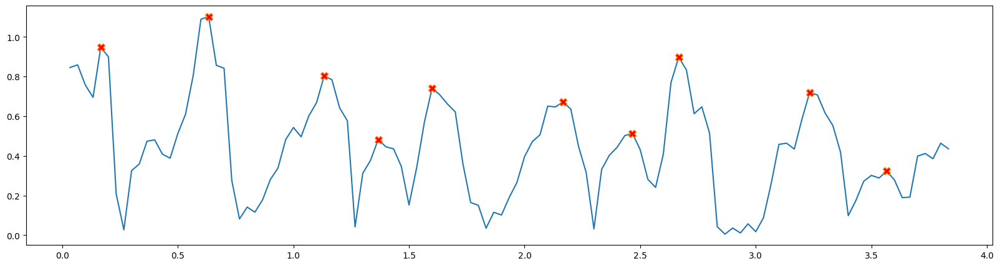

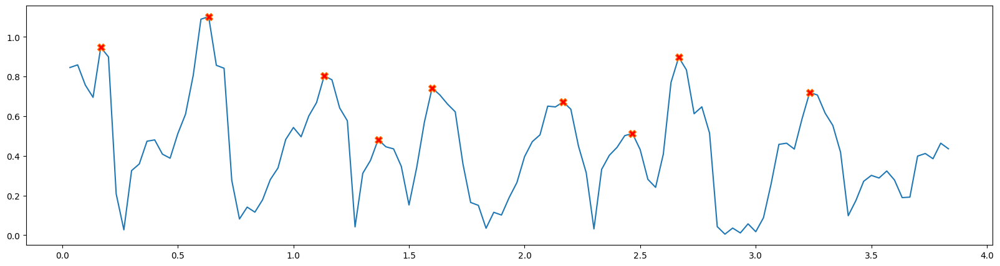

[47]
[32 41 50]
[47]
[33 40 47]
[47]
[32 41 50]
[47]
[33 40 47]
[72]
[59 73 85]
[77]
[64 73 79]
[72]
[59 73 85]
[77]
[64 73 79]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.900000  0.676486  1.130495  1.130200  0.198412  0.147582   
1    1.0  1.933333  0.694411  1.166871  1.106203  0.194631  0.127238   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  3.478167  0.175309  0.976082   0.990202   0.990764  0.975852  0.982410   
1  5.065022  0.140389  0.979581   0.989367   0.991588  0.980904  0.978699   

    visi_po   visi_sw  
0  0.999708  0.984456  
1  0.999663  0.984042  
front back rakitha back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.324966  1.900255  0.117947 -0.255261  0.255261   
1    0.066667    2.0  0.325608  1.776985  0.116

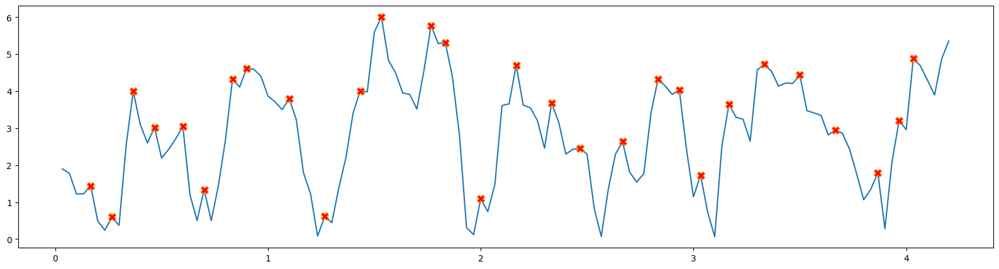

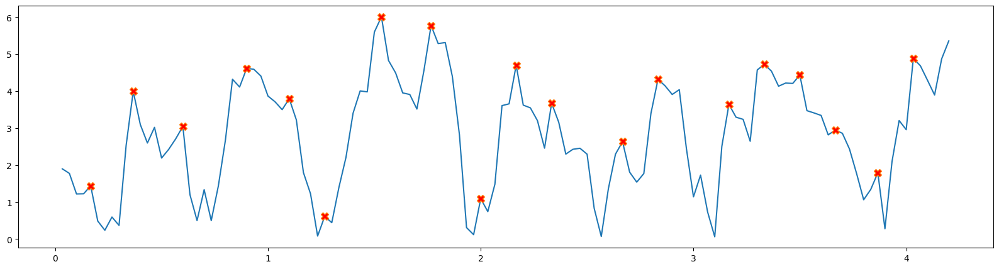

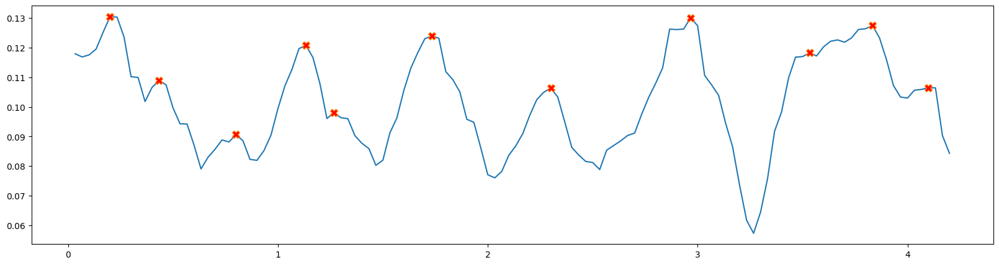

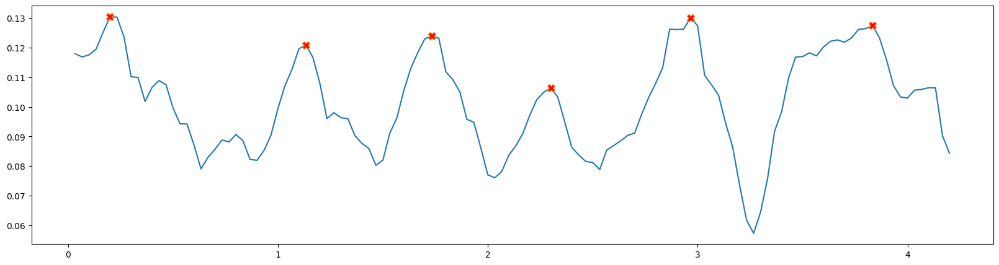

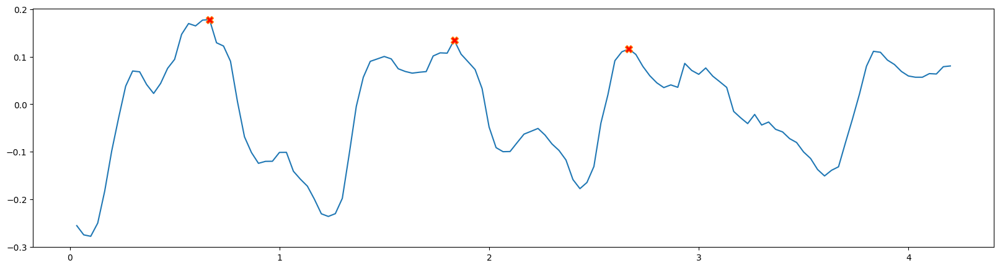

DETECTING GAIT___Foot lifting right


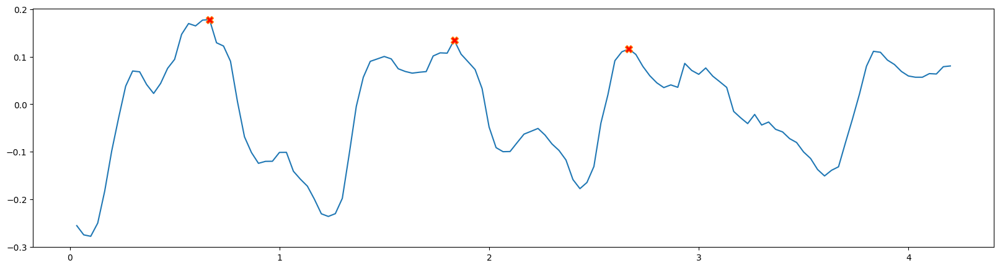

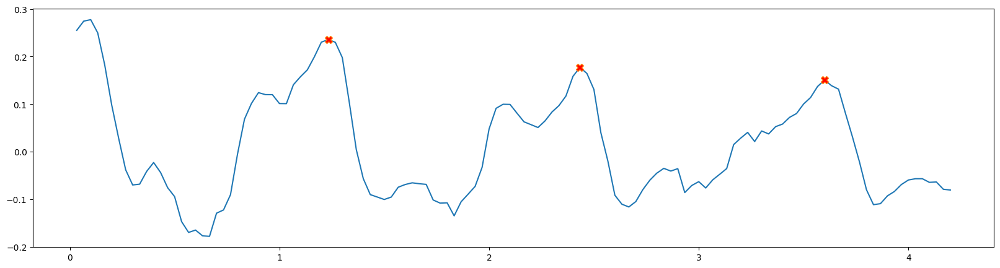

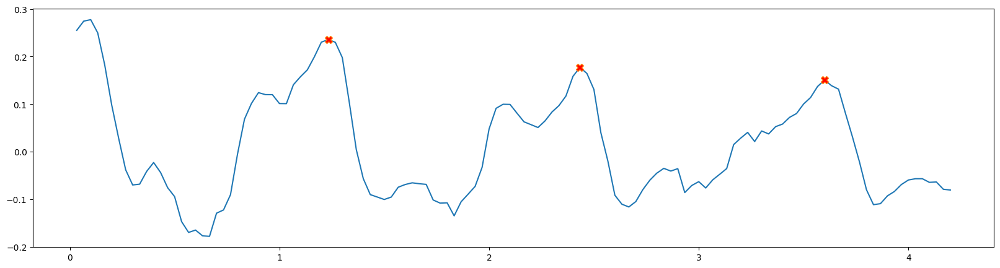

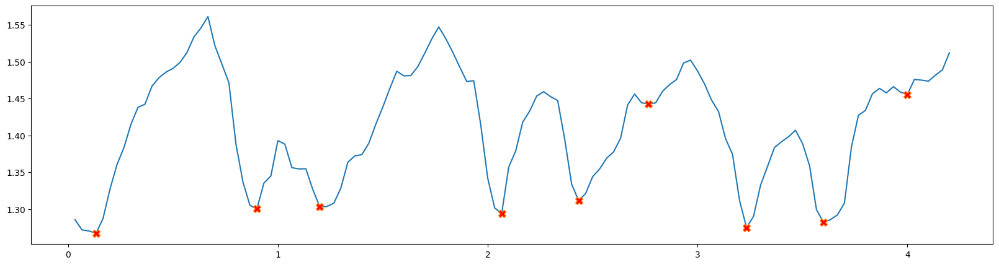

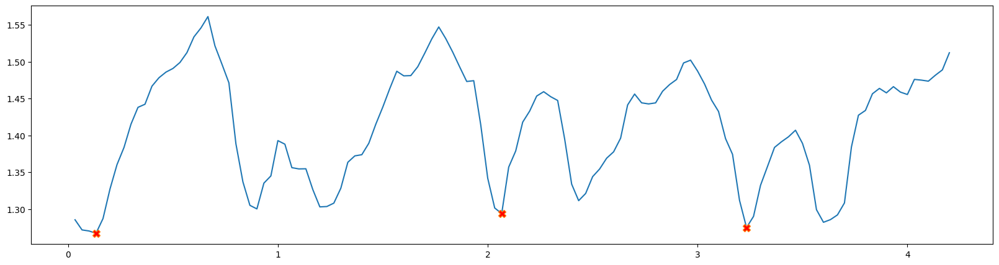

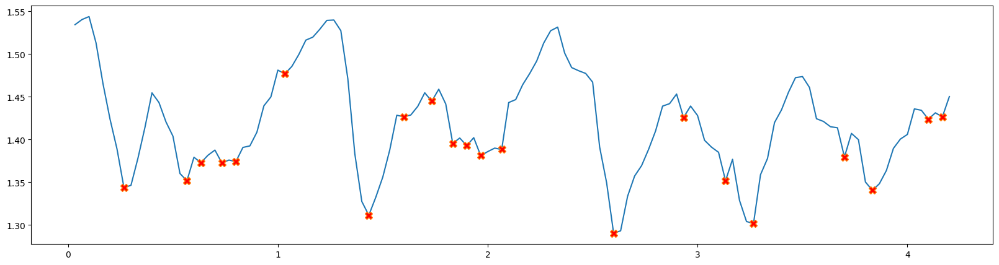

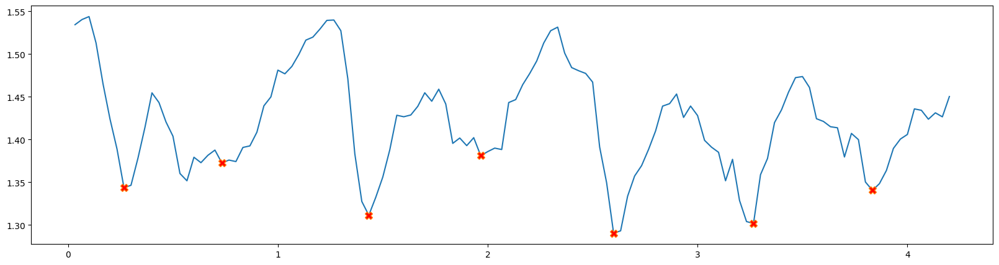

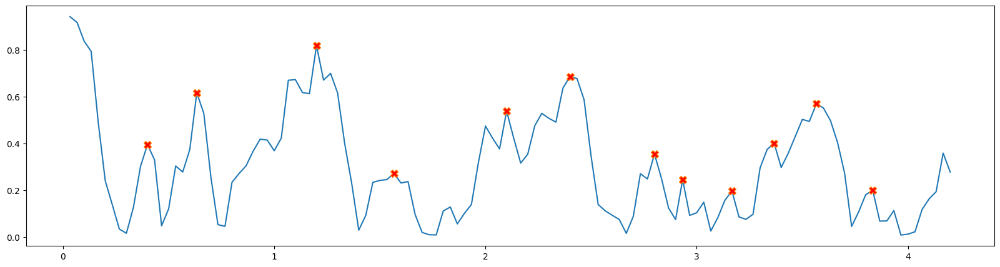

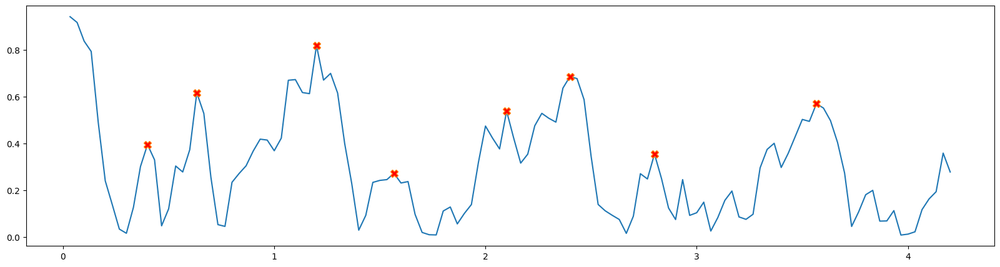

[36]
[26 32 37 45 52]
[33 51]
[35 46]
[36]
[26 32 37 45 52]
[33 51]
[35 46]
[72]
[59 64 69 79]
[68]
[62 71]
[72]
[59 64 69 79]
[68]
[62 71]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.666667  0.545333  1.300104  1.341959  0.156395  0.235900   
1    1.0  1.833333  0.612018  1.293817  1.335676  0.125554  0.177437   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  4.162544  0.122395  0.983647   0.985781   0.992284  0.982680  0.981426   
1  3.026336  0.106333  0.987417   0.992508   0.994558  0.985728  0.985633   

    visi_po   visi_sw  
0  0.999483  0.983663  
1  0.999418  0.985891  
front back ravindu back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.364112  2.105723  0.096454  0.185660 -0.185660   
1    0.066667    2.0  0.363800  2.7

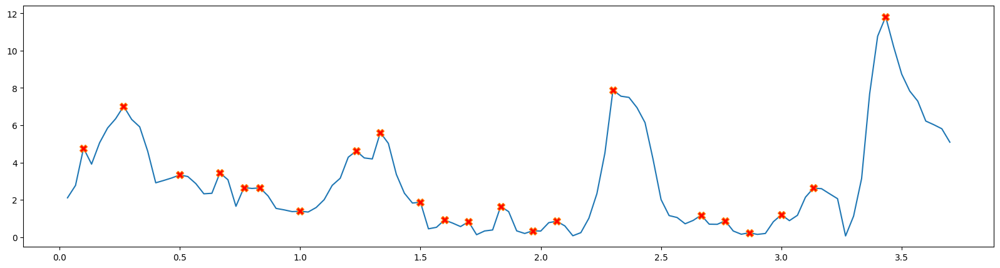

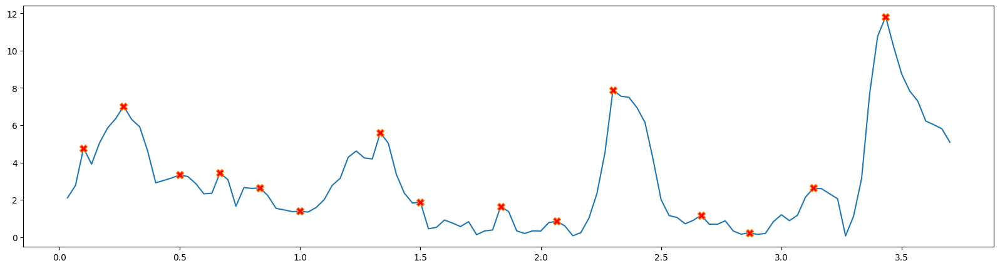

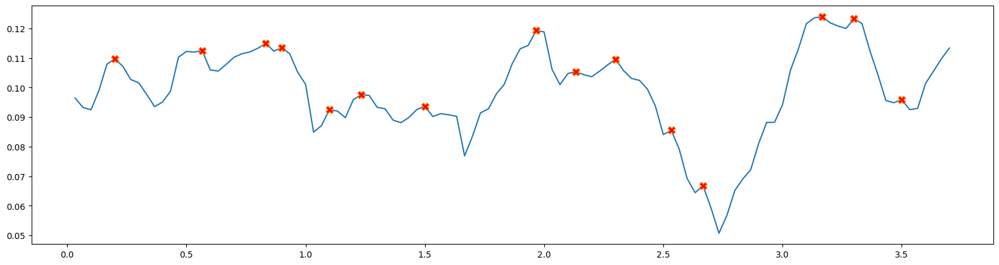

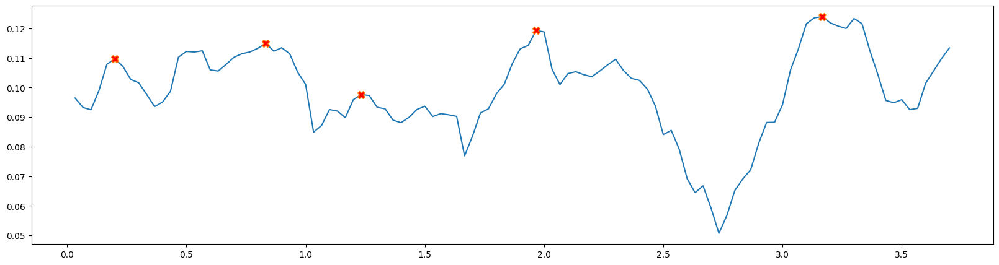

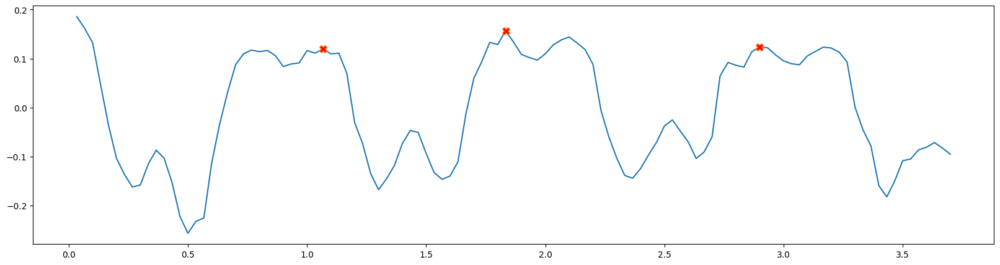

DETECTING GAIT___Foot lifting right


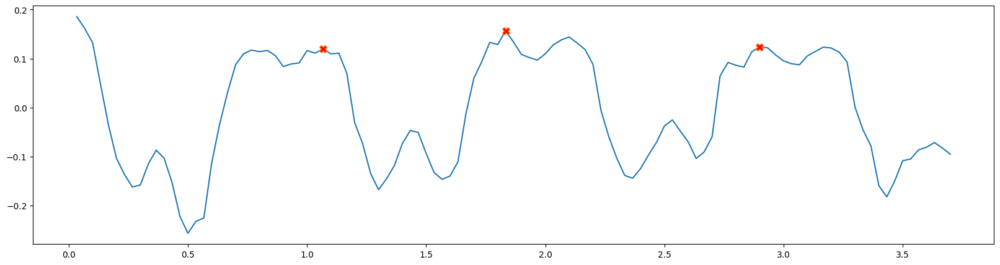

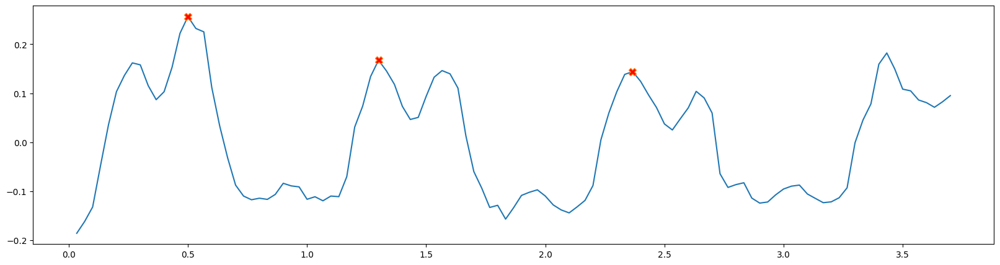

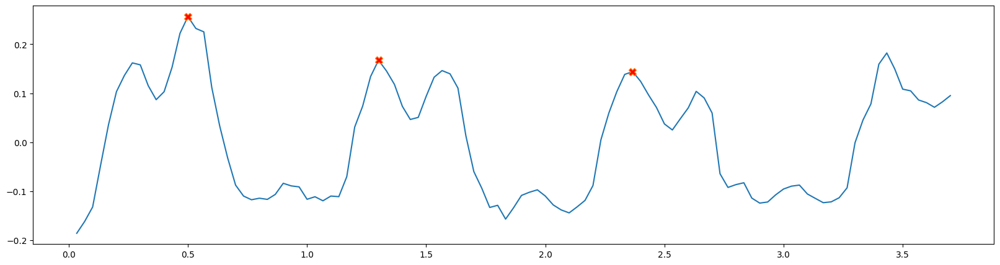

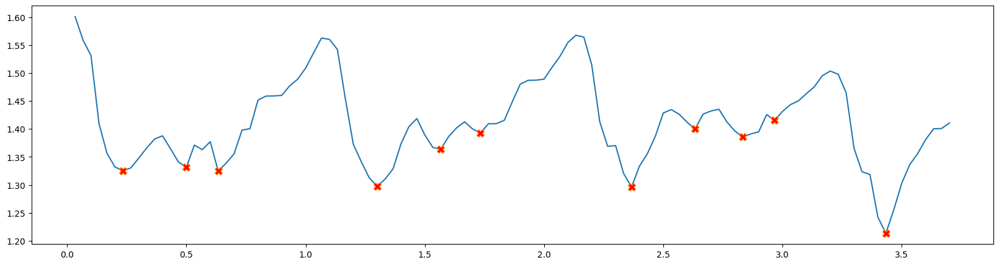

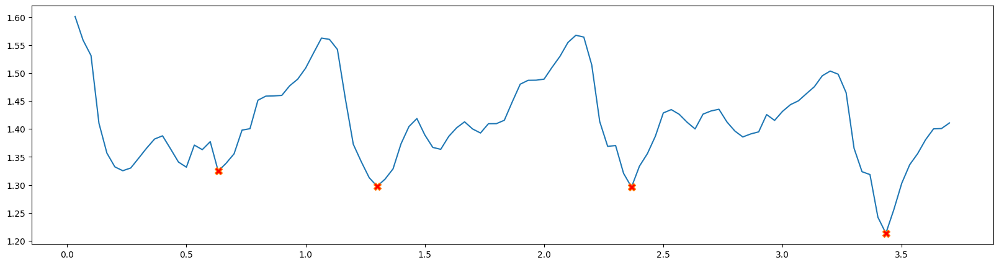

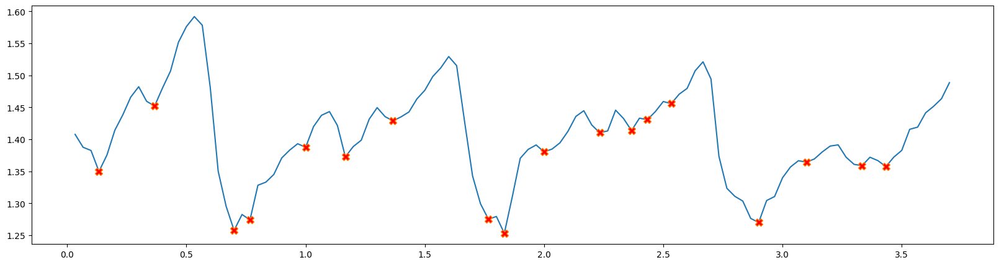

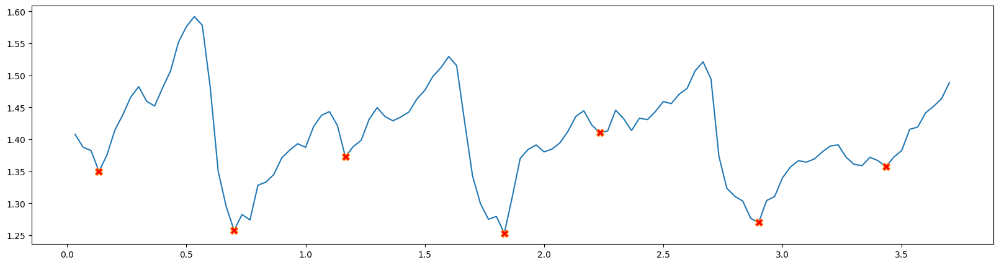

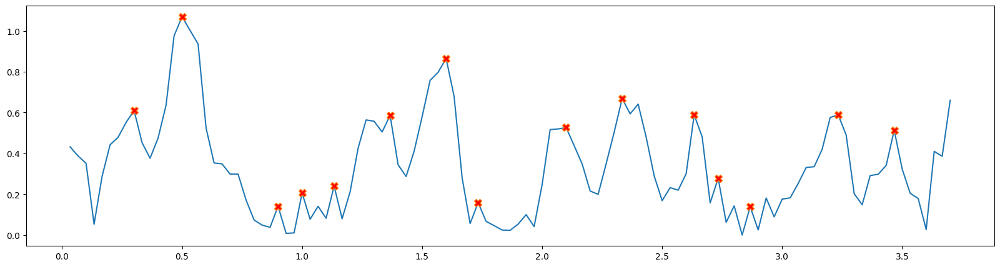

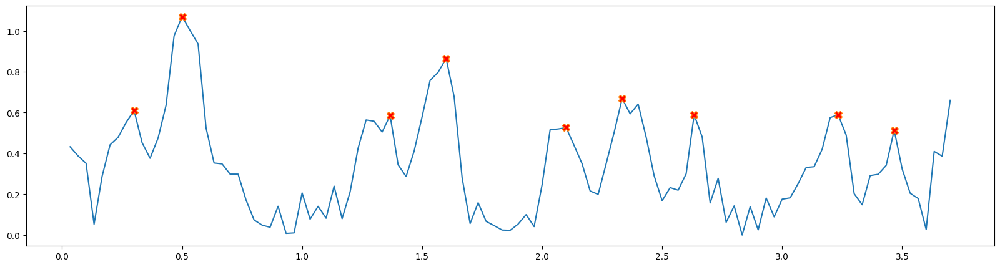

[38]
[39 44 54]
[36]
[40 47]
[38]
[39 44 54]
[36]
[40 47]
[70]
[54 61 68 79 85]
[58]
[62 69 78]
[70]
[54 61 68 79 85]
[58]
[62 69 78]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  1.066667  0.725783  1.297481  1.313077  0.138036  0.167407   
1    1.0  1.833333  0.594815  1.296075  1.311314  0.140394  0.144170   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  3.039828  0.097643  0.981524   0.986968   0.991960  0.979133  0.979486   
1  2.356665  0.119312  0.979730   0.989020   0.992297  0.982029  0.982509   

    visi_po   visi_sw  
0  0.999544  0.976554  
1  0.999354  0.980350  
front back sahan back 3
           t  count        sl        po        sw       flr       fll  \
0   0.033333    1.0  0.351112  3.397524  0.087135  0.137272 -0.137272   
1   0.066667    2.0  0.349409  1.901238  0.06

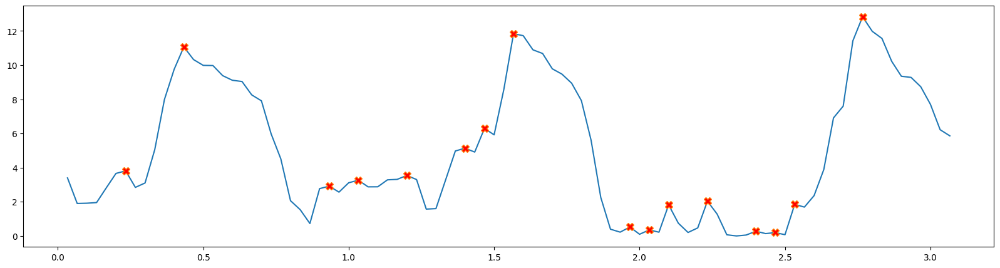

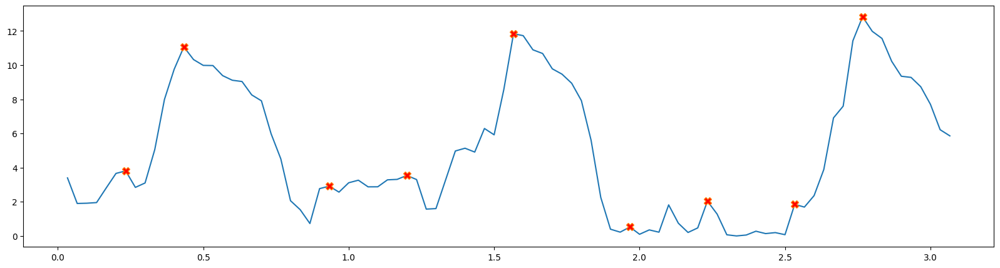

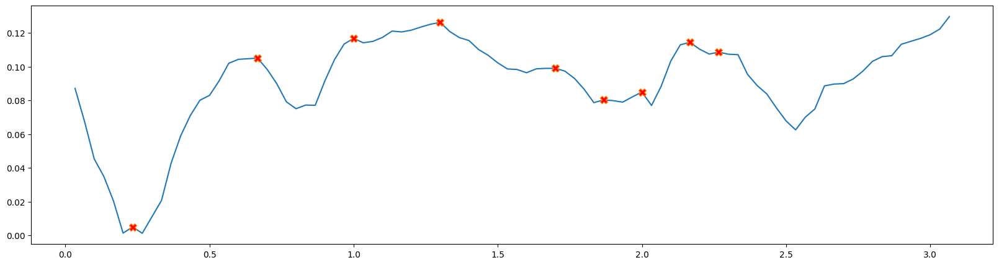

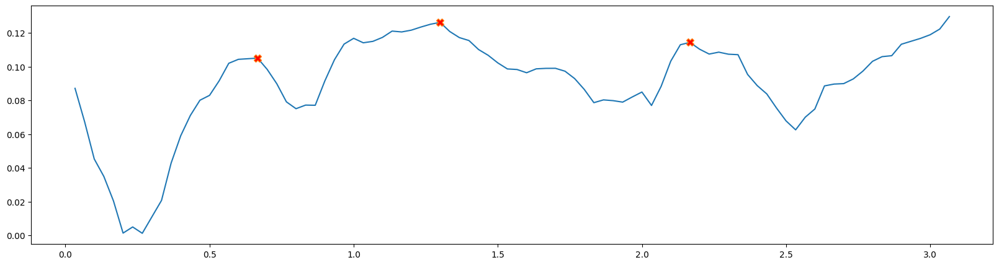

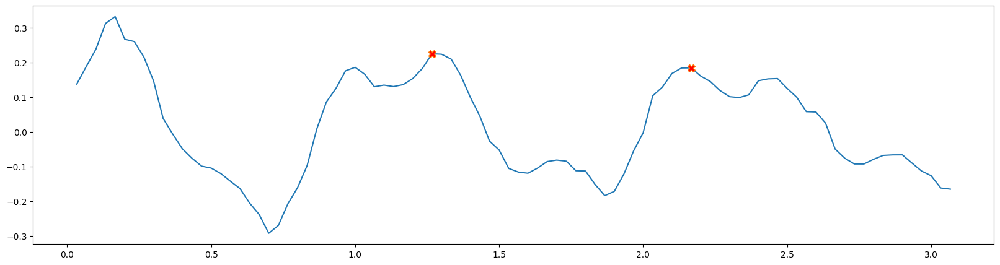

DETECTING GAIT___Foot lifting right


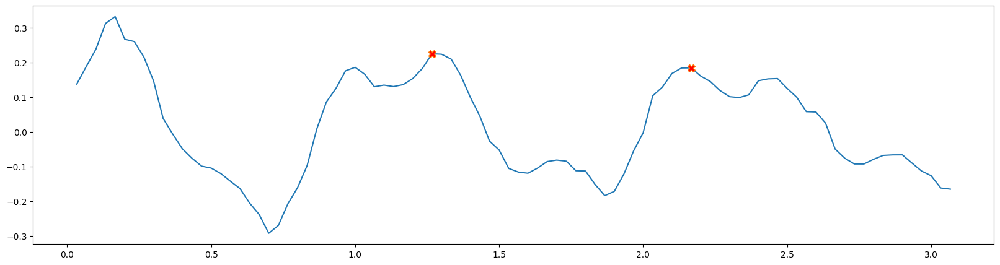

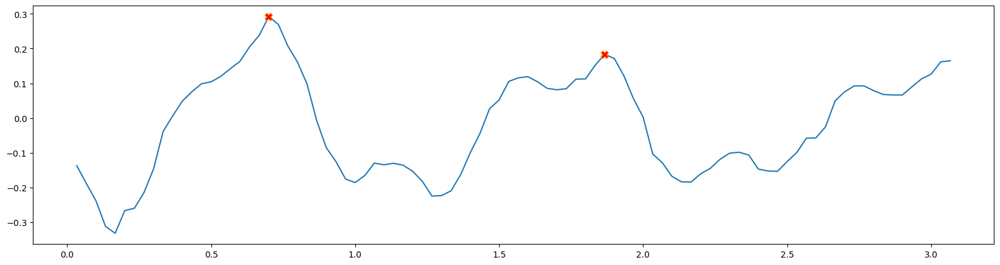

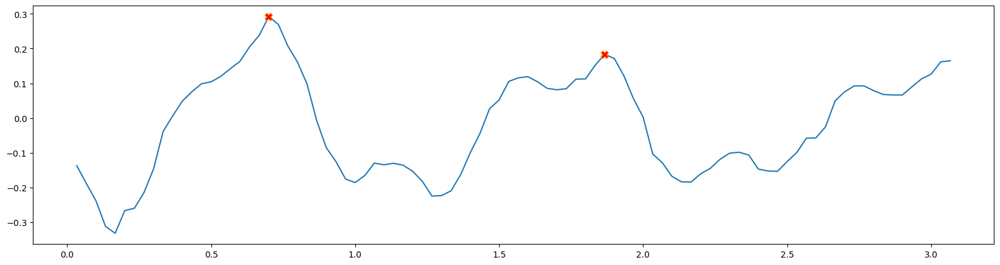

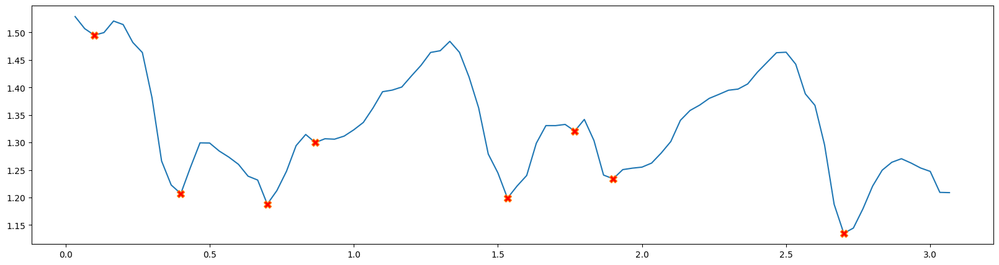

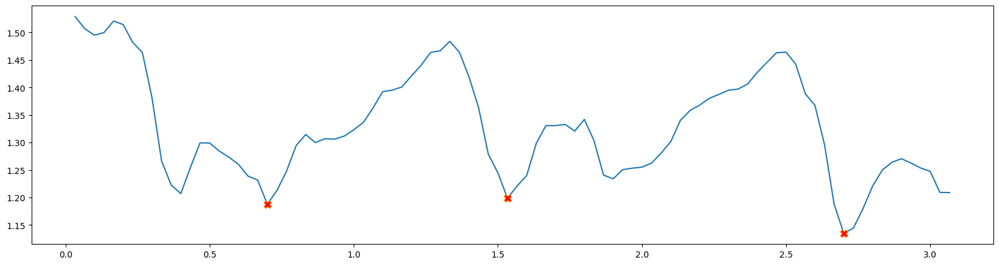

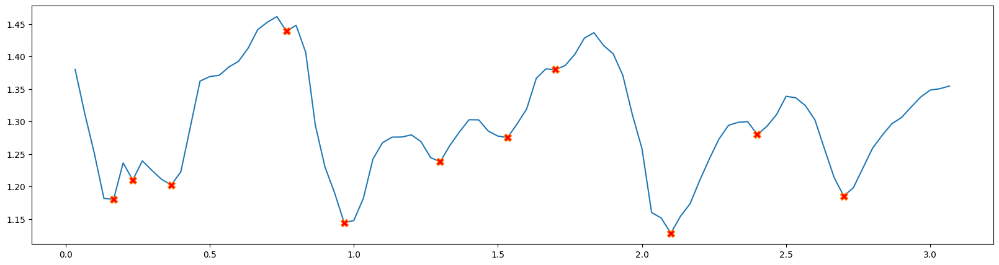

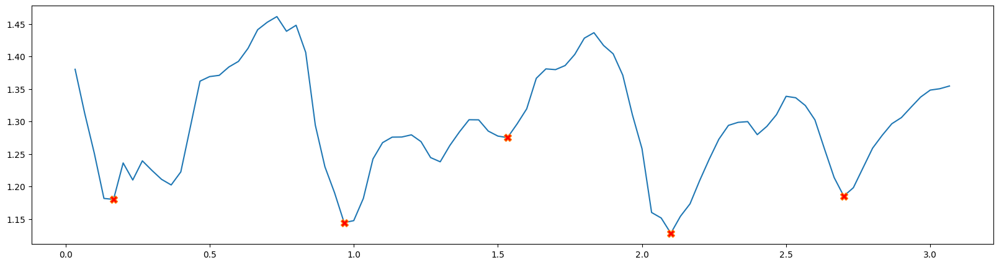

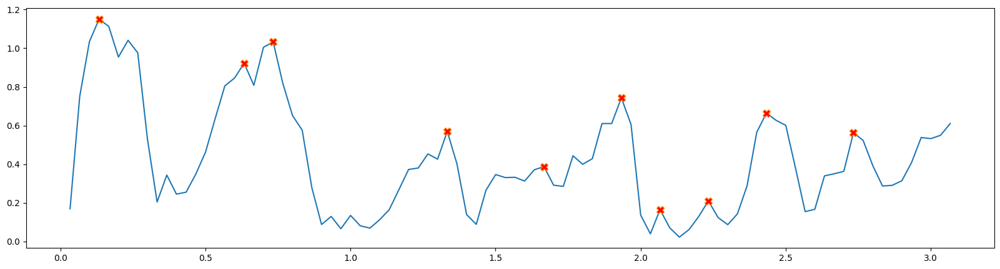

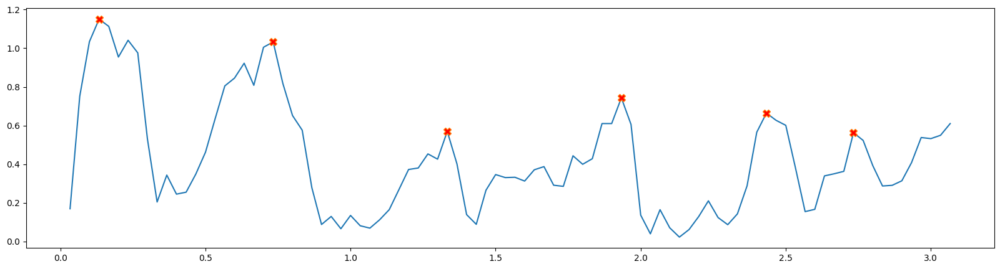

[55]
[46 58]
[38 64]
[39 57]
[55]
[46 58]
[38 64]
[39 57]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
   count      time       stl     hakr      hakl      flr       fll        po  \
0    0.0  1.266667  0.656375  1.19876  1.201558  0.20444  0.183744  6.182654   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll   visi_po  \
0  0.120311  0.983361   0.991974    0.99315  0.985259  0.983976  0.999651   

   visi_sw  
0  0.98429  
front back shimak back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.370482  0.410149  0.176064 -0.381355  0.381355   
1    0.066667    2.0  0.372285  1.467163  0.176687 -0.383300  0.383300   
2    0.100000    3.0  0.370302  2.192881  0.173585 -0.340660  0.340660   
3    0.133333    4.0  0.367789  2.765141  0.162056 -0.209356  0.209356   
4    0.166667    5.0  0.366540  0.560979  0.154666 -0.082499  0.082499   
..        ...    ...       ...       ...       ...       ...      

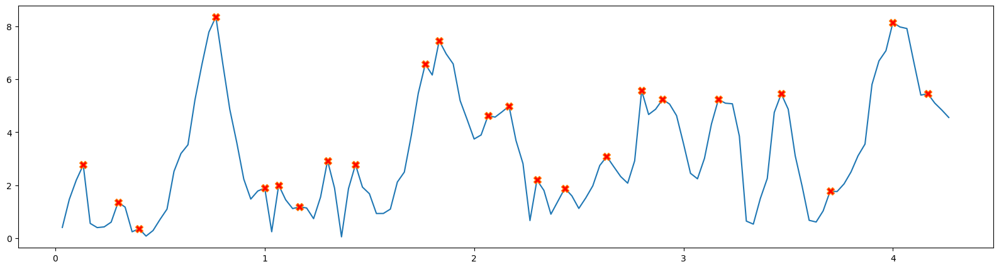

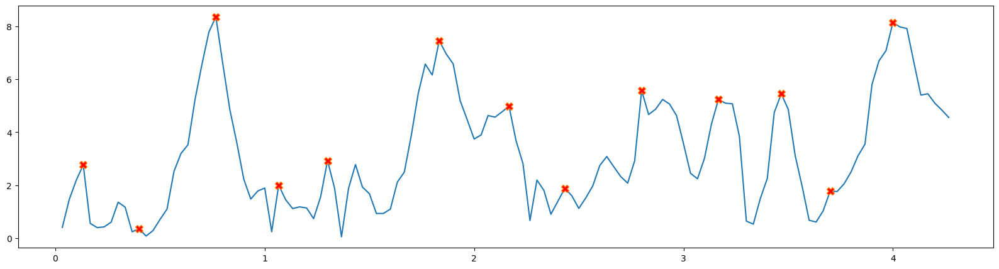

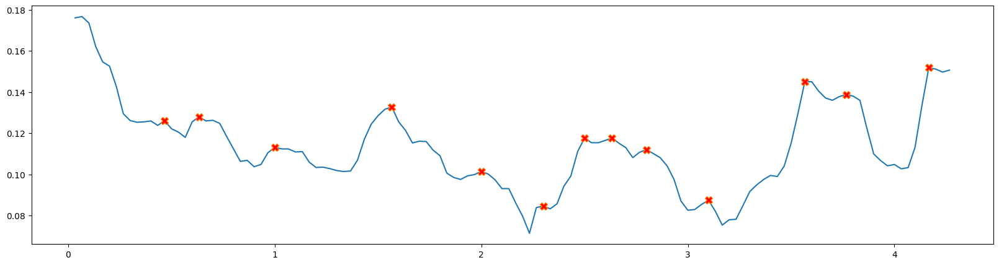

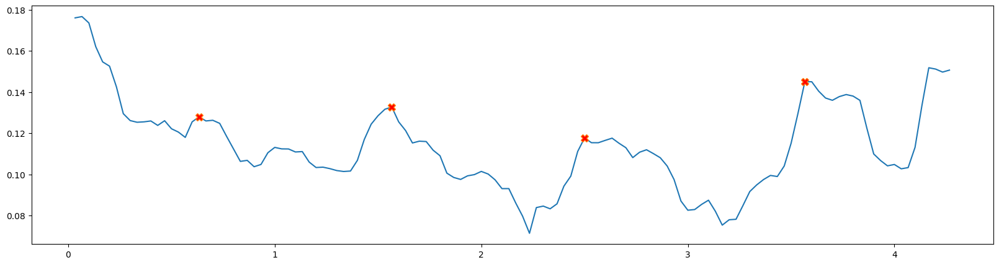

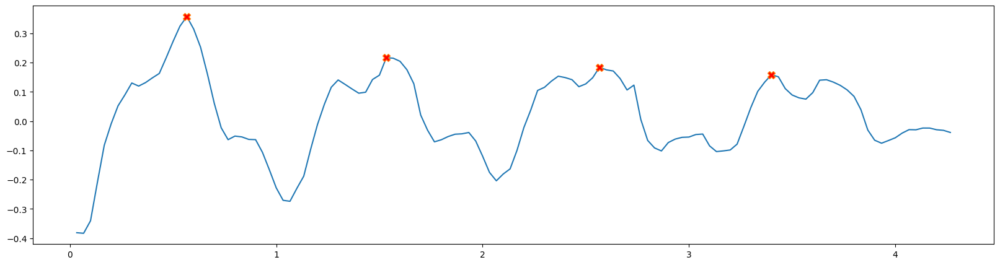

DETECTING GAIT___Foot lifting right


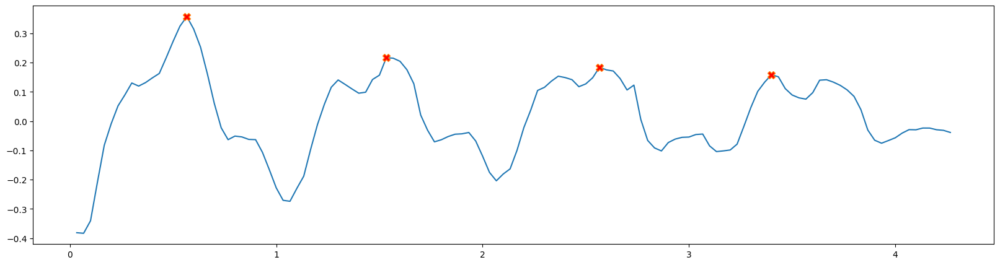

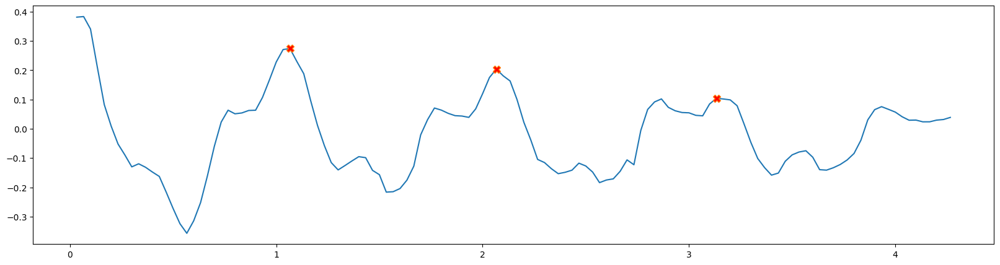

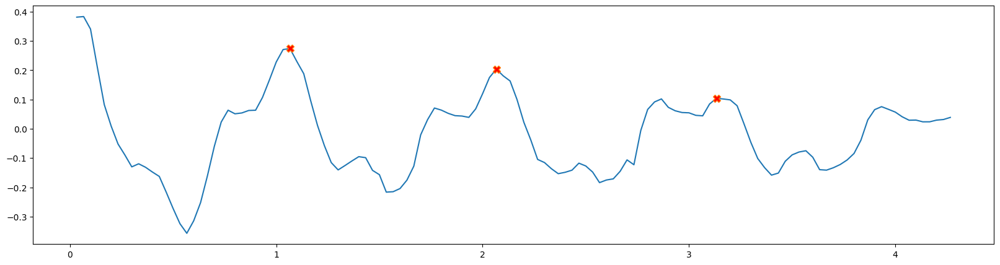

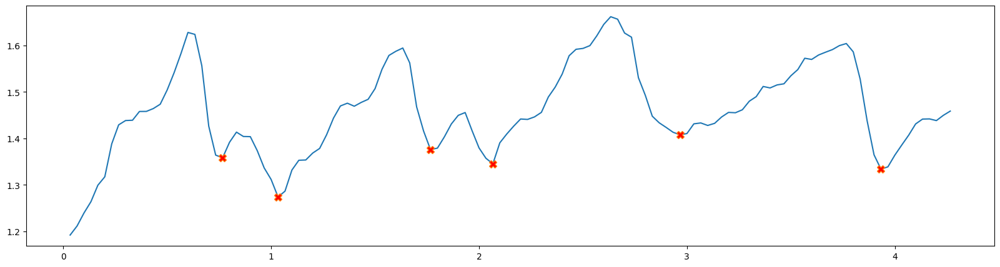

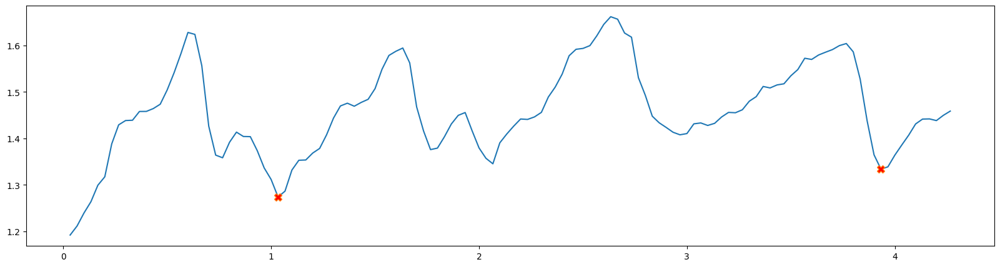

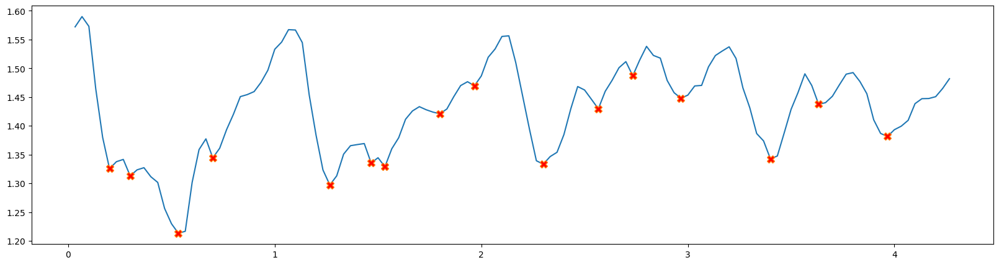

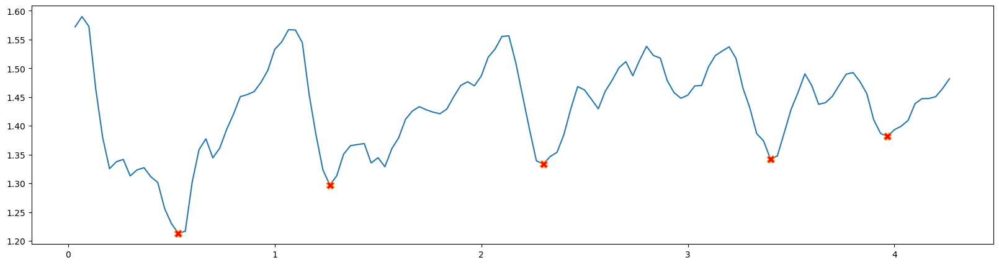

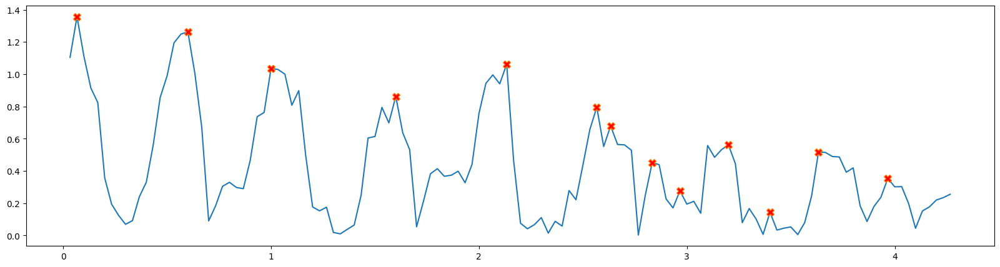

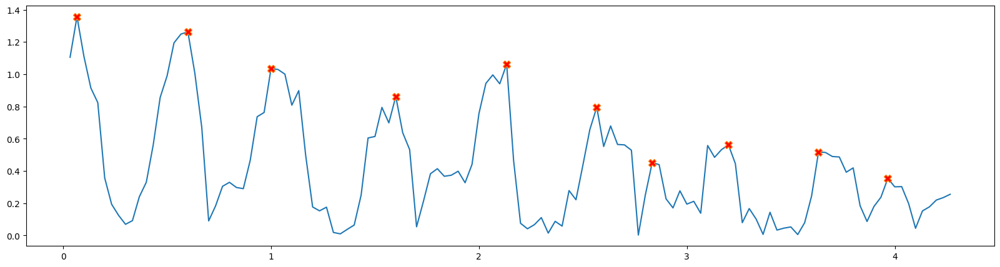

[31]
[22 31 38]
[18]
[17 29]
[31]
[22 31 38]
[18]
[17 29]
[61]
[54 64 72]
[46 74]
[47 63 76]
[61]
[54 64 72]
[46 74]
[47 63 76]
[93]
[83 94]
[]
[76 84 95]
[93]
[83 94]
[]
[76 84 95]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
0 2
1 2
2 2
3 2
4 2
5 2
6 2
7 2
8 2
9 2
10 2
11 2
12 2
13 2
14 2
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.566667  1.149331  1.274089  1.297149  0.286790  0.273907   
1    1.0  1.533333  0.906354  1.345388  1.333309  0.200250  0.204003   
2    2.0  2.566667  0.602823  1.407737  1.342463  0.171216  0.104191   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  4.429007  0.127960  0.974953   0.987565   0.993267  0.976434  0.979047   
1  4.774335  0.125207  0.982905   0.986632   0.992568  0.984357  0.981846   
2  5.403184  0.117580  0.981236   0.980338   0.988278  0.979946  0.975151   

    visi_po   visi_sw  
0

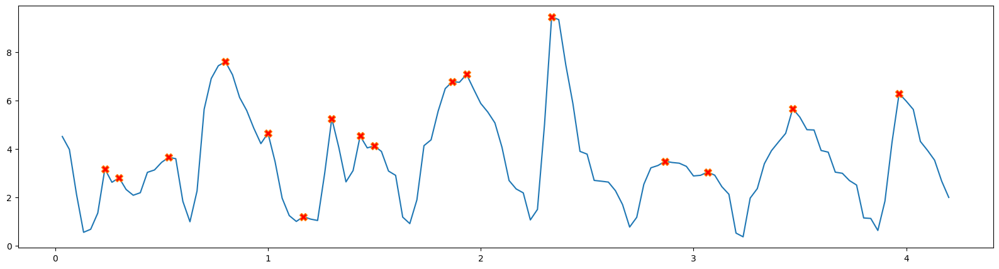

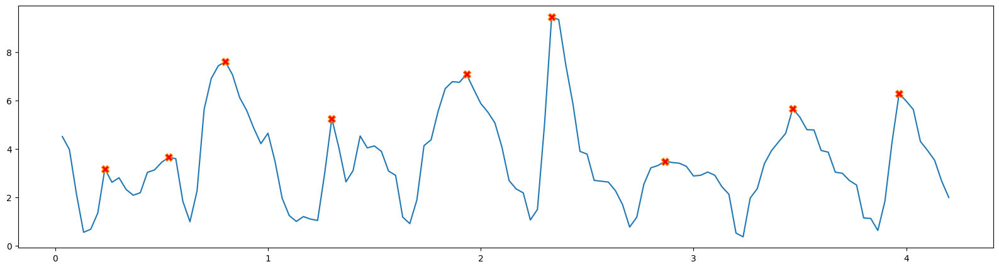

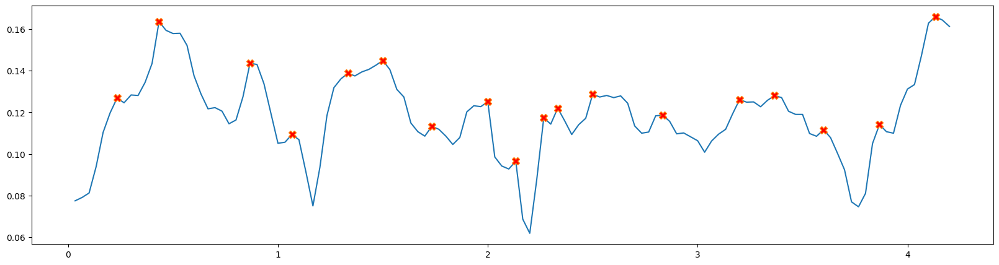

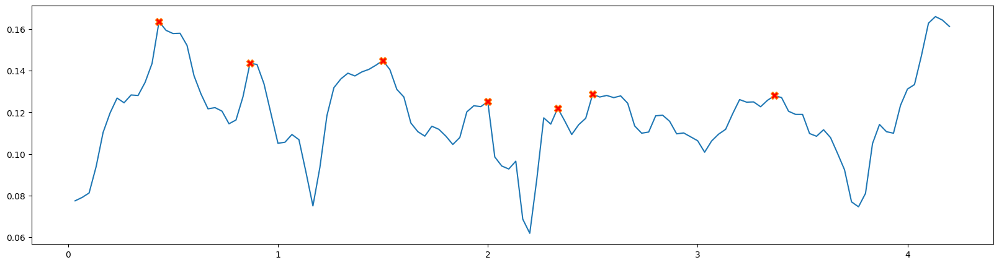

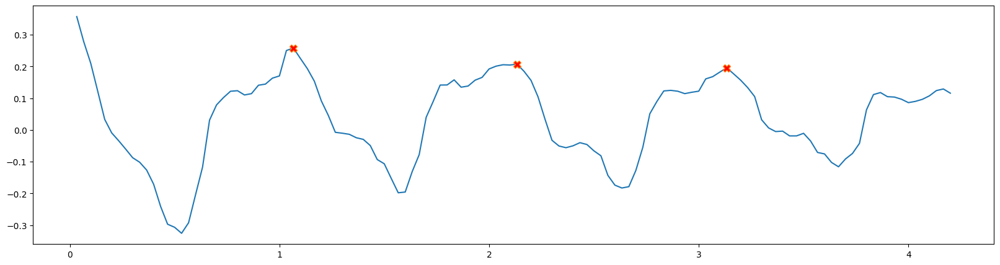

DETECTING GAIT___Foot lifting right


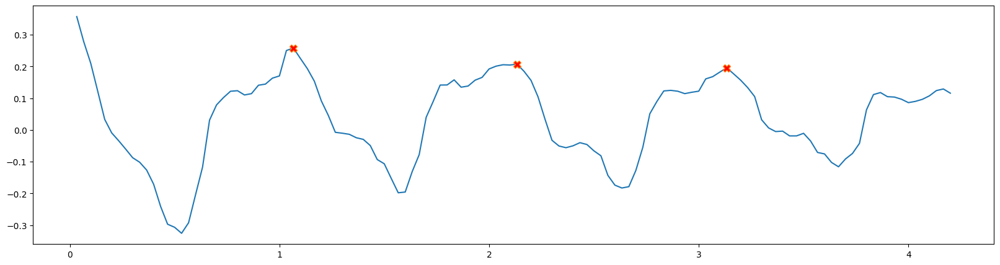

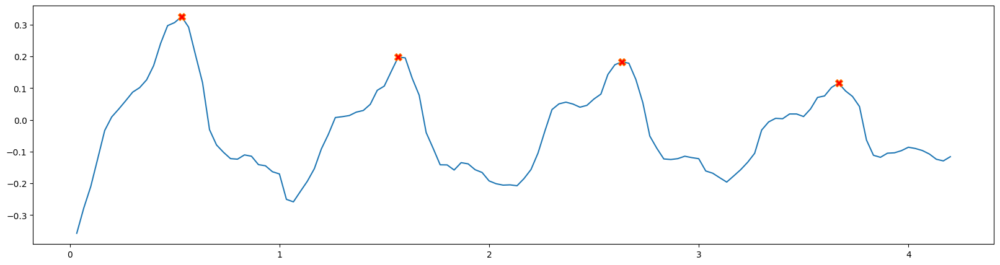

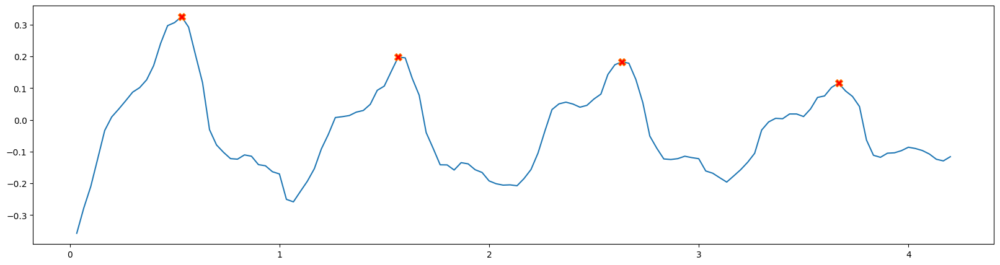

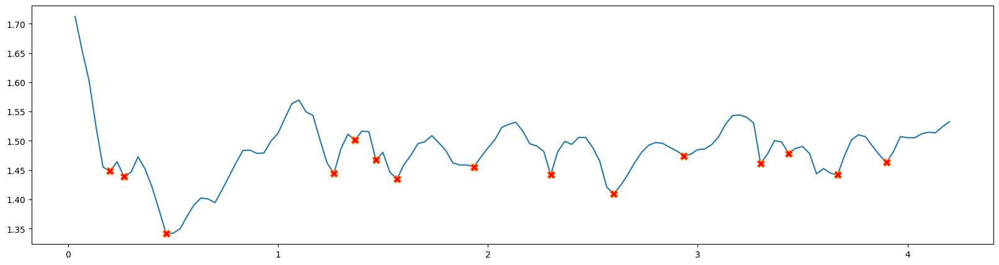

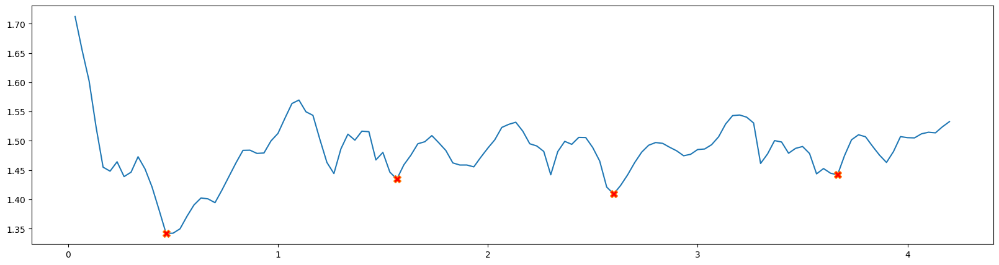

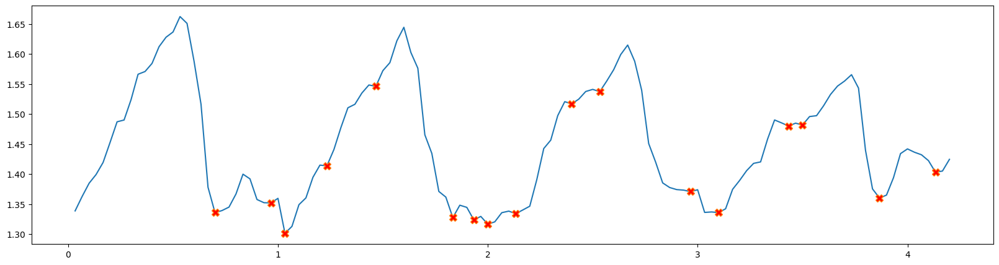

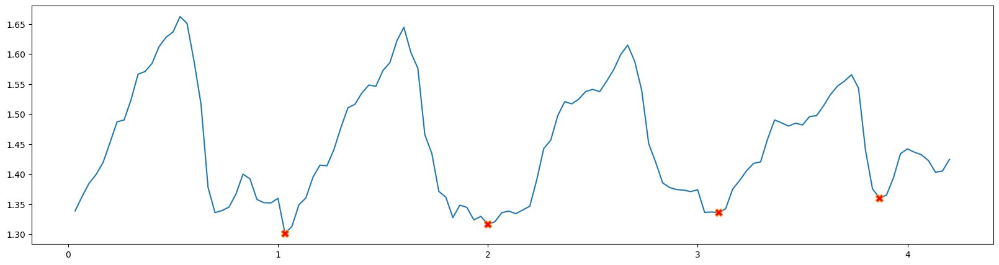

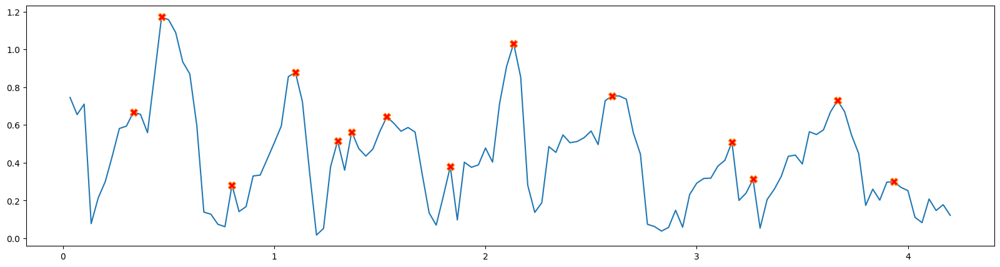

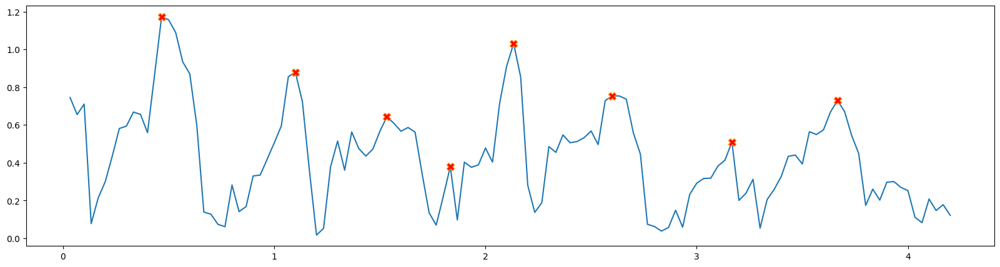

[46]
[38 57]
[44 59]
[32 45 54 63]
[46]
[38 57]
[44 59]
[32 45 54 63]
[78]
[69 85]
[69 74]
[63 77]
[78]
[69 85]
[69 74]
[63 77]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  1.066667  0.733138  1.434744  1.316392  0.232944  0.198154   
1    1.0  2.133333  0.892713  1.409241  1.335802  0.201726  0.183066   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  6.165928  0.134983  0.976315   0.983401   0.990857  0.976400  0.973321   
1  6.470808  0.125356  0.978315   0.983588   0.991792  0.981027  0.975685   

    visi_po   visi_sw  
0  0.999200  0.976876  
1  0.999124  0.978421  
front back idunil back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.368076  1.040409  0.090685  0.259809 -0.259809   
1    0.066667    2.0  0.367660  1.581981  0.0665

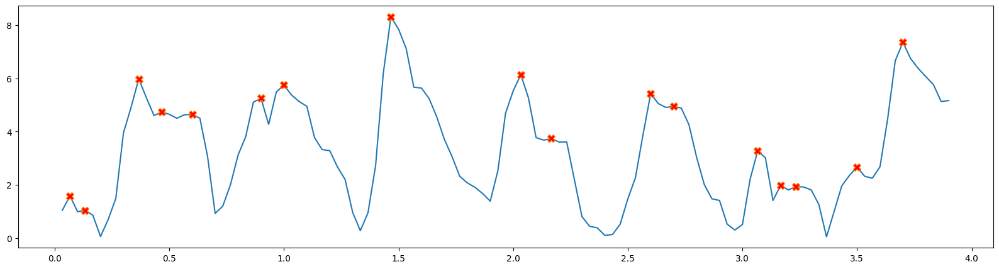

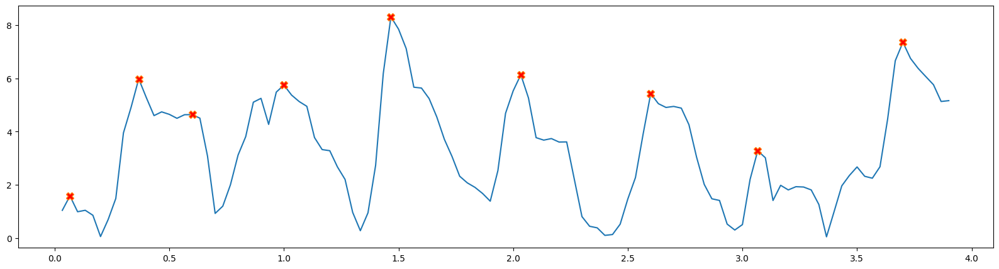

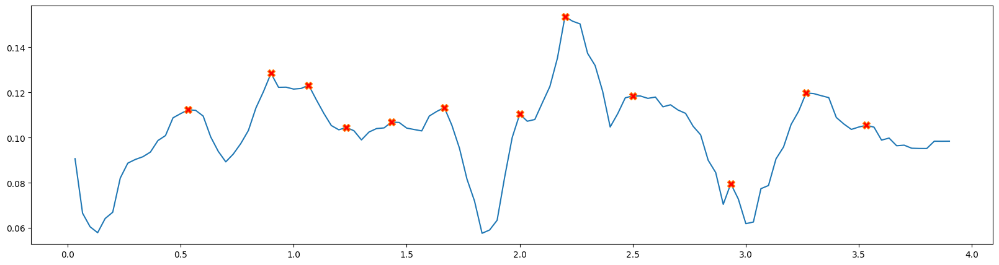

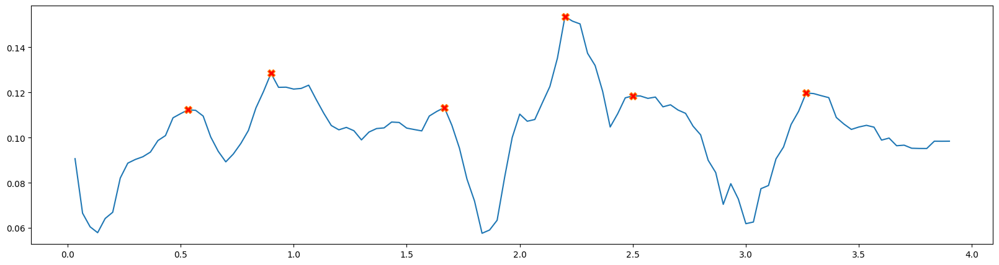

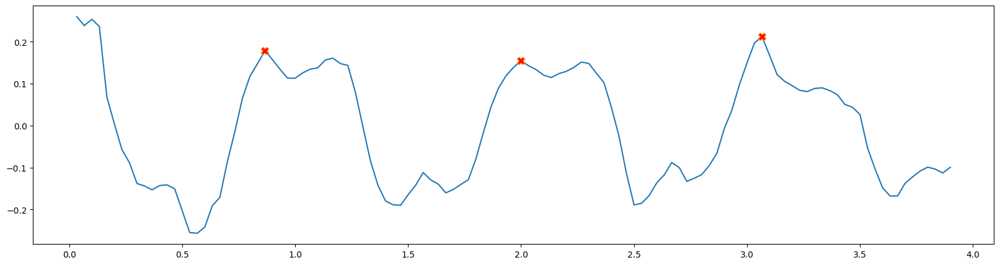

DETECTING GAIT___Foot lifting right


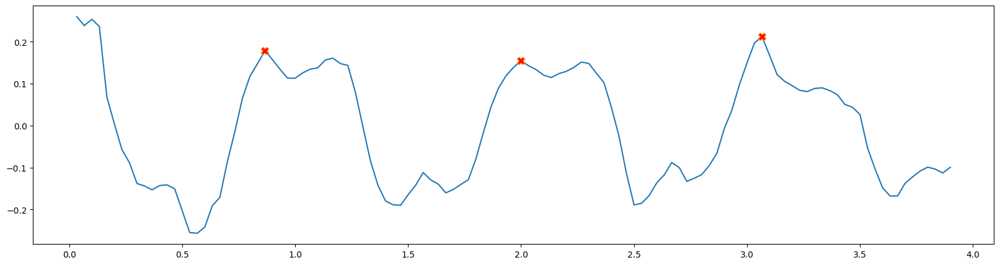

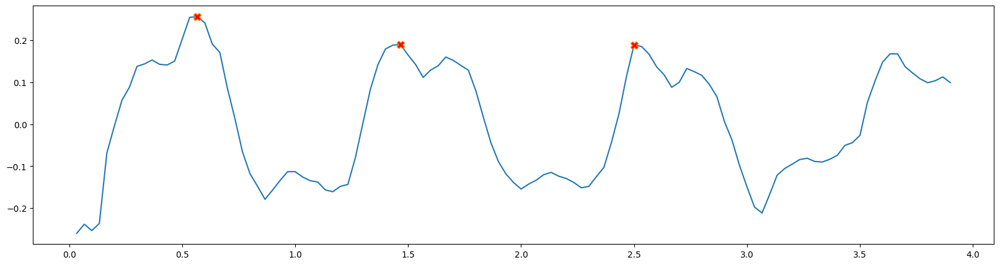

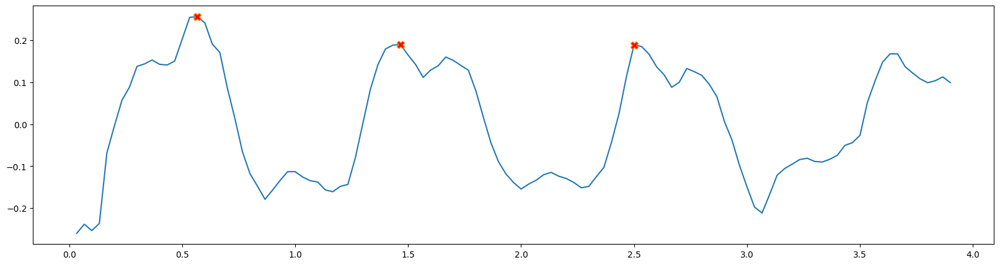

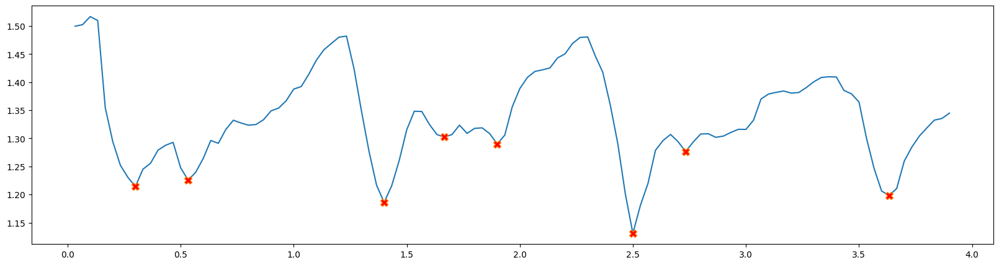

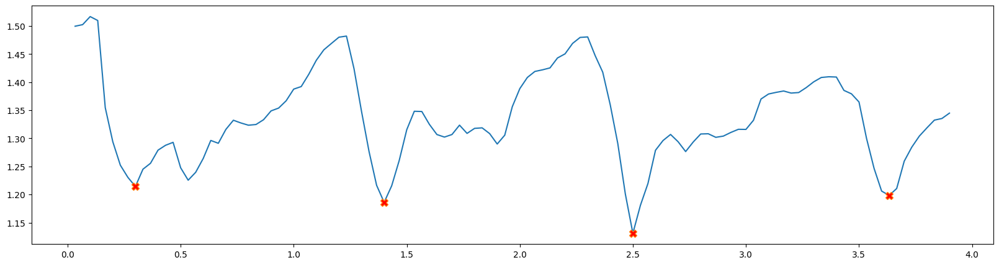

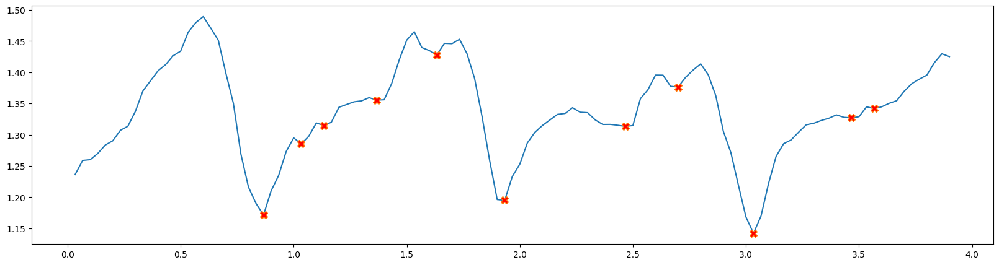

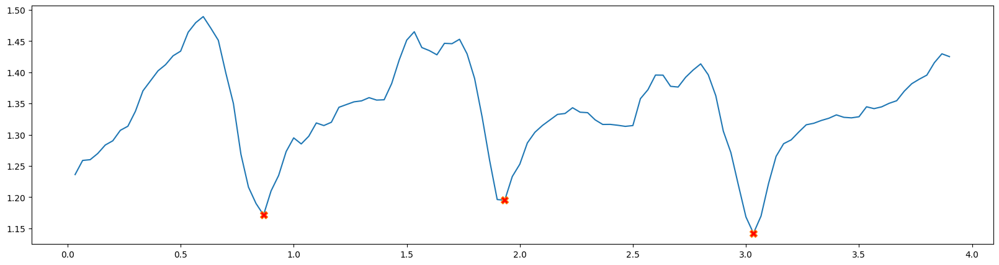

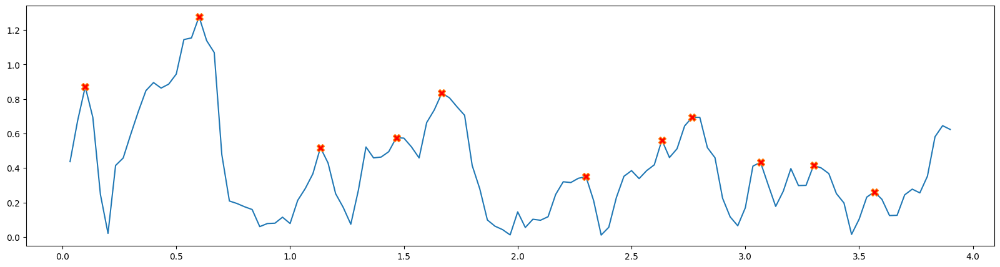

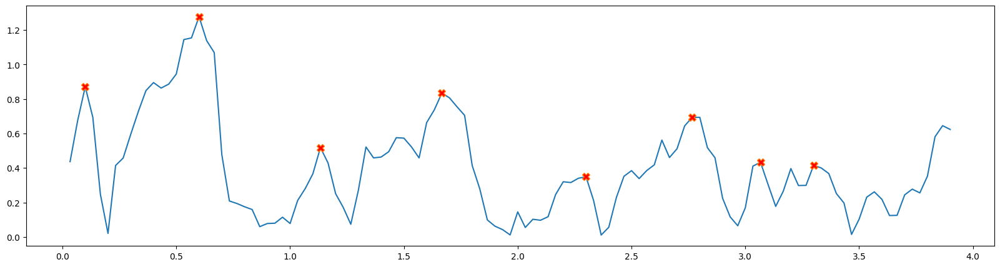

[43]
[29 43]
[26 49]
[33 49]
[43]
[29 43]
[26 49]
[33 49]
[74]
[60 77 91]
[65 74]
[68 82 91]
[74]
[60 77 91]
[65 74]
[68 82 91]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.866667  0.675883  1.186145  1.183328  0.166625  0.189718   
1    1.0  2.000000  0.491938  1.131073  1.142168  0.182958  0.188944   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  7.035694  0.120874  0.982388   0.988494   0.994034  0.985901  0.982293   
1  4.950454  0.136021  0.985527   0.989579   0.995101  0.988274  0.982668   

    visi_po   visi_sw  
0  0.999394  0.982696  
1  0.999541  0.981341  
front back Nipun back 3
            t  count        sl        po        sw       flr       fll  \
0    0.033333    1.0  0.359222  2.201706  0.164742 -0.146063  0.146063   
1    0.066667    2.0  0.363509  1.152911  0.15647

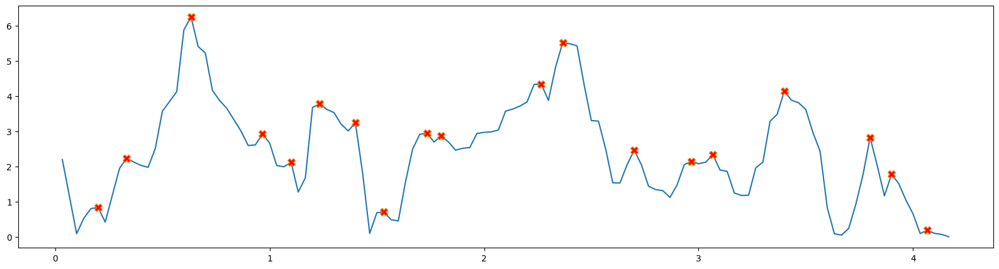

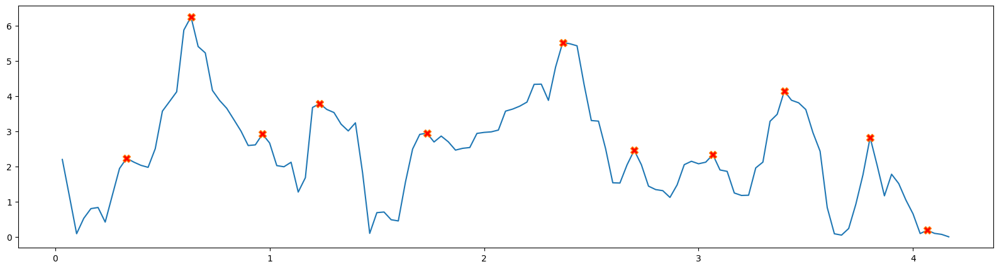

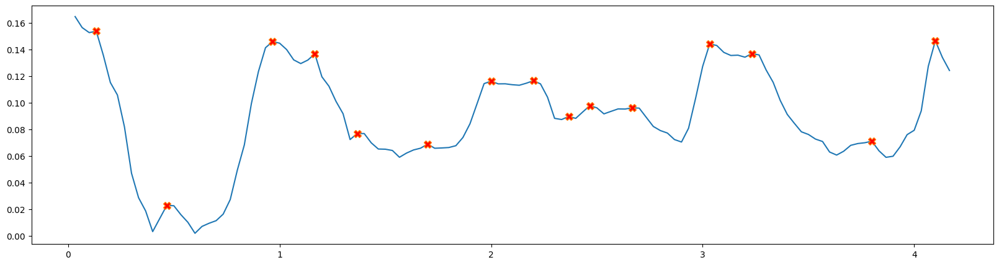

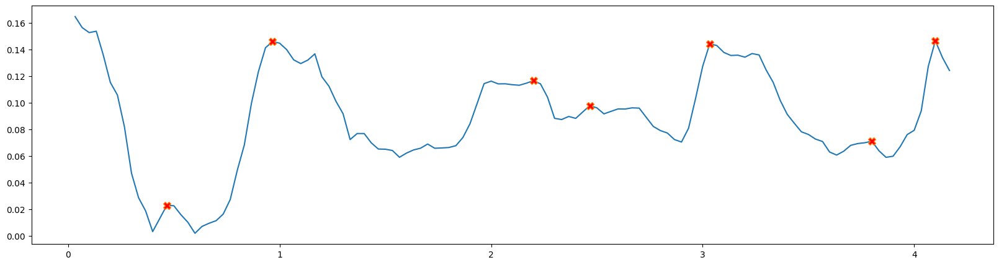

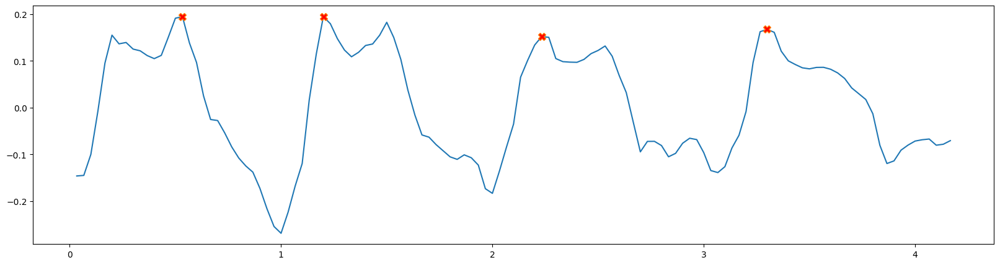

DETECTING GAIT___Foot lifting right


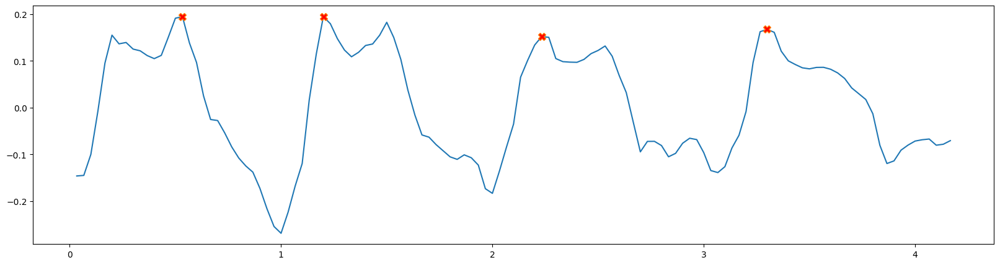

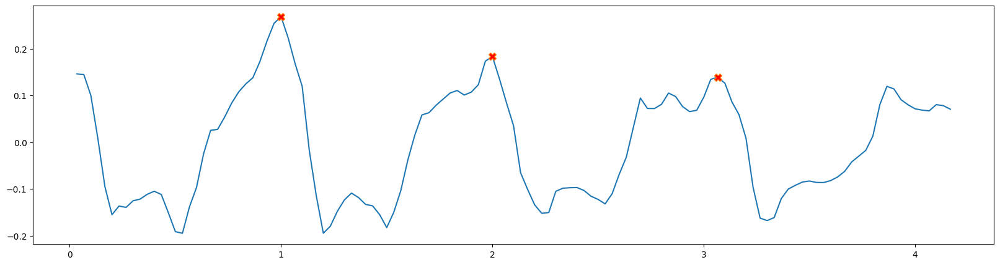

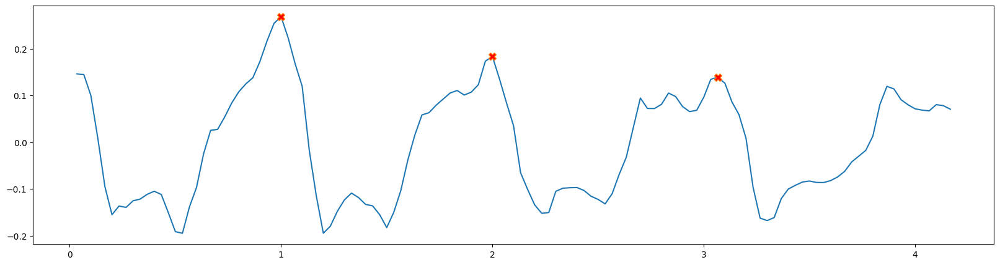

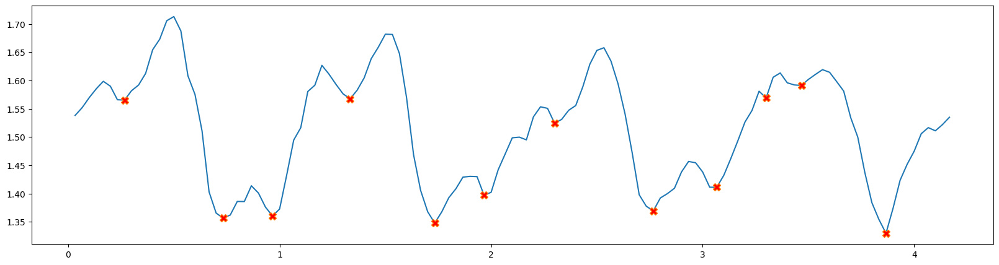

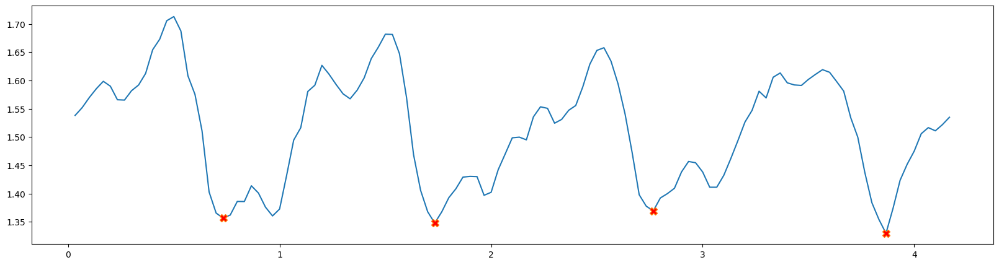

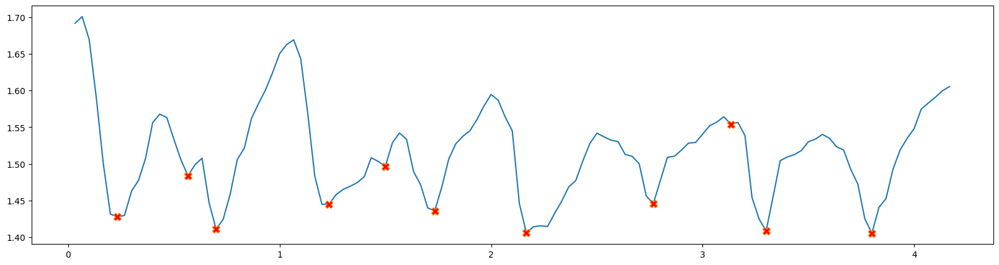

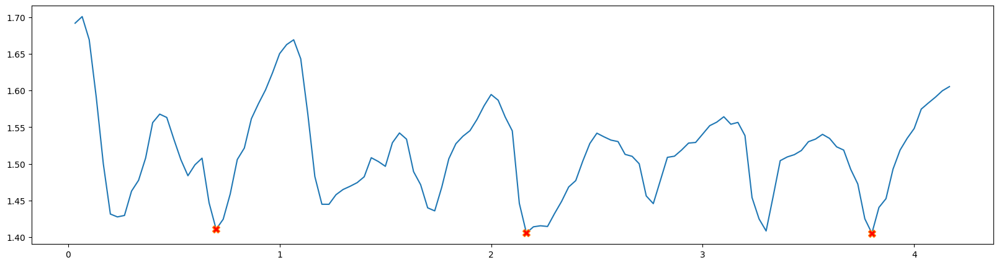

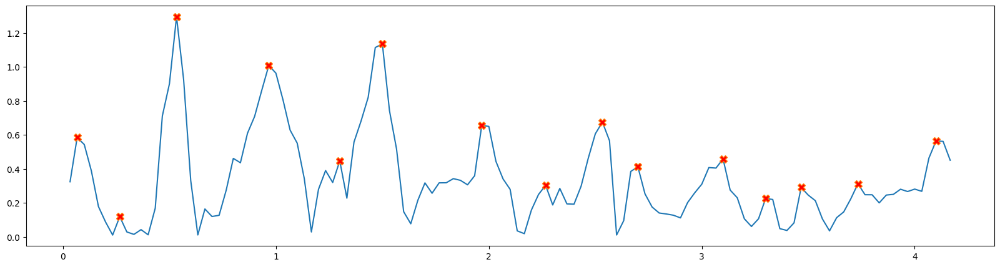

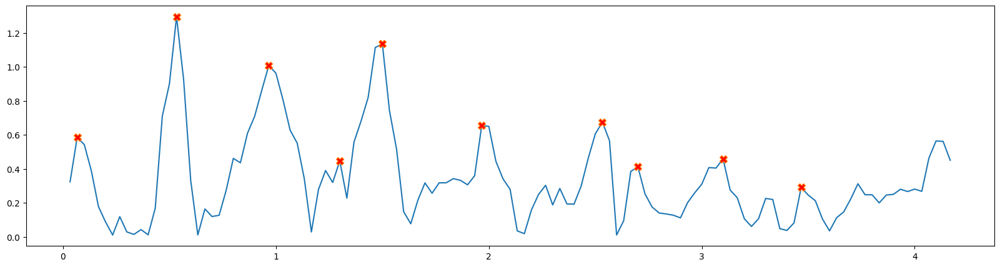

[29]
[18 28]
[28]
[15 28]
[29]
[18 28]
[28]
[15 28]
[59]
[36 51]
[65]
[38 44 58]
[59]
[36 51]
[65]
[38 44 58]
[91]
[70 80 91]
[73 90]
[75 80 92]
[91]
[70 80 91]
[73 90]
[75 80 92]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
0 1
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
0 2
1 2
2 2
3 2
4 2
5 2
6 2
7 2
8 2
9 2
10 2
11 2
12 2
13 2
14 2
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  0.533333  1.151556  1.356470  1.410994  0.194800  0.268664   
1    1.0  1.200000  0.745727  1.347730  1.405938  0.173429  0.183222   
2    2.0  2.233333  0.514858  1.369359  1.408632  0.159907  0.138767   

         po        sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  4.586177  0.145925  0.911081   0.960308   0.942115  0.920921  0.950108   
1  3.368284  0.116557  0.976434   0.990595   0.993155  0.976598  0.983075   
2  3.441599  0.120997  0.982685   0.989730   0.990140  0.986781  0.982621   

    visi_po   visi_sw  
0  

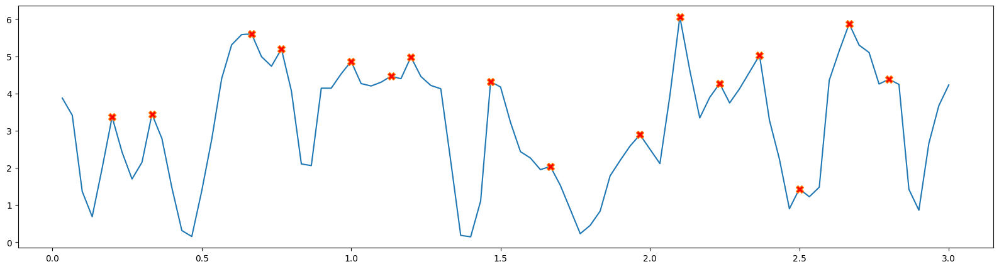

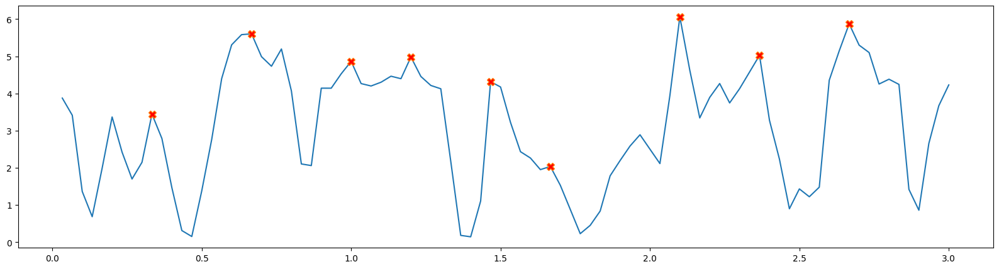

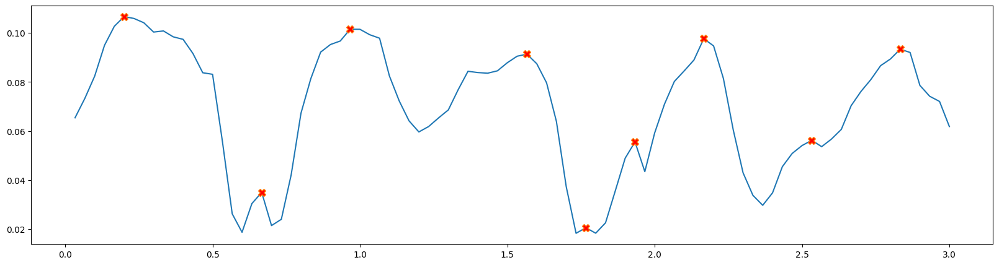

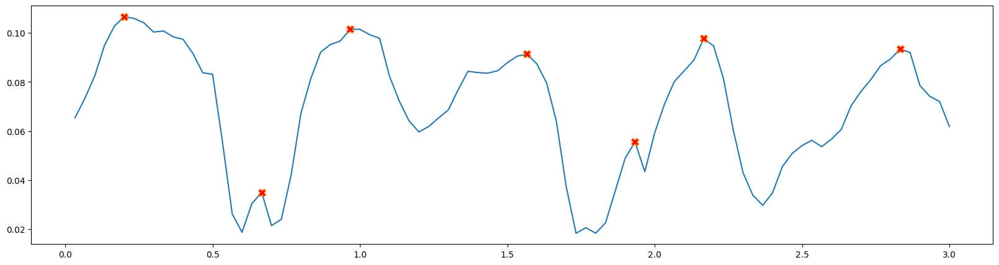

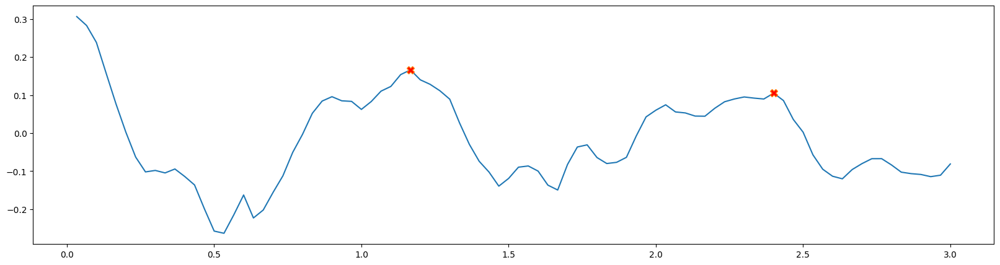

DETECTING GAIT___Foot lifting right


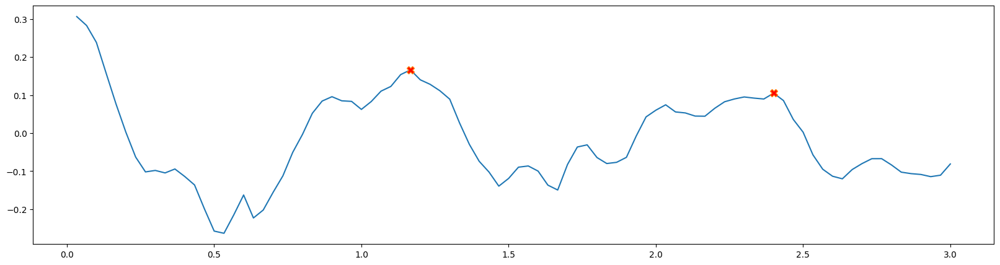

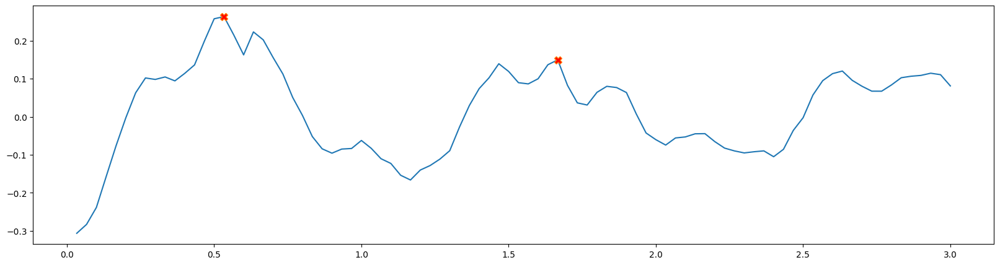

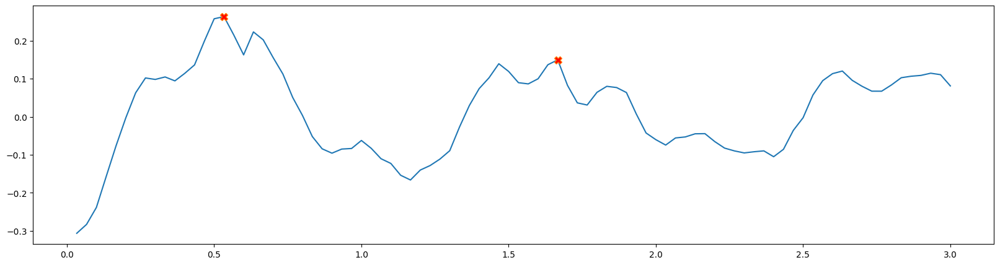

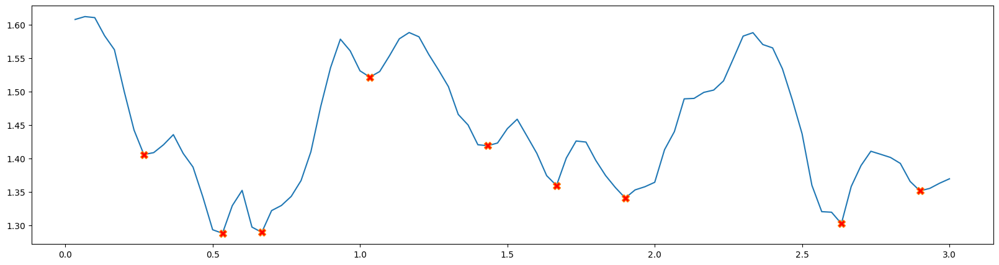

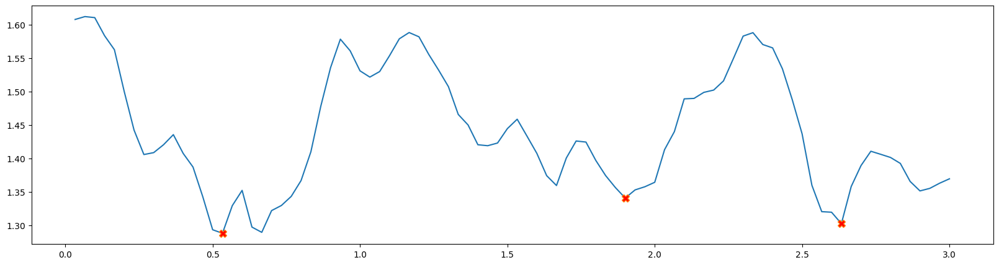

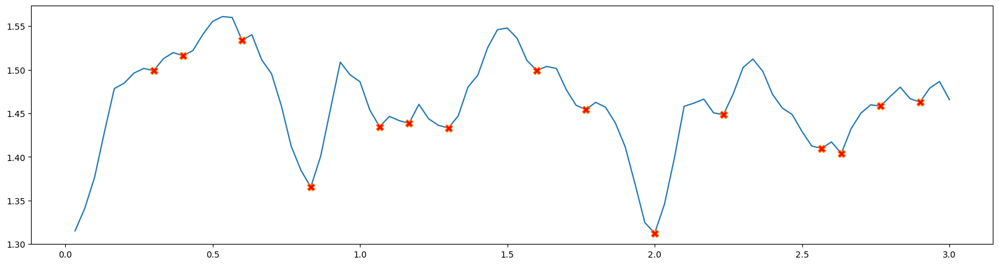

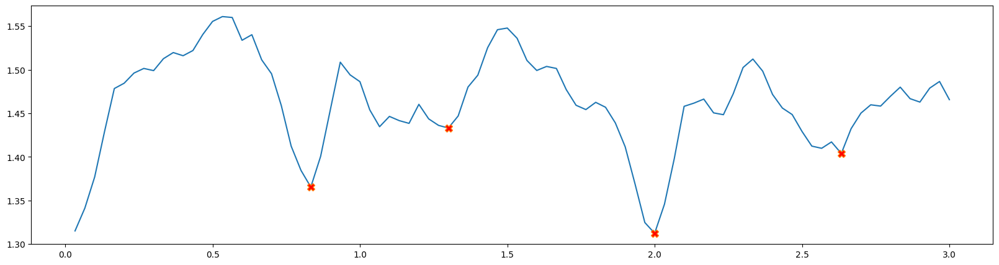

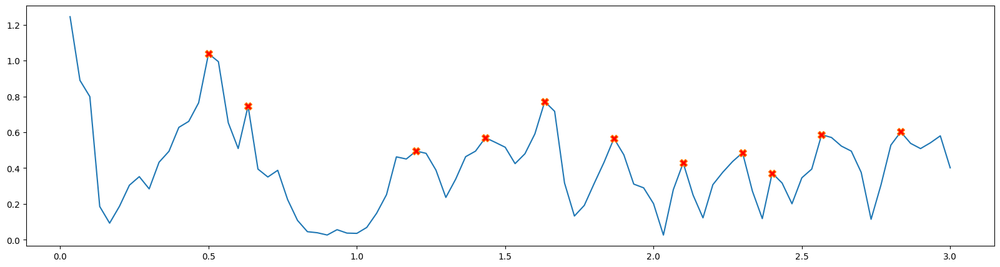

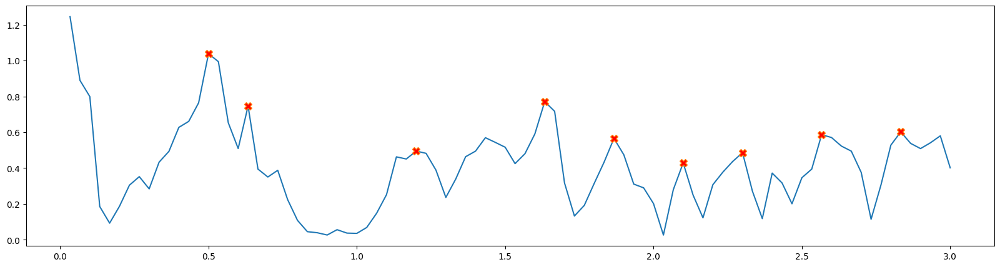

[49]
[35 43 49 62 70]
[46 57 64]
[35 48 55 62 68]
[49]
[35 43 49 62 70]
[46 57 64]
[35 48 55 62 68]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
   count      time       stl      hakr      hakl       flr       fll  \
0    0.0  1.166667  0.549427  1.340483  1.372656  0.135599  0.149441   

         po       sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  \
0  4.484865  0.08153  0.974162   0.981529   0.989101  0.970856  0.978714   

    visi_po  visi_sw  
0  0.999293  0.97793  
front back vibhu back 3
           t  count        sl        po        sw       flr       fll  \
0   0.033333    1.0  0.347276  2.786392  0.098071  0.308811 -0.308811   
1   0.066667    2.0  0.346672  2.997725  0.102393  0.253314 -0.253314   
2   0.100000    3.0  0.346732  2.787383  0.118325  0.135186 -0.135186   
3   0.133333    4.0  0.348112  4.466867  0.133160  0.035514 -0.035514   
4   0.166667    5.0  0.352996  4.548233  0.133238 -0.034610  0.034610   
..       ...    ...       ...

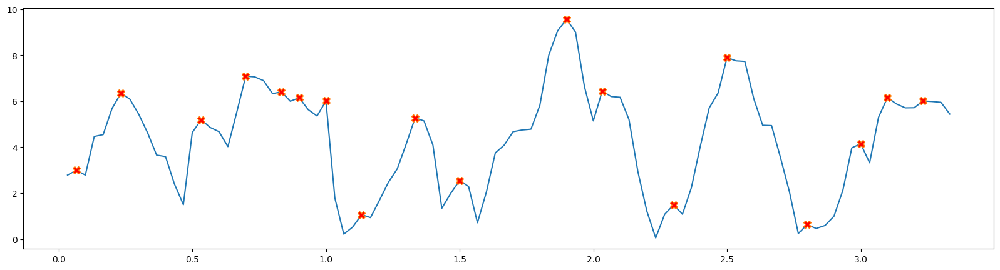

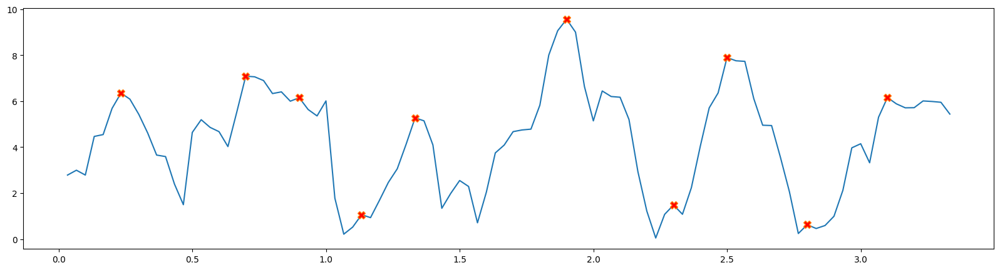

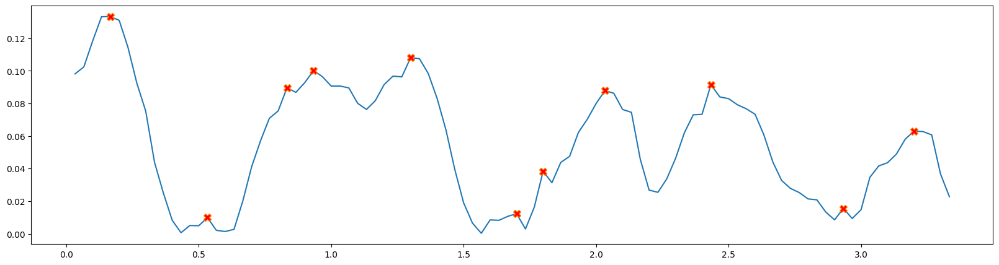

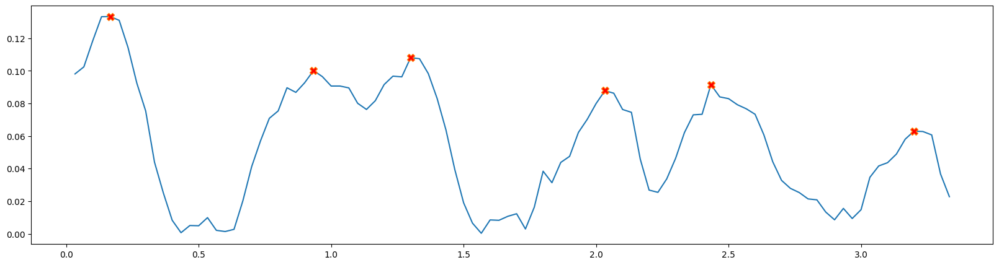

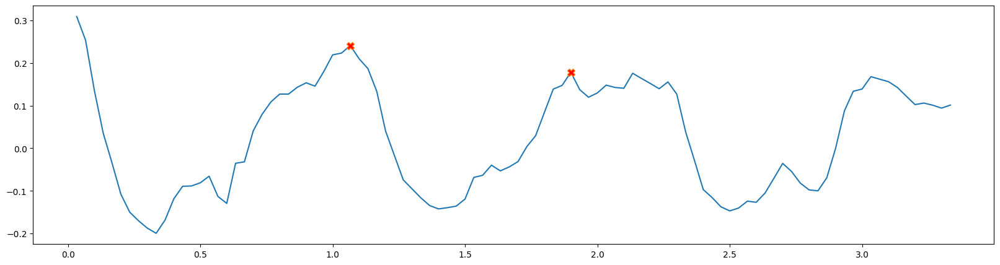

DETECTING GAIT___Foot lifting right


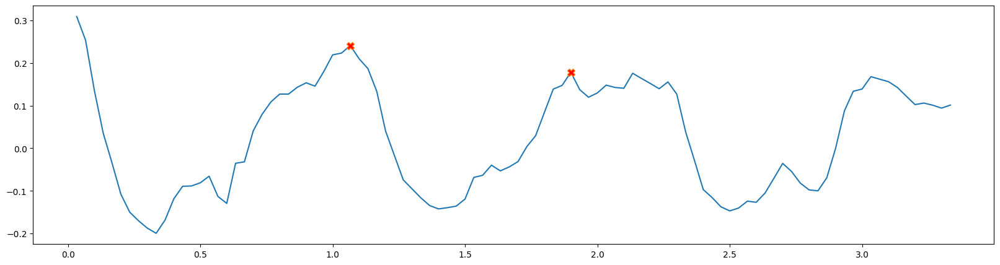

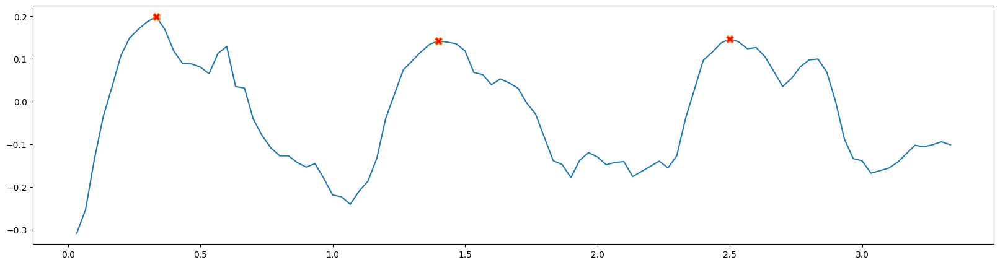

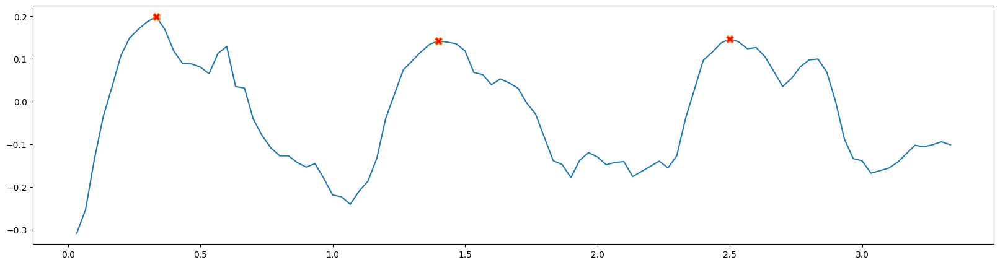

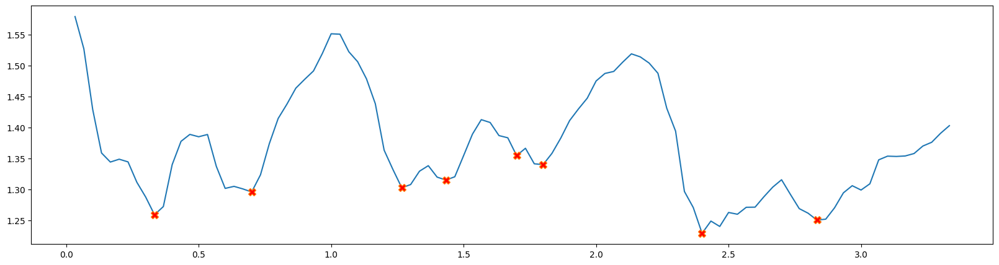

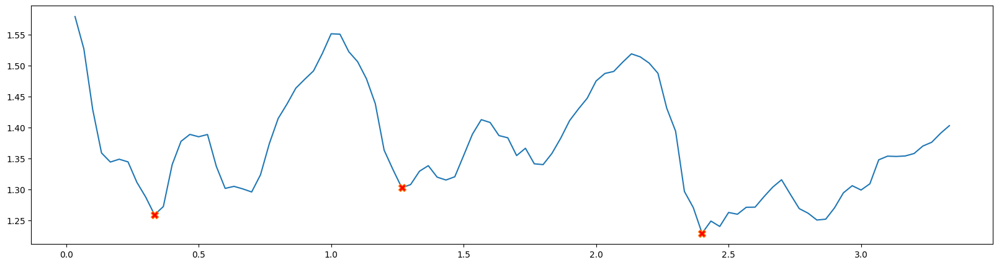

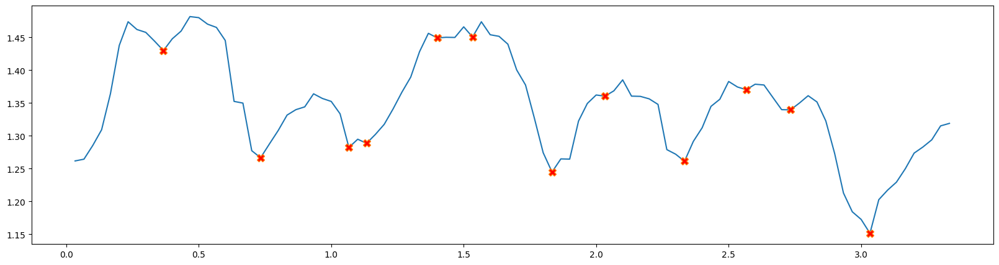

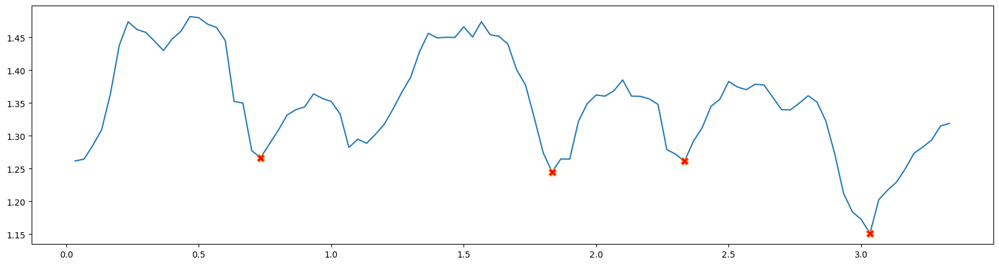

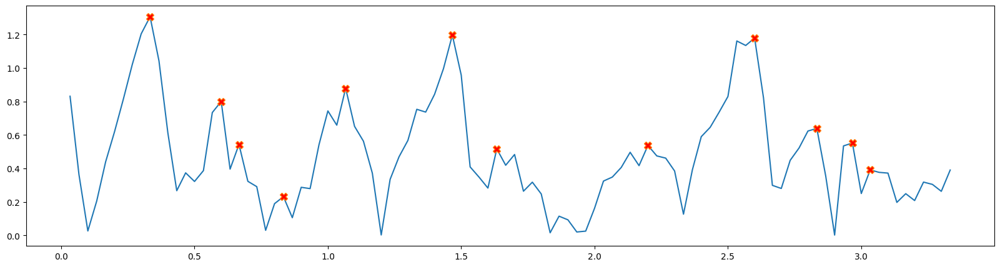

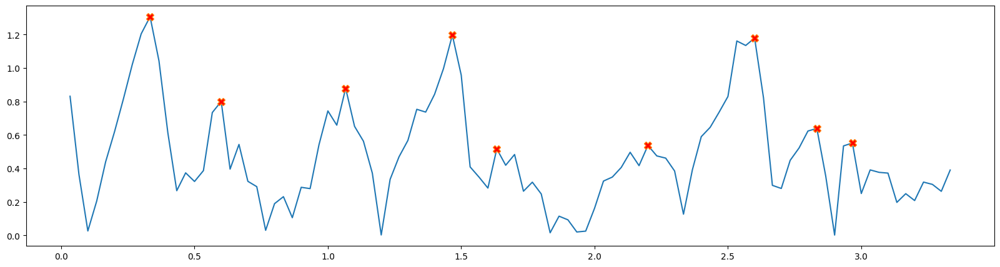

[41]
[33 39 56]
[38]
[31 43 48]
[41]
[33 39 56]
[38]
[31 43 48]
0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 0
11 0
12 0
13 0
14 0
   count      time       stl      hakr      hakl       flr       fll       po  \
0    0.0  1.066667  0.864279  1.302611  1.245002  0.209587  0.142144  5.29975   

         sw  visi_stl  visi_hakr  visi_hakl  visi_flr  visi_fll  visi_po  \
0  0.108061  0.947685   0.986336   0.964363  0.945152  0.974223  0.99892   

    visi_sw  
0  0.972267  
front back ishin back 3


In [57]:
for idx in range(len(name_list)):
    name=name_list[idx]
    f_file = open('new_key_arrays_all/new_test_key_arrays/{}/{}/key_array_{}_{}_{}.pkl'.format(cam,direction,name,direction,vid_no), 'rb')
    
    key_array = pickle.load(f_file)
    f_file.close()
    
    H=[]
    for i in range(len(key_array)):
        #time
        t=key_array[i][12][3]
    
        #upper body height
        x1,x2 = (((key_array[i][11][0]+key_array[i][12][0])/2),((key_array[i][23][0]+key_array[i][24][0])/2))
        y1,y2 = (((key_array[i][11][1]+key_array[i][12][1])/2),((key_array[i][23][1]+key_array[i][24][1])/2))
        #z1,z2 = (((key_array[i][11][2]+key_array[i][12][2])/2),((key_array[i][23][2]+key_array[i][24][2])/2))
        ubh = math.sqrt(((x1-x2)**2)+((y1-y2)**2))
        #ubh = math.sqrt(((x1-x2)**2)+((y1-y2)**2)+((z1-z2)**2))
    
        #shoulder length
        x_sl1,x_sl2 = (key_array[i][11][0],key_array[i][12][0])
        y_sl1,y_sl2 = (key_array[i][11][1],key_array[i][12][1])
        #z_sl1,z_sl2 = (key_array[i][11][2],key_array[i][12][2])
        sl=math.sqrt(((x_sl1-x_sl2)**2)+((y_sl1-y_sl2)**2))
        #sl=math.sqrt(((x_sl1-x_sl2)**2)+((y_sl1-y_sl2)**2)+((z_sl1-z_sl2)**2))
    
        #center of upper body in depth
        center=(key_array[i][11][2]+key_array[i][12][2]+key_array[i][23][2]+key_array[i][24][2])/4
    
        #right and left shoulders
        right=key_array[i][12][0]
        left=key_array[i][11][0]
    
        H.append([ubh])
        H[i].append(t)
        H[i].append(center)
        H[i].append(right)
        H[i].append(left)
        H[i].append(sl)
        H[i].append(sl/ubh)
   
    
    H_array = np.array(H)
    #print(H_array)

    df = pd.DataFrame(H_array,columns=['ubh','t','center','r_sdr','l_sdr','sl','sln'])
    #print(df)
    
    ##Parameter calculation
    PARA=[]

    count=0
    for i in range(len(key_array)):
        t=key_array[i][28][3]
        sl=shoulder_length(key_array[i][11][0],key_array[i][12][0],key_array[i][23][0],key_array[i][24][0],key_array[i][11][1],key_array[i][12][1],key_array[i][23][1],key_array[i][24][1])
        po=math.degrees(pelvic_obliquity(key_array[i][23][0],key_array[i][24][0],key_array[i][23][1],key_array[i][24][1]))
        sw=step_width(key_array[i][11][0],key_array[i][12][0],key_array[i][23][0],key_array[i][24][0],key_array[i][11][1],key_array[i][12][1],key_array[i][23][1],key_array[i][24][1],key_array[i][29][0],key_array[i][30][0])
        flr=foot_lifting(key_array[i][28][1],key_array[i][27][1],key_array[i][11][0],key_array[i][12][0],key_array[i][23][0],key_array[i][24][0],key_array[i][11][1],key_array[i][12][1],key_array[i][23][1],key_array[i][24][1])
        fll=foot_lifting(key_array[i][27][1],key_array[i][28][1],key_array[i][11][0],key_array[i][12][0],key_array[i][23][0],key_array[i][24][0],key_array[i][11][1],key_array[i][12][1],key_array[i][23][1],key_array[i][24][1])
        hakr=hip_ankle_right(key_array[i][28][1],key_array[i][11][0],key_array[i][12][0],key_array[i][23][0],key_array[i][24][0],key_array[i][11][1],key_array[i][12][1],key_array[i][23][1],key_array[i][24][1])
        hakl=hip_ankle_left(key_array[i][27][1],key_array[i][11][0],key_array[i][12][0],key_array[i][23][0],key_array[i][24][0],key_array[i][11][1],key_array[i][12][1],key_array[i][23][1],key_array[i][24][1])
        stl=step_length(key_array[i][11][0],key_array[i][12][0],key_array[i][23][0],key_array[i][24][0],key_array[i][11][1],key_array[i][12][1],key_array[i][23][1],key_array[i][24][1],key_array[i][27][2],key_array[i][28][2])
        count = count +1
        right = key_array[i][12][0]
        left = key_array[i][11][0]
        
        #visibility
        sl_visi=shoulder_length_visi(key_array[i][11][4],key_array[i][12][4])
        po_visi=pelvic_obliquity_visi(key_array[i][23][4],key_array[i][24][4])
        sw_visi=step_width_visi(key_array[i][29][4],key_array[i][30][4])
        flr_visi=foot_lifting_visi(key_array[i][28][4],key_array[i][27][4])
        fll_visi=foot_lifting_visi(key_array[i][27][4],key_array[i][28][4])
        hakr_visi=hip_ankle_right_visi(key_array[i][28][4],key_array[i][24][4])
        hakl_visi=hip_ankle_left_visi(key_array[i][27][4],key_array[i][23][4])
        stl_visi=step_length_visi(key_array[i][27][4],key_array[i][28][4])
    
    
        PARA.append([t])
        PARA[i].append(count)
        PARA[i].append(sl)
        PARA[i].append(po)
        PARA[i].append(sw)
        PARA[i].append(flr)
        PARA[i].append(fll)
        PARA[i].append(hakr)
        PARA[i].append(hakl)
        PARA[i].append(stl)
        PARA[i].append(right)
        PARA[i].append(left)
        
        PARA[i].append(sl_visi)
        PARA[i].append(stl_visi)
        PARA[i].append(hakr_visi)
        PARA[i].append(hakl_visi)
        PARA[i].append(flr_visi)
        PARA[i].append(fll_visi)
        PARA[i].append(po_visi)
        PARA[i].append(sw_visi)
    
    parameters = np.array(PARA)
    df_para = pd.DataFrame(parameters,columns=['t','count','sl','po','sw','flr','fll','hakr','hakl','stl','right','left','sl_visi','stl_visi',
                                              'hakr_visi','hakl_visi','flr_visi','fll_visi','po_visi','sw_visi'])
    print(df_para)
    
    #Pelvic obliquity
    po_peaks=get_peaks(df_para,df_para.po,0.01)
    Time_to_index_ratio=(po_peaks[1]-po_peaks[0])/(df.t[po_peaks[1]]-df.t[po_peaks[0]])
    df_time=time_diff(po_peaks,df)
    po_peaks_rd=remove_distinct_peaks(df_time,df,Time_to_index_ratio,df_para.po,0.01,1)
    po_peaks
    po_peaks_rd
    
    
    #Step Width
    sw_peaks=get_peaks(df_para,df_para.sw,0.001)
    Time_to_index_ratio=(sw_peaks[1]-sw_peaks[0])/(df.t[sw_peaks[1]]-df.t[sw_peaks[0]])
    df_time=time_diff(sw_peaks,df)
    sw_peaks_rd=remove_distinct_peaks(df_time,df,Time_to_index_ratio,df_para.sw,0.01,0.5)
    
    #Foot lifting right
    flr_peaks=get_peaks(df_para,df_para.flr,0.2)
    Time_to_index_ratio=(flr_peaks[1]-flr_peaks[0])/(df.t[flr_peaks[1]]-df.t[flr_peaks[0]])
    df_time=time_diff(flr_peaks,df)
    print("DETECTING GAIT___Foot lifting right")
    flr_peaks_rd=remove_distinct_peaks(df_time,df,Time_to_index_ratio,df_para.flr,0.2,0.1)
    
    
    #Foot Lifting Left
    fll_peaks=get_peaks(df_para,df_para.fll,0.2)
    Time_to_index_ratio=(fll_peaks[1]-fll_peaks[0])/(df.t[fll_peaks[1]]-df.t[fll_peaks[0]])
    df_time=time_diff(fll_peaks,df)
    fll_peaks_rd=remove_distinct_peaks(df_time,df,Time_to_index_ratio,df_para.fll,0.2,0.1)
    
    #Hip To Ankle Right
    hakr_valleys=get_valleys(df_para,df_para.hakr,0.01)
    Time_to_index_ratio=(hakr_valleys[1]-hakr_valleys[0])/(df.t[hakr_valleys[1]]-df.t[hakr_valleys[0]])
    df_time=time_diff(hakr_valleys,df)
    hakr_valleys_rd=remove_distinct_valleys(df_time,df,Time_to_index_ratio,df_para.hakr,0.01,2)
    
    #Hip To Ankle Light
    hakl_valleys=get_valleys(df_para,df_para.hakl,0.001)
    Time_to_index_ratio=(hakl_valleys[1]-hakl_valleys[0])/(df.t[hakl_valleys[1]]-df.t[hakl_valleys[0]])
    df_time=time_diff(hakl_valleys,df)
    hakl_valleys_rd=remove_distinct_valleys(df_time,df,Time_to_index_ratio,df_para.hakl,0.01,2)
    
    #Step Length
    stl_peaks=get_peaks(df_para,df_para.stl,0.1)
    Time_to_index_ratio=(stl_peaks[1]-stl_peaks[0])/(df.t[stl_peaks[1]]-df.t[stl_peaks[0]])
    df_time=time_diff(stl_peaks,df)
    stl_peaks_rd=remove_distinct_peaks(df_time,df,Time_to_index_ratio,df_para.stl,0.2,0.4)
    
    
    
    D_f = [[None],[None], [None], [None], [None], [None], [None], [None],
          [None], [None], [None], [None], [None], [None], [None]]
    
    t_time=[]
    stl=[]
    hakr=[]
    hakl=[]
    flr=[]
    fll=[]
    po=[]
    sw=[]
    
    stl_visi=[]
    hakr_visi=[]
    hakl_visi=[]
    flr_visi=[]
    fll_visi=[]
    po_visi=[]
    sw_visi=[]
    
    flr_peaks_rd
    
    for i in range(len(flr_peaks_rd)-1):
        start_index = flr_peaks_rd[i]
        end_index = flr_peaks_rd[i+1]
        t=df_para.t[start_index]
        flr_data = [df_para.flr[start_index],df_para.flr[end_index]]
        flr_para=np.mean(flr_data)
        t_time.append(t)
        flr.append(flr_para)
        hakr.append(para_valleys_value(df_para.hakr,hakr_valleys_rd,'hakr',start_index,end_index))
        hakl.append(para_valleys_value(df_para.hakl,hakl_valleys_rd,'hakl',start_index,end_index))
        fll.append(para_peaks_value(df_para.fll,fll_peaks_rd,'fll',start_index,end_index))
        po.append(para_peaks_value(df_para.po,po_peaks_rd,'po',start_index,end_index))
        sw.append(para_peaks_value(df_para.sw,sw_peaks_rd,'sw',start_index,end_index))
        stl.append(para_peaks_value(df_para.stl,stl_peaks_rd,'stl',start_index,end_index))
        
        #visi
        flr_data_visi = [df_para.flr_visi[start_index],df_para.flr_visi[end_index]]
        flr_para_visi=np.mean(flr_data_visi)
        flr_visi.append(flr_para_visi)
        hakr_visi.append(para_valleys_value(df_para.hakr_visi,hakr_valleys_rd,'hakr_visi',start_index,end_index))
        hakl_visi.append(para_valleys_value(df_para.hakl_visi,hakl_valleys_rd,'hakl_visi',start_index,end_index))
        fll_visi.append(para_peaks_value(df_para.fll_visi,fll_peaks_rd,'fll_visi',start_index,end_index))
        po_visi.append(para_peaks_value(df_para.po_visi,po_peaks_rd,'po_visi',start_index,end_index))
        sw_visi.append(para_peaks_value(df_para.sw_visi,sw_peaks_rd,'sw_visi',start_index,end_index))
        stl_visi.append(para_peaks_value(df_para.stl_visi,stl_peaks_rd,'stl_visi',start_index,end_index))
    
    D_f[0]=t_time
    D_f[1]=stl
    D_f[2]=hakr
    D_f[3]=hakl
    D_f[4]=flr
    D_f[5]=fll
    D_f[6]=po
    D_f[7]=sw
    
    D_f[8]=stl_visi
    D_f[9]=hakr_visi
    D_f[10]=hakl_visi
    D_f[11]=flr_visi
    D_f[12]=fll_visi
    D_f[13]=po_visi
    D_f[14]=sw_visi
    
    
    
    para_instant =[]

    count=0
    i=0
    for i in range(len(D_f[i+1])):
        para_instant.append([count])
        count+=1
        for j in range(len(D_f)):
            print(j,i)
            para_instant[i].append(D_f[j][i])
            
    para_instant_arry = np.array(para_instant)
    df_para_instant = pd.DataFrame(para_instant_arry,columns=['count','time','stl','hakr','hakl','flr','fll','po','sw',
                                                             'visi_stl','visi_hakr','visi_hakl','visi_flr','visi_fll','visi_po','visi_sw'])

    
    output = open('parameters/Dynamic/{}/{}/{}_{}_{}.pkl'.format(cam,direction,name,direction,vid_no), 'wb')
    pickle.dump(df_para_instant, output)
    output.close()
    print(df_para_instant)                            
    print(cam,direction,name,direction,vid_no)
    